In [1]:
import numpy as np 
import pandas as pd
import missingno as msno 
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker # contrôle la façon dont les axes sont gradués et étiquetés.
import seaborn as sns
from scipy.stats import pearsonr
from scipy import stats
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import KNNImputer, IterativeImputer
from sklearn.linear_model import LinearRegression
from sklearn.impute import KNNImputer
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import datetime #utile pour l'export des graphiques automatiquement 

In [2]:
#Retrait des limites d'affichage
#pd.set_option('display.max_columns', None)
#pd.set_option('display.max_rows', None)

In [3]:
openfoodfactLight = pd.read_csv("openfoodfactdfpnnsgroups1light.csv", sep='\t', low_memory=False)

# Identification et traitement des valeurs aberrantes

In [5]:
openfoodfactLight.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48331 entries, 0 to 48330
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   product_key              48331 non-null  object 
 1   pnns_groups_1            48331 non-null  object 
 2   code                     48331 non-null  object 
 3   product_name             48331 non-null  object 
 4   brands                   48331 non-null  object 
 5   countries_fr             48331 non-null  object 
 6   nutrition-score-fr_100g  37351 non-null  float64
 7   energy_100g              39632 non-null  float64
 8   carbohydrates_100g       37335 non-null  float64
 9   proteins_100g            39442 non-null  float64
 10  fat_100g                 37730 non-null  float64
 11  fiber_100g               24809 non-null  float64
 12  sodium_100g              38119 non-null  float64
 13  trans-fat_100g           265 non-null    float64
dtypes: float64(8), object(

In [6]:
openfoodfactLight = openfoodfactLight.rename(columns={"trans-fat_100g": "trans_fat_100g"})

In [7]:
openfoodfactLight.describe()

,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g
count,37351.000000,39632.000000,37335.000000,39442.000000,37730.000000,24809.000000,38119.000000,265.000000
mean,8.353695,1092.443985,27.428092,7.706350,13.398882,2.617299,0.347712,0.265147
std,9.081559,791.451776,27.366169,7.335037,17.117945,3.736292,0.740755,1.172376
min,-15.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,402.000000,4.000000,1.677500,1.300000,0.300000,0.027559,0.000000
50%,8.000000,1004.000000,14.000000,6.000000,6.800000,1.600000,0.224409,0.000000
75%,15.000000,1633.000000,53.000000,11.000000,21.500000,3.400000,0.472441,0.200000
max,40.000000,18700.000000,190.000000,86.000000,380.000000,86.200000,83.000000,17.200000


## Fonctions utiles pour les analyse, les diagnostics et les traitements

In [9]:
# Fonction valeur sup à 100

def afficher_valeurs_sup_100(df, colonne, seuil, n_exemples=10):

    # Sélectionne les lignes aberrantes variable > 100
    lignes_aberrantes = df[df[colonne] > seuil][['code','product_name', 'brands', colonne]]
    
    # Affiche le nombre de lignes concernées
    print(f"Nombre de produits avec {colonne} > {seuil}: {len(lignes_aberrantes)}")
    
    # Affiche les exemples
    if len(lignes_aberrantes) > 0:
        print(f"\nExemples de produits avec les valeurs les plus élevées pour {colonne}:")
        print(lignes_aberrantes.sort_values(colonne, ascending=False).head(n_exemples))
    else:
        print(f"\nAucun produit n'a de valeur supérieure à {seuil} pour {colonne}.")

#Utilisation
#afficher_valeurs_sup_100(openfoodfactLight, colonne, seuil, n_exemples=10):

In [10]:
# Fonction valeur inf à 0
def afficher_valeurs_inf_0(df, colonne, n_exemples=10):
  
    # Sélectionne les lignes avec des valeurs négatives
    lignes_negatives = df[df[colonne] < 0][['code','product_name', 'brands', colonne]]
    
    # Affiche le nombre de lignes concernées
    print(f"Nombre de produits avec {colonne} < 0: {len(lignes_negatives)}")
    
    # Affiche des exemples
    if len(lignes_negatives) > 0:
        print(f"\nExemples de produits avec des valeurs négatives pour {colonne}:")
        print(lignes_negatives.sort_values(colonne, ascending=True).head(n_exemples))
    else:
        print(f"\nAucun produit n'a de valeur négative pour {colonne}.")

#Utilisation
#afficher_valeurs_inf_0(openfoodfactLight, colonne, n_exemples=10):

In [11]:
# Statistiques macros
def calcul_statistiques(df, colonne):
   stats_desc = df[colonne].describe()
   
   Q1 = df[colonne].quantile(0.25)
   Q3 = df[colonne].quantile(0.75)
   IQR = Q3 - Q1
   seuil_bas = Q1 - 1.5 * IQR
   seuil_haut = Q3 + 1.5 * IQR
   
   outliers = df[(df[colonne] > seuil_haut) | (df[colonne] < seuil_bas)]
   
   resume_stats = {
       'Moyenne': stats_desc['mean'],
       'Ecart-type': stats_desc['std'],
       'Min': stats_desc['min'],
       'Q1': Q1,
       'Médiane': stats_desc['50%'],
       'Q3': Q3,
       'Max': stats_desc['max'],
       'Seuil bas': seuil_bas,
       'Seuil haut': seuil_haut,
       'Nb valeurs atypiques': len(outliers),
       '% valeurs atypiques': (len(outliers) / len(df)) * 100
   }
   
   return pd.DataFrame(resume_stats, index=[colonne])

#Utilisation
#calcul_statistiques(openfoodfactLight, colonne)

In [12]:
# Filtre et affiche les produits sous les seuils haut ou bas pour une colonne donnée
def afficher_produits_seuil(df, colonne, colonnes_affichage=['code', 'product_name','brands']):
   stats = df[colonne].describe()
   Q1 = stats['25%']
   Q3 = stats['75%']
   
   colonnes = colonnes_affichage + [colonne]
   produits_filtres = df[(df[colonne] > Q3) | 
                              (df[colonne] < Q1)][colonnes]
   produits_tries = produits_filtres.sort_values(colonne, ascending=False)
   
   print(f"Produits hors Q1-Q3 pour {colonne}:")
   print(f"Q1 : {Q1:.2f}")
   print(f"Q3 : {Q3:.2f}")
   print("\nProduits > Q3:")
   print(produits_tries[produits_tries[colonne] > Q3])
   print("\nProduits < Q1:")
   print(produits_tries[produits_tries[colonne] < Q1])
   print(f"\nNombre total de produits : {len(produits_tries)}")
   
   return produits_tries

#Utilisation 
#afficher_produits_seuil(openfoodfactLight, colonne, colonnes_affichage=['code','product_name'])

In [13]:
# Graphique histogramme par produits (sans valeurs sur les barres)
def plot_product_histogram(df, variable, title=None):

    # Compte le nombre de produits pour chaque catégorie de la variable
    value_counts = df[variable].value_counts()
    
    # Génére un titre par défaut si aucun n'est fourni
    if title is None:
        title = f"Distribution des produits selon {variable}"
    
    # Crée l'histogramme
    plt.figure(figsize=(6, 5))
    bars = plt.bar(value_counts.index, value_counts.values)
    
    # Personnalisation
    plt.title(title, fontsize=14)
    plt.xlabel(variable, fontsize=12)
    plt.ylabel("Nombre de produits", fontsize=12)
    
    plt.tight_layout()
    plt.show()
    plt.close() 
#Utilisation 
#plot_product_histogram(openfoodfactLight, variable, title=None)

In [14]:
# Fonction pour corriger les valeurs d'un code produit sur une variable donnée
def corriger_valeurs(df, colonne, corrections):

    if 'code' not in df.columns or colonne not in df.columns:
        raise ValueError("Colonnes manquantes dans le DataFrame")
        
    df_copy = df.copy()
    
    for code, nouvelle_valeur in corrections.items():
        mask = df_copy['code'] == code
        df_copy.loc[mask, colonne] = nouvelle_valeur

    return df_copy

# Utilisation
#openfoodfactLight = corriger_valeurs(openfoodfactLight, 'energy_100g', corrections)  # Réaffectation obligatoire

In [15]:
#Graphiques pour visualiser la distribution macronutriments
def visualiser_macronutriments(df, colonne, echelle='linear', bins=50, palette='husl', titre=None):
    
    if df[colonne].empty:
        print(f"Aucune donnée valide pour {colonne}.")
        return

    stats = df[colonne].describe()
    mediane = stats['50%']
    std = stats['std']

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6))

    # Boxplot
    sns.boxplot(y=df[colonne], ax=ax1, color=sns.color_palette(palette)[0], showfliers=True)
    ax1.set_title('Boxplot avec outliers', pad=20)
    ax1.grid(True, linestyle='--', alpha=0.5)

    # Histogramme avec KDE normalisé
    sns.histplot(data=df[colonne], bins=bins, ax=ax2, kde=True, stat='density', color=sns.color_palette(palette)[1])
    ax2.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax2.fill_between([mediane-std, mediane+std], 0, ax2.get_ylim()[1], color='yellow', alpha=0.2, label='±1 σ')
    ax2.set_title('Distribution normalisée', pad=20)
    ax2.set_ylabel('Densité')
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.5)

    # Courbe de répartition cumulative (ECDF) avec écart type
    sns.ecdfplot(df[colonne], ax=ax3, color=sns.color_palette(palette)[2])
    ax3.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax3.fill_betweenx([0, 1], mediane-std, mediane+std, color='yellow', alpha=0.2, label='±1 σ')
    ax3.set_title('Répartition cumulative (ECDF)', pad=20)
    ax3.set_xlabel(colonne)
    ax3.set_ylabel('Probabilité cumulative')
    ax3.legend()
    ax3.grid(True, linestyle='--', alpha=0.5)

    for ax in [ax1, ax2, ax3]:
        ax.set_yscale(echelle)

    fig.suptitle(titre or f'Analyse de {colonne}', y=1.05, fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Utilisation :
#visualiser_macronutriments(openfoodfactLight, 'proteins_100g', titre='Distribution des protéines')

In [16]:
#Graphiques pour visualiser la distribution micronutriments échelle logarithmique avant corrections des NaN
def visualiser_micronutriments(df, colonne, bins=50, palette='husl', titre=None):
    plt.style.use("seaborn-v0_8-whitegrid")
    
    # Préparation des données
    df = df.copy()
    df = df[df[colonne].notna()]  # Suppression des valeurs NaN
    df = df[df[colonne] > 0]      # Évite les erreurs log
    
    if df[colonne].empty:
        print(f"Aucune donnée valide pour {colonne}.")
        return
        
    # Calcul des statistiques
    stats = df[colonne].describe()
    mediane = stats['50%']
    std = stats['std']
    
    # Log transformation des données pour normalisation
    log_data = np.log10(df[colonne])
    log_mediane = np.log10(mediane)
    log_std = log_data.std()
    
    # Création de la figure
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6))
    
    # 1. Boxplot avec échelle log
    sns.boxplot(y=df[colonne], ax=ax1,
                color='lightblue',
                showfliers=True,
                fliersize=2,
                width=0.5)
    
    ax1.semilogy()
    ax1.set_ylim(bottom=df[colonne].quantile(0.01), top=df[colonne].quantile(0.99))
    ax1.yaxis.set_major_formatter(ticker.ScalarFormatter())
    ax1.set_title('Boxplot avec outliers (log)', pad=20)
    ax1.grid(True, linestyle='--', alpha=0.3)

    # 2. Histogramme normalisé avec KDE
    sns.histplot(
        data=log_data,
        bins=bins,
        ax=ax2,
        kde=True,
        stat='density',
        color=sns.color_palette(palette)[1]
    )
    ax2.axvline(x=log_mediane, color='red', linestyle='--', label='Médiane')
    ax2.fill_between(
        [log_mediane-log_std, log_mediane+log_std],
        0,
        ax2.get_ylim()[1],
        color='yellow',
        alpha=0.2,
        label='±1 σ'
    )
    ax2.set_title('Distribution normalisée (log)', pad=20)
    ax2.set_xlabel(f'log10({colonne})')
    ax2.set_ylabel('Densité')
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.5)
    
    # 3. ECDF avec échelle log
    sns.ecdfplot(df[colonne], ax=ax3, color=sns.color_palette(palette)[2])
    ax3.set_xscale('log')
    ax3.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax3.fill_betweenx([0, 1], mediane-std, mediane+std, color='yellow', alpha=0.2, label='±1 σ')
    ax3.set_title('Répartition cumulative (ECDF)', pad=20)
    ax3.set_xlabel(colonne)
    ax3.set_ylabel('Probabilité cumulative')
    ax3.legend()
    ax3.grid(True, linestyle='--', alpha=0.5)

    fig.suptitle(titre or f'Analyse de {colonne}', y=1.05, fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()
    
# Utilisation
#visualiser_micronutriments(openfoodfactLight, 'sodium_100g', titre='Distribution du sodium_100g')

## Suppression des lignes avec un volume de NaN trop important

Statistiques des NaN par produit:
Moyenne de NaN par produit: 2.50
Maximum de NaN par produit: 7

Distribution du nombre de NaN:
0      223
1    22139
2    13647
3     3439
4      121
5       46
6      491
7     8225
Name: count, dtype: int64


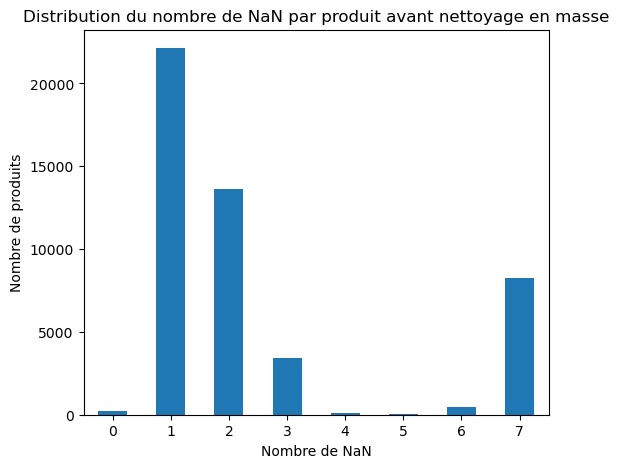

In [18]:
## Variables numériques
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

# Analyse des NaN
nan_par_produit = openfoodfactLight[variables].isnull().sum(axis=1)

print("Statistiques des NaN par produit:")
print(f"Moyenne de NaN par produit: {nan_par_produit.mean():.2f}")
print(f"Maximum de NaN par produit: {nan_par_produit.max()}")
print("\nDistribution du nombre de NaN:")
print(nan_par_produit.value_counts().sort_index())
plt.figure(figsize=(6, 5))
nan_par_produit.value_counts().sort_index().plot(kind='bar')
plt.title('Distribution du nombre de NaN par produit avant nettoyage en masse')
plt.xlabel('Nombre de NaN')
plt.ylabel('Nombre de produits')
plt.xticks(rotation=0)
plt.show()

Distribution asymétrique des NaN :
- Un pic important à 1 NaN (~22000 produits)
- Un second pic à 2 NaN (~13000 produits)
- Un troisième pic à 7 NaN (~8000 produits)

Points clés :
- La majorité des produits ont entre 1 et 2 valeurs manquantes
- Très peu de produits ont 0, 4, 5 ou 6 valeurs manquantes
- Il existe un groupe distinct de produits ayant 7 valeurs manquantes

In [20]:
nan_counts = openfoodfactLight.isna().sum(axis=1)

# Crée un masque pour les produits avec 8 NaN ou moins
mask = nan_counts <= 6

# Application du masque pour ne garder que les produits avec 8 NaN ou moins
openfoodfactLight = openfoodfactLight[mask]

In [21]:
openfoodfactLight.shape

(39615, 14)

In [22]:
# Colonnes de varaibles à analyser
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

print("Analyse des valeurs :")
for col in variables:
   nan_count = openfoodfactLight[col].isna().sum()
   zero_count = (openfoodfactLight[col] == 0).sum()
   total_lignes = len(openfoodfactLight)
   
   print(f"\n{col}:")
   print(f"NaN: {nan_count} ({(nan_count/total_lignes*100):.2f}%)")
   print(f"Zéros: {zero_count} ({(zero_count/total_lignes*100):.2f}%)")
   print(f"Valeurs renseignées: {total_lignes - nan_count - zero_count} ({((total_lignes - nan_count - zero_count)/total_lignes*100):.2f}%)")

Analyse des valeurs :

energy_100g:
NaN: 44 (0.11%)
Zéros: 116 (0.29%)
Valeurs renseignées: 39455 (99.60%)

carbohydrates_100g:
NaN: 2283 (5.76%)
Zéros: 1673 (4.22%)
Valeurs renseignées: 35659 (90.01%)

proteins_100g:
NaN: 174 (0.44%)
Zéros: 2287 (5.77%)
Valeurs renseignées: 37154 (93.79%)

fat_100g:
NaN: 2245 (5.67%)
Zéros: 2939 (7.42%)
Valeurs renseignées: 34431 (86.91%)

fiber_100g:
NaN: 14807 (37.38%)
Zéros: 5119 (12.92%)
Valeurs renseignées: 19689 (49.70%)

sodium_100g:
NaN: 1561 (3.94%)
Zéros: 3292 (8.31%)
Valeurs renseignées: 34762 (87.75%)

trans_fat_100g:
NaN: 39350 (99.33%)
Zéros: 151 (0.38%)
Valeurs renseignées: 114 (0.29%)


In [23]:
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

# Combinaison des NaN et zéros par ligne
zero_per_row = (openfoodfactLight[variables] == 0).sum(axis=1)
nan_per_row = openfoodfactLight[variables].isna().sum(axis=1)

combined_dist = pd.DataFrame({
   'NaN_count': nan_per_row,
   'Zero_count': zero_per_row
}).value_counts().sort_index()

print("Distribution combinée (NaN, Zéros) par ligne:")
print("(NaN_count, Zero_count)")
print(combined_dist)

# Lignes avec beaucoup trop de valeurs manquantes dans les macros (NaN + zéros)
problematic_rows = openfoodfactLight[
   (nan_per_row + zero_per_row) >= 3 
]
print(f"\nNombre de lignes avec 3+ valeurs manquantes: {len(problematic_rows)}")

Distribution combinée (NaN, Zéros) par ligne:
(NaN_count, Zero_count)
NaN_count  Zero_count
0          0                72
           1                90
           2                32
           3                12
           4                12
           5                 5
1          0             16640
           1              3440
           2              1045
           3               498
           4               431
           5                63
           6                22
2          0             11313
           1              1242
           2               541
           3               519
           4                20
           5                12
3          0              1938
           1              1102
           2               237
           3               149
           4                13
4          0               105
           1                11
           2                 3
           3                 2
5          0                46
Name: cou

In [24]:
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

# Calcule le nombre de NaN et zéros par ligne
zero_per_row = (openfoodfactLight[variables] == 0).sum(axis=1)
nan_per_row = openfoodfactLight[variables].isna().sum(axis=1)

# Calcule total des valeurs manquantes
total_missing = nan_per_row + zero_per_row

# Crée le dataset nettoyé avec moins de 3 valeurs manquantes
openfoodfactLight_clean = openfoodfactLight[total_missing > 2]

# Garde les lignes avec 3 ou plus valeurs présentes dans openfoodfactLight
openfoodfactLight = openfoodfactLight[total_missing < 3]

print(f"Nombre de lignes dans dataset nettoyé: {len(openfoodfactLight_clean)}")

Nombre de lignes dans dataset nettoyé: 8028


Statistiques des NaN par produit:
Moyenne de NaN par produit: 1.35
Maximum de NaN par produit: 2

Distribution du nombre de NaN:
0      194
1    20080
2    11313
Name: count, dtype: int64


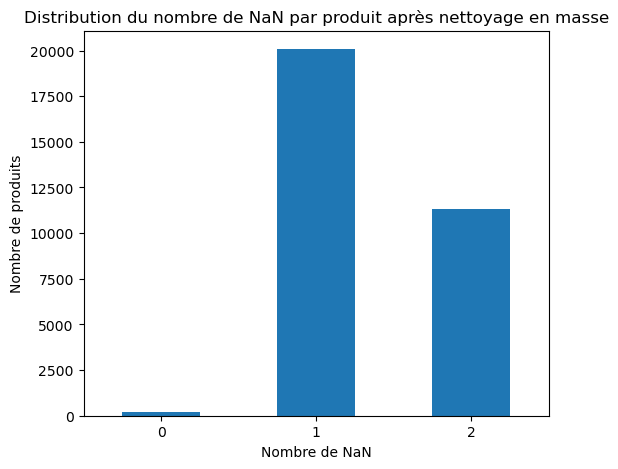

In [25]:
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

# Analyse des NaN
nan_par_produit = openfoodfactLight[variables].isnull().sum(axis=1)

print("Statistiques des NaN par produit:")
print(f"Moyenne de NaN par produit: {nan_par_produit.mean():.2f}")
print(f"Maximum de NaN par produit: {nan_par_produit.max()}")
print("\nDistribution du nombre de NaN:")
print(nan_par_produit.value_counts().sort_index())
plt.figure(figsize=(6, 5))
nan_par_produit.value_counts().sort_index().plot(kind='bar')
plt.title('Distribution du nombre de NaN par produit après nettoyage en masse')
plt.xlabel('Nombre de NaN')
plt.ylabel('Nombre de produits')
plt.xticks(rotation=0)
plt.show()

### Produits avec alphabet non occidental

In [27]:
openfoodfactLight = openfoodfactLight[~openfoodfactLight['code'].isin(['4600300075409', '4600603023848', '4600300075409', '4620006811620','8803560000143','4820026703299'])]#alphabet cyrillique ou autres

In [28]:
openfoodfactLight.shape

(31585, 14)

## Correction des valeurs aberrantes

### nutrition-score-fr_100g

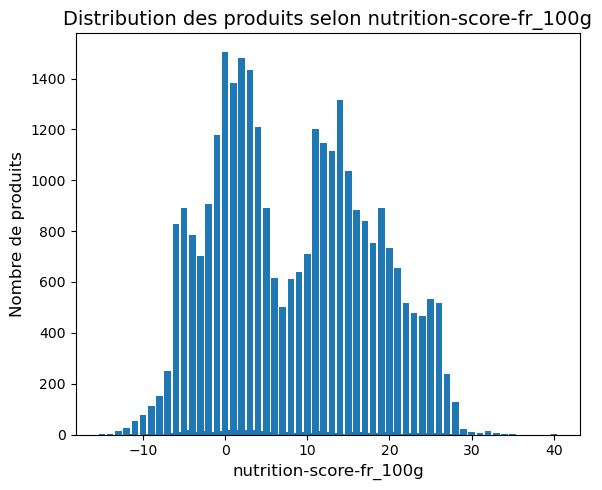

In [31]:
# Distribution des produits selon nutrition-score-fr_100g
plot_product_histogram(openfoodfactLight, 'nutrition-score-fr_100g')

Les valeurs négatives dans nutrition-score-fr_100g sont normales.
Le Nutri-Score utilise un système de points qui peut être négatif, avec :
- Une échelle de -15 à +40
- Les scores négatifs représentent les produits les plus sains
- Plus le score est bas (négatif), meilleure est la qualité nutritionnelle

Système de conversion en lettres (A à E):

- A (vert foncé) : scores ≤ -1
- B (vert clair) : scores de 0 à 2
- C (jaune) : scores de 3 à 10
- D (orange) : scores de 11 à 18
- E (rouge) : scores ≥ 19

Analyse de la distribution du score nutritionnel (nutrition-score-fr_100g) :

- Forme de la distribution :
    - Distribution bimodale (deux pics principaux)
    - Premier pic autour de 0-2 (~1400-1500 produits)
    - Second pic autour de 14-15 (~1300 produits)


- Caractéristiques clés :
    - Score s'étend de -10 à 40
    - Majorité des produits entre -5 et 25
    - Décroissance rapide après 25
    - Très peu de produits au-delà de 30


- Implications :
    - La bimodalité : 2 deux grandes catégories de produits ?
    - Majorité des produits avec un score positif (qualité nutritionnelle moindre)

### energy_100g

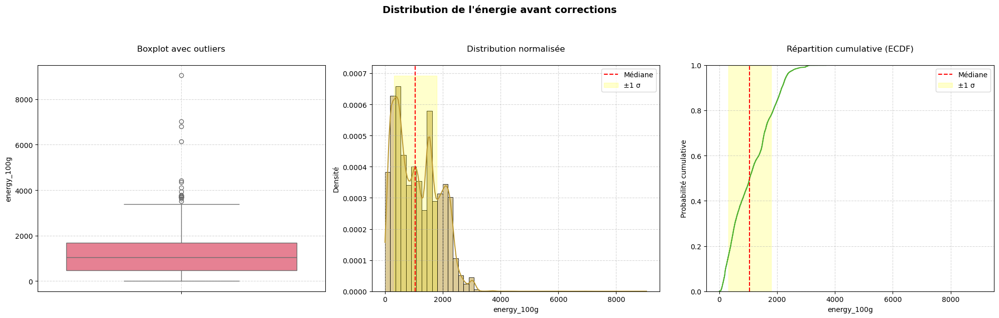

In [34]:
visualiser_macronutriments(openfoodfactLight, 'energy_100g', titre='Distribution de l\'énergie avant corrections')

In [35]:
# Statistiques
calcul_statistiques(openfoodfactLight, 'energy_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
energy_100g,1128.884823,736.932466,1.0,464.0,1049.0,1678.0,9050.0,-1357.0,3499.0,22,0.069653


In [36]:
openfoodfactLight[openfoodfactLight['energy_100g'] >= 1632] # produit le plus calorique Caramel et Noisettes extra gourmand (Milka) : 9770 kJ

,product_key,pnns_groups_1,code,product_name,brands,countries_fr,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g
6,1001 delights_baklava,Sugary snacks,20719074,Baklava,1001 delights,France,20.0,2048.0,55.3,6.9,26.3,0.0,0.200787,NaN
7,1001 delights_chickpeas,Cereals and potatoes,20764296,Chickpeas,1001 delights,France,-5.0,1671.0,54.2,20.1,5.5,25.6,0.043307,NaN
10,1001 delights_potato crisps kebab flavour,Salty snacks,20758073,Potato Crisps Kebab flavour,1001 Delights,France,15.0,2251.0,50.5,6.0,34.0,NaN,0.681102,NaN
11,1001delights_potato crisps sweet spicy,Salty snacks,20758066,Potato crisps sweet & spicy,1001delights,France,14.0,2251.0,50.5,6.0,34.0,NaN,0.551181,NaN
14,123 bio_beurre de cacahuète crunchy,Sugary snacks,3609760400050,Beurre de cacahuète Crunchy,123 Bio,France,16.0,2631.0,9.3,29.0,52.0,5.6,0.393701,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48284,éthiquable_chocolat noir 98 équateur grand cr...,Sugary snacks,3760091725301,Chocolat noir 98 % Équateur grand cru Esmeraldas,Éthiquable,France,NaN,2560.0,12.9,13.9,53.7,14.4,NaN,NaN
48285,éthiquable_haïti grand cru cap haïtien 72 caca...,Sugary snacks,3760091726650,HAïTI Grand cru Cap haïtien 72% cacaoté et fruité,Éthiquable,France,18.0,2397.0,35.4,9.5,42.1,9.7,0.000000,NaN
48289,étoile dorlidl_meule belmontoise,Milk and dairy products,2223650003179,Meule belmontoise,"Étoile d'Or,Lidl",France,14.0,1739.0,1.1,26.9,34.0,NaN,0.389764,NaN
48308,ülkervildiz holding_çikolata,Sugary snacks,8690504022732,Çikolata,"Ülker,Vildiz holding",France,28.0,2371.0,56.1,10.5,33.3,NaN,0.354331,NaN


In [37]:
corrections = {
    '3596710288755': 1674,
    '3291960006127': 3700,
    '20233679':np.NaN
}
openfoodfactLight = corriger_valeurs(openfoodfactLight, 'energy_100g', corrections)

In [38]:
openfoodfactLight[openfoodfactLight['energy_100g'] >= 9770] # produit le plus calorique Caramel et Noisettes extra gourmand (Milka) : 9770 kJ

,product_key,pnns_groups_1,code,product_name,brands,countries_fr,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g


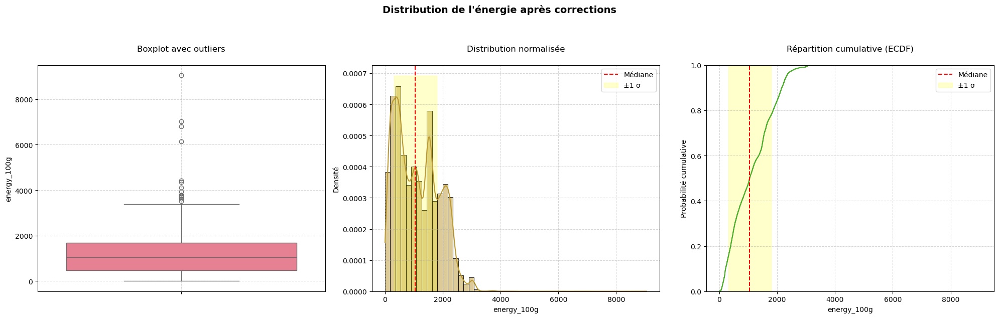

In [39]:
visualiser_macronutriments(openfoodfactLight, 'energy_100g', titre='Distribution de l\'énergie après corrections')

### carbohydrates_100g

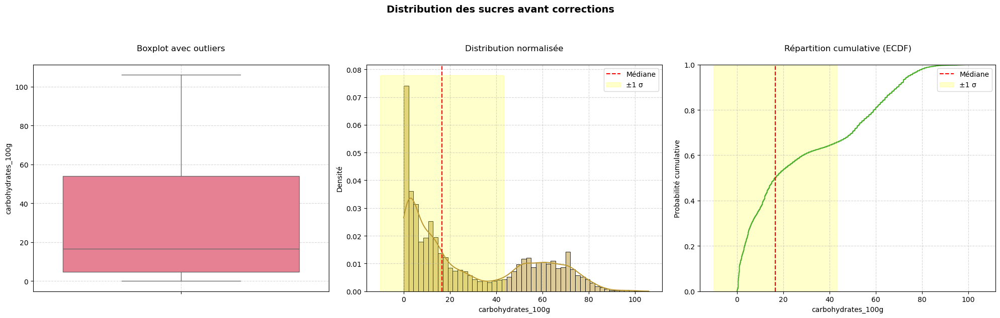

In [41]:
visualiser_macronutriments(openfoodfactLight, 'carbohydrates_100g', titre='Distribution des sucres avant corrections')

In [42]:
# Statistiques
calcul_statistiques(openfoodfactLight, 'carbohydrates_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
carbohydrates_100g,28.728269,26.745239,0.0,4.7,16.5,54.0,106.0,-69.25,127.95,0,0.0


In [43]:
afficher_valeurs_sup_100(openfoodfactLight, 'carbohydrates_100g', 100)

Nombre de produits avec carbohydrates_100g > 100: 1

Exemples de produits avec les valeurs les plus élevées pour carbohydrates_100g:
                code       product_name         brands  carbohydrates_100g
18945  3473710080032  Palets pur beurre  Georges Blanc               106.0


In [44]:
corrections = {
    '3596710288755': 32,  
    '8935000901649': 78.4,
    '3473710080032': 41.10,
    '3560070740338': 76
}
openfoodfactLight = corriger_valeurs(openfoodfactLight, 'carbohydrates_100g', corrections)

In [45]:
# Statistiques
calcul_statistiques(openfoodfactLight, 'carbohydrates_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
carbohydrates_100g,28.726213,26.741794,0.0,4.7,16.5,54.0,100.0,-69.25,127.95,0,0.0


In [46]:
# Affiche des produits au dessus du seuil et Export en CSV
export = afficher_produits_seuil(openfoodfactLight, 'carbohydrates_100g')
export.to_csv('produits_carbohydrates_100g.csv', index=True)

Produits hors Q1-Q3 pour carbohydrates_100g:
Q1 : 4.70
Q3 : 54.00

Produits > Q3:
                code                                       product_name  \
34345  3250391098354                                    Sucre en poudre   
494    8722700029960                                    Sucre Vanilliné   
34346  3250391139460                                  Sucre à confiture   
43968  3410280012285                                    Sucre en poudre   
43951  3410280043678                                  Sucre en morceaux   
...              ...                                                ...   
39976  3250391372522                            Les croûtons saveur ail   
22432       26035291                                   Barre Pâtissière   
33775  7613035367852  Les Recettes de l'Atelier - Chocolat au Lait G...   
35822  8020083000911                         Taglioni au Noir de Seiche   
30747  3502490013944                         Pruneaux d'Agen Dénoyautés   

                 

Les outliers sont principalement composés de produits de sucres (mroceaux, fins, blancs, bruns, sirops, confiseries etc) reconnues pour leur niveau de sucres trop élévé.

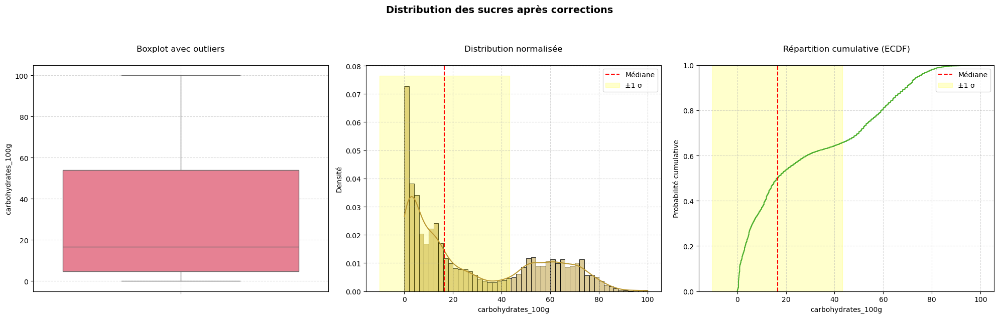

In [48]:
visualiser_macronutriments(openfoodfactLight, 'carbohydrates_100g', titre='Distribution des sucres après corrections')

### proteins_100g

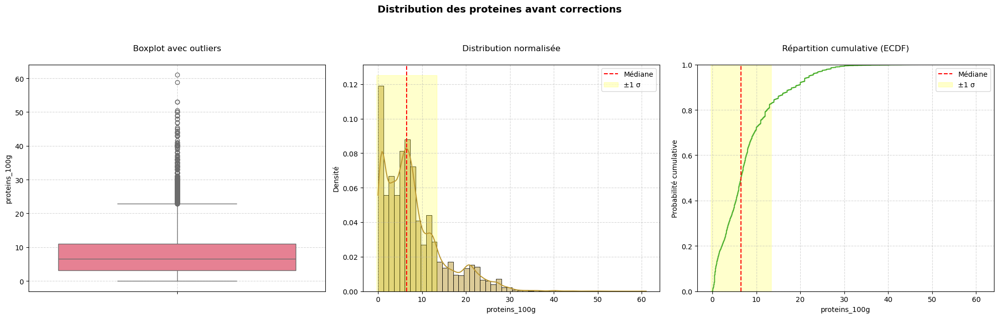

In [50]:
visualiser_macronutriments(openfoodfactLight, 'proteins_100g', titre='Distribution des proteines avant corrections')

In [51]:
calcul_statistiques(openfoodfactLight, 'proteins_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
proteins_100g,8.051483,6.833419,0.0,3.1,6.5,11.0,61.0,-8.75,22.85,1443,4.568624


In [52]:
# Affiche des produits au dessus du seuil et Export en CSV
export = afficher_produits_seuil(openfoodfactLight, 'proteins_100g')
#export.to_csv('produits_proteines_eleves.csv', index=True)

Produits hors Q1-Q3 pour proteins_100g:
Q1 : 3.10
Q3 : 11.00

Produits > Q3:
                code                                       product_name  \
3613   3700531201538                                Sucette au chocolat   
31124  3770004620081      Les Insectes Apéritifs Saveur Méditerranéenne   
20784  8594055300151                                            Chicken   
6145   2000000041639        Bulk Powders Nuts About Whey Chocolat Blanc   
30110  3329487111755                 Protéines de soja petits morceaux    
...              ...                                                ...   
19207  3100080001229                    4 quenelles fraîches de brochet   
25906  3263853197618                        Mini Choux saveur Bleu Noix   
19203  3100080001250  16 quenelles fraiches de brochet - Giraudet - ...   
32935  3760168959998                                     Spaghetti bio    
41287  3165950210651               Filets de Maquereaux (À la Catalane)   

                  bran

In [53]:
codes_a_verifier = ['3770004620081', '3700531201538', '3092718618971', '3564700511930', '26016986']
resultats = openfoodfactLight[openfoodfactLight['code'].isin(codes_a_verifier)][['code', 'product_name','brands', 'proteins_100g']]
print(resultats)

                code                                   product_name  \
3613   3700531201538                            Sucette au chocolat   
21048       26016986                       Fromage à pâte dure râpé   
31124  3770004620081  Les Insectes Apéritifs Saveur Méditerranéenne   

            brands  proteins_100g  
3613    belledonne           61.0  
21048       ITALIA           49.0  
31124  Micronutris           58.8  


In [54]:
corrections = {
    '3700531201538': 6.4,
    '26016986': 32,
    '3770004620081': 58.8,
    '3564700511930': 0,
    '3092718618971': 0
    }
openfoodfactLight = corriger_valeurs(openfoodfactLight, 'proteins_100g', corrections)

In [55]:
max_protein = 51  # g/100g (seuil pour aliments très protéinés hors whey https://www.nu3.fr/blogs/nutrition/aliments-proteines)
openfoodfactLight['proteins_100g'] = openfoodfactLight['proteins_100g'].clip(upper=max_protein)

calcul_statistiques(openfoodfactLight, 'proteins_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
proteins_100g,8.04884,6.821848,0.0,3.1,6.5,11.0,51.0,-8.75,22.85,1442,4.565458


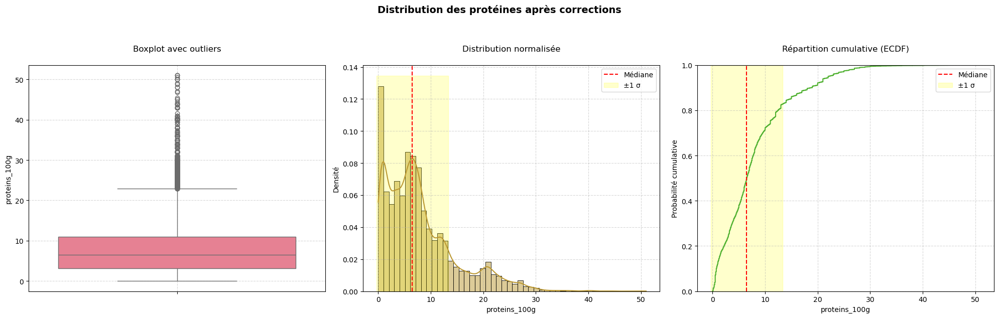

In [56]:
visualiser_macronutriments(openfoodfactLight, 'proteins_100g', titre='Distribution des protéines après corrections')

Les autres outliers sont cohérents (viandes animales, féculents principalement)

### fat_100g

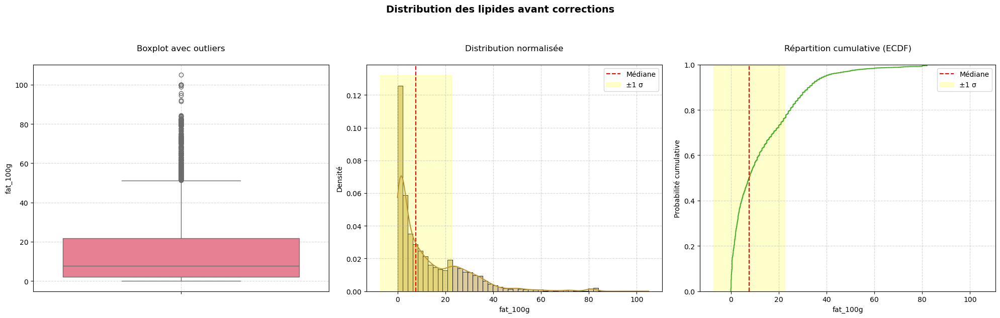

In [59]:
visualiser_macronutriments(openfoodfactLight, 'fat_100g', titre='Distribution des lipides avant corrections')

In [60]:
# Calcul des statistiques
calcul_statistiques(openfoodfactLight, 'fat_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
fat_100g,13.234295,14.897362,0.0,2.0,7.6,21.7,105.0,-27.55,51.25,780,2.469527


In [61]:
afficher_valeurs_sup_100(openfoodfactLight, 'fat_100g', 100)

Nombre de produits avec fat_100g > 100: 1

Exemples de produits avec les valeurs les plus élevées pour fat_100g:
                code              product_name           brands  fat_100g
23510  8032942610032  Graine de couscous moyen  La méditerranéa     105.0


In [62]:
corrections = {
        '3596710288755': 57.8,
        '8032942610032': 1.5
    }
openfoodfactLight = corriger_valeurs(openfoodfactLight, 'fat_100g', corrections)

In [63]:
afficher_valeurs_sup_100(openfoodfactLight, 'fat_100g', 100)

Nombre de produits avec fat_100g > 100: 0

Aucun produit n'a de valeur supérieure à 100 pour fat_100g.


In [64]:
# Calcul des statistiques
calcul_statistiques(openfoodfactLight, 'fat_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
fat_100g,13.231013,14.888543,0.0,2.0,7.6,21.7,100.0,-27.55,51.25,779,2.466361


In [65]:
# Affichage des produits au dessus du seuil et Export en CSV
export = afficher_produits_seuil(openfoodfactLight, 'fat_100g')
#export.to_csv('produits_fat_100g_eleves.csv', index=True)

Produits hors Q1-Q3 pour fat_100g:
Q1 : 2.00
Q3 : 21.70

Produits > Q3:
                code                                       product_name  \
5749   3250391650132                 L'exceptionnelle huile de noisette   
5676   3250390000518                                     Huile de colza   
5678   3250391594245                                      Huile d'olive   
34188  3250391499410         Huile d olive vierge extra origine espagne   
43963  3410280010311                                 Huile de tournesol   
...              ...                                                ...   
27285       24044417                   Biscuits au cacao fourrage lacté   
30199       00789400  Extremely Chocolatey Millionaire's Caramel Cri...   
43581  3292590805128                           10 mini cornets chocolat   
18926       20348557                                       Almond (XXL)   
28557       20002268                                         Mozzarella   

                           

Les outliers sont principalement composés de produits reconnus pour leurs fortes teneurs en ce nutriment (huiles, beurres, graines ...). 
Pas de corrections complémentaires

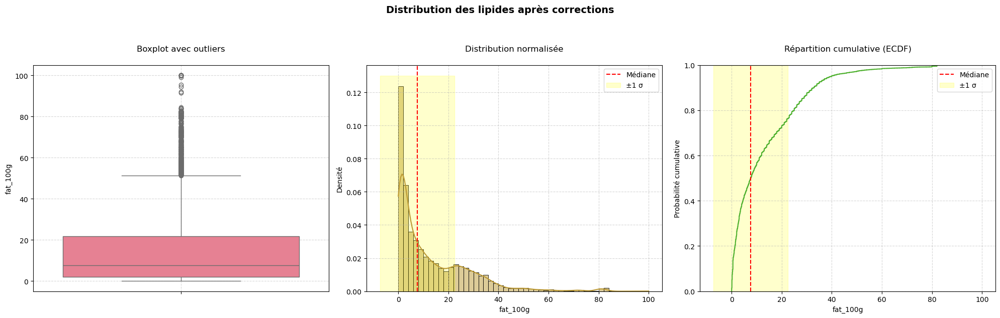

In [67]:
visualiser_macronutriments(openfoodfactLight, 'fat_100g', titre='Distribution des lipides après corrections')

### fiber_100g

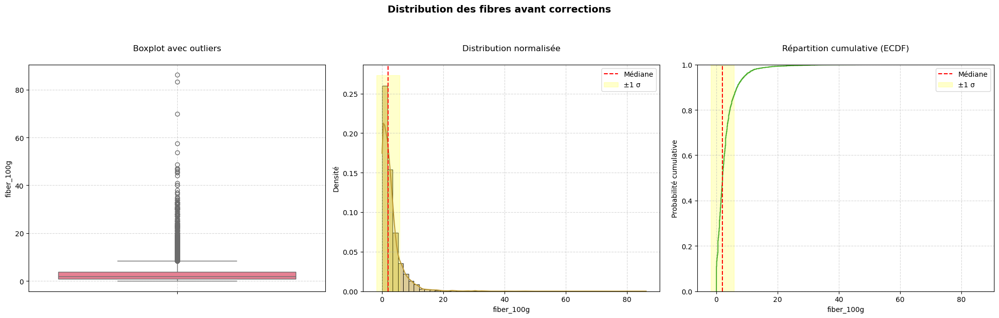

In [69]:
visualiser_macronutriments(openfoodfactLight, 'fiber_100g', titre='Distribution des fibres avant corrections')

In [70]:
# Calcul des statistiques
calcul_statistiques(openfoodfactLight, 'fiber_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
fiber_100g,2.981184,3.793328,0.0,0.8,2.0,3.8,86.2,-3.7,8.3,1320,4.179199


In [71]:
# Affichage des produits au dessus du seuil et Export en CSV
export = afficher_produits_seuil(openfoodfactLight, 'fiber_100g')
#export.to_csv('produits_fiber_100g_eleves.csv', index=True)

Produits hors Q1-Q3 pour fiber_100g:
Q1 : 0.80
Q3 : 3.80

Produits > Q3:
                code                                       product_name  \
22215  3760020501518                                          Agar-agar   
27808  5411788045759                                          Agar-Agar   
45278  3256220666398                      Champignons noirs déshydratés   
35057  3329480010338                                         Son de blé   
18888  3229820189246    Carrés coupe faim minceur Cacao Gayelord Hauser   
...              ...                                                ...   
31041  3328481290008           Les Florentins ® Chocolat lait et orange   
31042  3328481290374  Les Florentins ® Chocolat noir et caramel au b...   
33949  3033710070145                                               Lion   
48111  8852018101017         Oriental Style instant noodles Beef Flavor   
38627  3021690023992                              Cassoulet de Toulouse   

                     brand

Données cohérentes, Agar-agar contient 94% de fibres en général

### sodium_100g

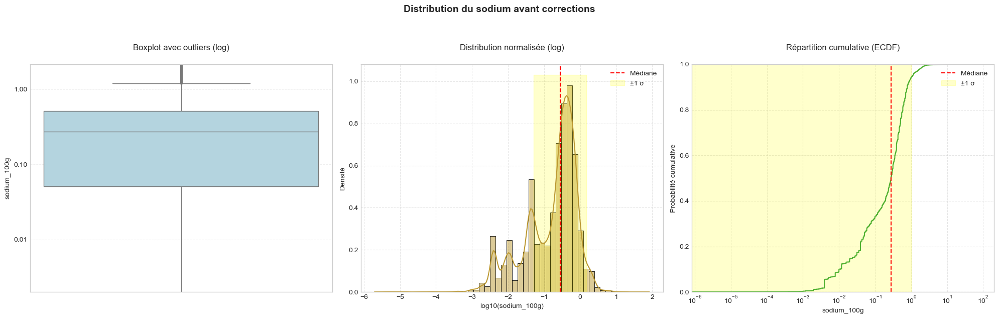

In [74]:
visualiser_micronutriments(openfoodfactLight, 'sodium_100g', titre='Distribution du sodium avant corrections')

In [75]:
# Statistiques
calcul_statistiques(openfoodfactLight, 'sodium_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
sodium_100g,0.370411,0.714107,0.0,0.043307,0.27,0.511811,83.0,-0.659449,1.214567,1195,3.783442


In [76]:
# Affichage des produits au dessus du seuil (mediane) et export en CSV
export = afficher_produits_seuil(openfoodfactLight, 'sodium_100g')
#export.to_csv('produits_sodium_100g_eleves.csv', index=True)

Produits hors Q1-Q3 pour sodium_100g:
Q1 : 0.04
Q3 : 0.51

Produits > Q3:
                code                                       product_name  \
4027   3423720002432                                          Keeny Bio   
36760  3270160741199                                       Poisson pané   
31040  3328481290718  Les Florentins ® Chocolat Lait & Caramel au be...   
29302  8850367990924                                       Coconut Milk   
35616  8002873021641                                          Panettone   
...              ...                                                ...   
38577  8001665127981                          Ravioli Fromages Italiens   
32172  3350033160637         Pizza cuite au feu de bois quatre fromages   
42780  0184210063748                    La Choucroute du temps retrouvé   
14466  3367651000054               Plaisir vrai! Poulet rôti Mayonnaise   
24330  3168930000877                                       Chips Nature   

                         

In [77]:
corrections = {
    '3423720002432': 0.36, '812475012255': 0.03, '3270160741199': 0.29, '609613797286': 0.28, '3328481290718': 0.016,  '8850367990924': 0.015, 
    '8002873021641': 0.014, '8809059293959': 0.014, '3263851123022': 0.0129, '3218370071347': 7, '3218370071446': 7, '3038680046121': 7, 
    '4002359633812': 7.8, '3245412654206': 7.8, '3228020481198': 2, '3661945220075': 7.8, '3033710084913': 0.1, '8934874111253': 7.8,
    '3760072858028': 0.094, '8850206011025': 7.8
    }
openfoodfactLight = corriger_valeurs(openfoodfactLight, 'sodium_100g', corrections)

Les autres outliers sont justes

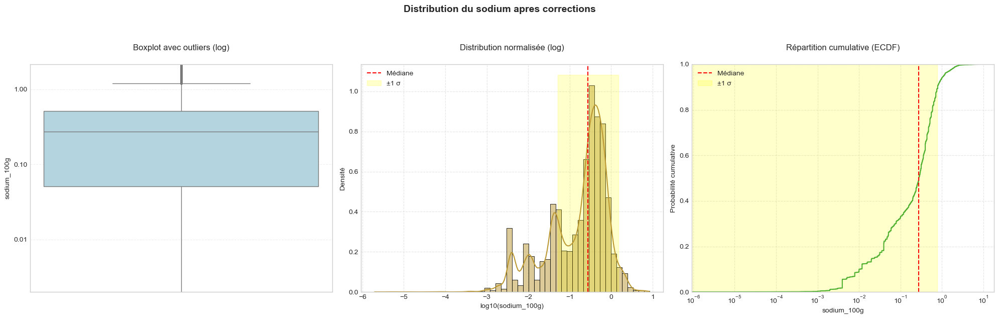

In [79]:
visualiser_micronutriments(openfoodfactLight, 'sodium_100g', titre='Distribution du sodium apres corrections')

### trans-fat_100g

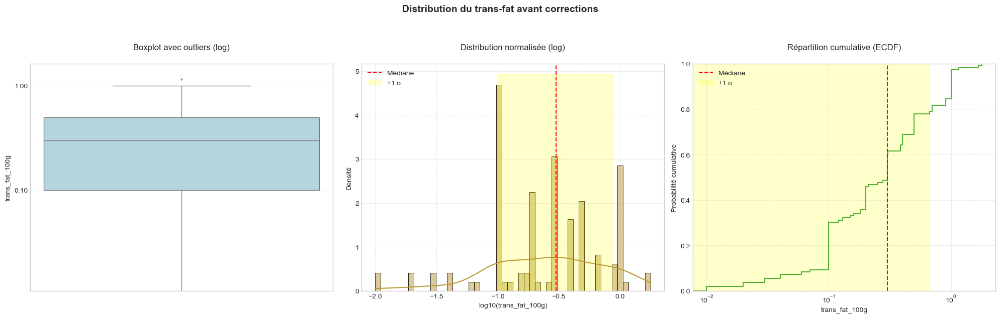

In [81]:
visualiser_micronutriments(openfoodfactLight, 'trans_fat_100g', titre='Distribution du trans-fat avant corrections')

In [82]:
# Statistiques
calcul_statistiques(openfoodfactLight, 'trans_fat_100g')

,Moyenne,Ecart-type,Min,Q1,Médiane,Q3,Max,Seuil bas,Seuil haut,Nb valeurs atypiques,% valeurs atypiques
trans_fat_100g,0.193351,0.325189,0.0,0.0,0.0,0.294,1.78,-0.441,0.735,20,0.063321


In [83]:
# Affichage des produits au dessus du seuil (mediane) et export en CSV
export = afficher_produits_seuil(openfoodfactLight, 'trans_fat_100g')
export.to_csv('produits_trans_fat_100g_eleves.csv', index=True)

Produits hors Q1-Q3 pour trans_fat_100g:
Q1 : 0.00
Q3 : 0.29

Produits > Q3:
                code                                       product_name  \
23316  3760019718163                Gnocchi Farcis à la Crème de Truffe   
5619   0079813000118   Boursin Ail & Fines Herbes / Garlic & Fine Herbs   
28465  0019320015441                                 Shortbread Cookies   
1260   3178050000084                                              Astra   
37095  8711200546145   Tendre mousse (39% MG) Doux - 320 g - Planta Fin   
18644  0171870026855             Fruit d'Or pro-activ (35 % MG) Tartine   
18672  8711200541232  Fruit d'Or Oméga 3&6 doux (60 % MG) Tartine et...   
22148  7610216098000                       Flûtes Croustillantes Sésame   
28355  3254560044050             Tournesol 60% MG (Tartine et Cuisson)    
18670  8711200541171  Fruit d'Or Omega 3&6 demi-sel (60% MG) Tartine...   
18645  3178050027760   Fruit d'Or pro-activ (60 % MG) Cuisson & Tartine   
39164  4000417242006   

Les données bien que paraissant atypique seraient cohérentes 

## Controle des corrections des valeurs abérrantes après traitement

In [86]:
openfoodfactLight.describe()

,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g
count,30938.000000,31580.000000,31571.000000,31561.000000,31535.000000,20475.000000,31448.000000,222.000000
mean,8.338678,1128.884823,28.726213,8.048840,13.231013,2.981184,0.364150,0.193351
std,9.368674,736.932466,26.741794,6.821848,14.888543,3.793328,0.479017,0.325189
min,-15.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,464.000000,4.700000,3.100000,2.000000,0.800000,0.043307,0.000000
50%,8.000000,1049.000000,16.500000,6.500000,7.600000,2.000000,0.270000,0.000000
75%,16.000000,1678.000000,54.000000,11.000000,21.700000,3.800000,0.511811,0.294000
max,40.000000,9050.000000,100.000000,51.000000,100.000000,86.200000,8.346457,1.780000


# Identification et traitement des valeurs manquantes

## Fonctions utiles pour les analyses, les diagnostics et les traitements

In [89]:
# Fonction Analyse exploratoire et distribution
def analyze_exploratoire_distribution(df, variable):
    # Stats de base
    stats = pd.DataFrame({
        'Données manquantes': df[variable].isnull().sum(),
        'Données manquantes(%)': (df[variable].isnull().sum() / len(df)) * 100
    }, index=[0])
    
    return stats

# Analyse exploratoire et distribution
# def analyze_exploratoire_distribution(df, variable)

## Correction des NaN - approche métier

<Figure size 1500x800 with 0 Axes>

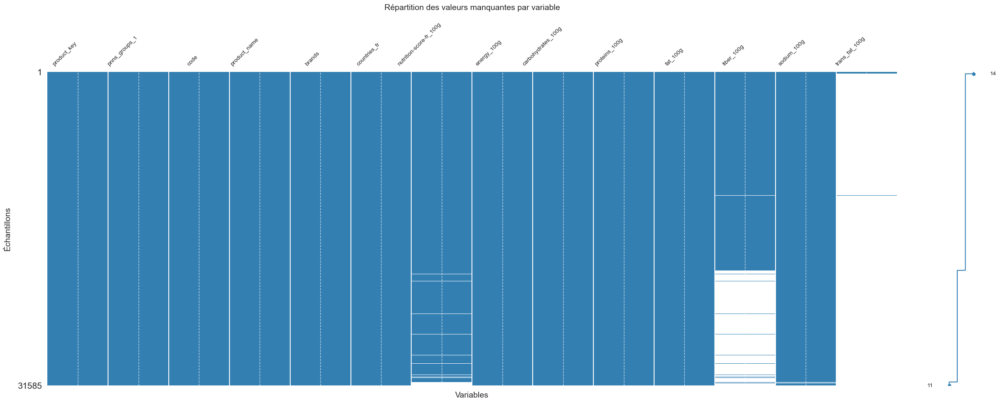

In [91]:
sns.set_theme()

sns.set_palette("deep")

plt.figure(figsize=(15, 8))

# Personnalisation
msno.matrix(openfoodfactLight,
            color=(0.2, 0.5, 0.7),     # Bleu
            sparkline=True,
            sort='descending',         # Tri descendant pour mettre en évidence les variables avec le plus de NaN
            width_ratios=(15, 1),
            fontsize=12,
            freq=None)                 # Supprime la barre de fréquence


plt.title("Répartition des valeurs manquantes par variable", fontsize=14, pad=20)
plt.xlabel("Variables", fontsize=14, labelpad=10)
plt.ylabel("Échantillons", fontsize=14, labelpad=10)

# Ajuste les étiquettes de l'axe x
plt.xticks(rotation=45, ha='right', fontsize=10)

# Ajoute une grille
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Ajuste l'espacement
plt.subplots_adjust(left=0.05, right=0.95, top=0.9, bottom=0.15)
plt.show()
plt.close()

In [92]:
# Comptage des NaN par variable
nan_count = openfoodfactLight.isna().sum()
nan_percent = (openfoodfactLight.isna().sum() / len(openfoodfactLight)) * 100

nan_df = pd.DataFrame({
   'NaN en point': nan_count,
   'NaN en %': nan_percent
}).sort_values('NaN en point', ascending=False)

# Filtre pour n'afficher que les variables avec NaN
nan_df = nan_df[nan_df['NaN en point'] > 0]
print(nan_df)

                         NaN en point   NaN en %
trans_fat_100g                  31363  99.297135
fiber_100g                      11110  35.174925
nutrition-score-fr_100g           647   2.048441
sodium_100g                       137   0.433750
fat_100g                           50   0.158303
proteins_100g                      24   0.075985
carbohydrates_100g                 14   0.044325
energy_100g                         5   0.015830


### Fonctions utiles

In [94]:
#Graphiques pour visualiser la distribution macronutriments
def visualiser_macronutriments(df, colonne, echelle='linear', bins=50, palette='husl', titre=None):
    
    if df[colonne].empty:
        print(f"Aucune donnée valide pour {colonne}.")
        return

    stats = df[colonne].describe()
    mediane = stats['50%']
    std = stats['std']

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6))

    # Boxplot
    sns.boxplot(y=df[colonne], ax=ax1, color=sns.color_palette(palette)[0], showfliers=True)
    ax1.set_title('Boxplot avec outliers', pad=20)
    ax1.grid(True, linestyle='--', alpha=0.5)

    # Histogramme avec KDE normalisé
    sns.histplot(data=df[colonne], bins=bins, ax=ax2, kde=True, stat='density', color=sns.color_palette(palette)[1])
    ax2.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax2.fill_between([mediane-std, mediane+std], 0, ax2.get_ylim()[1], color='yellow', alpha=0.2, label='±1 σ')
    ax2.set_title('Distribution normalisée', pad=20)
    ax2.set_ylabel('Densité')
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.5)

    # Courbe de répartition cumulative (ECDF) avec écart type
    sns.ecdfplot(df[colonne], ax=ax3, color=sns.color_palette(palette)[2])
    ax3.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax3.fill_betweenx([0, 1], mediane-std, mediane+std, color='yellow', alpha=0.2, label='±1 σ')
    ax3.set_title('Répartition cumulative (ECDF)', pad=20)
    ax3.set_xlabel(colonne)
    ax3.set_ylabel('Probabilité cumulative')
    ax3.legend()
    ax3.grid(True, linestyle='--', alpha=0.5)

    for ax in [ax1, ax2, ax3]:
        ax.set_yscale(echelle)

    fig.suptitle(titre or f'Analyse de {colonne}', y=1.05, fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Utilisation :
#visualiser_macronutriments(openfoodfactLight, 'proteins_100g', titre='Distribution des protéines')

In [95]:
#Graphiques pour visualiser la distribution macronutriments  apres corrections des NaN
def visualiser_macronutriments_nan_corriges(df, colonne, echelle='linear', bins=50, palette='husl', titre=None):
    
    if df[colonne].empty:
        print(f"Aucune donnée valide pour {colonne}.")
        return

    stats = df[colonne].describe()
    mediane = stats['50%']
    std = stats['std']

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6))

    # Boxplot
    sns.boxplot(y=df[colonne], ax=ax1, color=sns.color_palette(palette)[0], showfliers=True)
    ax1.set_title('Boxplot avec outliers', pad=20)
    ax1.grid(True, linestyle='--', alpha=0.5)

    # Histogramme avec KDE normalisé
    sns.histplot(data=df[colonne], bins=bins, ax=ax2, kde=True, stat='density', color=sns.color_palette(palette)[1])
    ax2.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax2.fill_between([mediane-std, mediane+std], 0, ax2.get_ylim()[1], color='yellow', alpha=0.2, label='±1 σ')
    ax2.set_title('Distribution normalisée', pad=20)
    ax2.set_ylabel('Densité')
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.5)

    # Courbe de répartition cumulative (ECDF) avec écart type
    sns.ecdfplot(df[colonne], ax=ax3, color=sns.color_palette(palette)[2])
    ax3.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax3.fill_betweenx([0, 1], mediane-std, mediane+std, color='yellow', alpha=0.2, label='±1 σ')
    ax3.set_title('Répartition cumulative (ECDF)', pad=20)
    ax3.set_xlabel(colonne)
    ax3.set_ylabel('Probabilité cumulative')
    ax3.legend()
    ax3.grid(True, linestyle='--', alpha=0.5)

    for ax in [ax1, ax2, ax3]:
        ax.set_yscale(echelle)

    fig.suptitle(titre or f'Analyse de {colonne}', y=1.05, fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Utilisation :
# visualiser_macronutriments_nan_corriges(openfoodfactLight, 'proteins_100g', titre='Distribution des protéines')

In [96]:
#Graphiques pour visualiser la distribution micronutriments échelle logarithmique avant corrections des NaN
def visualiser_micronutriments(df, colonne, bins=50, palette='husl', titre=None):
    plt.style.use("seaborn-v0_8-whitegrid")
    
    # Préparation des données
    df = df.copy()
    df = df[df[colonne].notna()]  # Suppression des valeurs NaN
    df = df[df[colonne] > 0]      # Évite les erreurs log
    
    if df[colonne].empty:
        print(f"Aucune donnée valide pour {colonne}.")
        return
        
    # Calcul des statistiques
    stats = df[colonne].describe()
    mediane = stats['50%']
    std = stats['std']
    
    # Log transformation des données pour normalisation
    log_data = np.log10(df[colonne])
    log_mediane = np.log10(mediane)
    log_std = log_data.std()
    
    # Création de la figure
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6))
    
    # 1. Boxplot avec échelle log
    sns.boxplot(y=df[colonne], ax=ax1,
                color='lightblue',
                showfliers=True,
                fliersize=2,
                width=0.5)
    
    ax1.semilogy()
    ax1.set_ylim(bottom=df[colonne].quantile(0.01), top=df[colonne].quantile(0.99))
    ax1.yaxis.set_major_formatter(ticker.ScalarFormatter())
    ax1.set_title('Boxplot avec outliers (log)', pad=20)
    ax1.grid(True, linestyle='--', alpha=0.3)

    # 2. Histogramme normalisé avec KDE
    sns.histplot(
        data=log_data,
        bins=bins,
        ax=ax2,
        kde=True,
        stat='density',
        color=sns.color_palette(palette)[1]
    )
    ax2.axvline(x=log_mediane, color='red', linestyle='--', label='Médiane')
    ax2.fill_between(
        [log_mediane-log_std, log_mediane+log_std],
        0,
        ax2.get_ylim()[1],
        color='yellow',
        alpha=0.2,
        label='±1 σ'
    )
    ax2.set_title('Distribution normalisée (log)', pad=20)
    ax2.set_xlabel(f'log10({colonne})')
    ax2.set_ylabel('Densité')
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.5)
    
    # 3. ECDF avec échelle log
    sns.ecdfplot(df[colonne], ax=ax3, color=sns.color_palette(palette)[2])
    ax3.set_xscale('log')
    ax3.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax3.fill_betweenx([0, 1], mediane-std, mediane+std, color='yellow', alpha=0.2, label='±1 σ')
    ax3.set_title('Répartition cumulative (ECDF)', pad=20)
    ax3.set_xlabel(colonne)
    ax3.set_ylabel('Probabilité cumulative')
    ax3.legend()
    ax3.grid(True, linestyle='--', alpha=0.5)

    fig.suptitle(titre or f'Analyse de {colonne}', y=1.05, fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()
    
# Utilisation
#visualiser_micronutriments(openfoodfactLight, 'sodium_100g', titre='Distribution du calcium')

In [97]:
#Graphiques pour visualiser la distribution micronutriments échelle logarithmique apres corrections des NaN
def visualiser_micronutriments_nan_corriges(df, colonne, bins=50, palette='husl', titre=None):
    plt.style.use("seaborn-v0_8-whitegrid")
    
    # Préparation des données
    df = df.copy()
    df = df[df[colonne] > 0]      # Évite les erreurs log
    
    if df[colonne].empty:
        print(f"Aucune donnée valide pour {colonne}.")
        return
        
    # Calcul des statistiques
    stats = df[colonne].describe()
    mediane = stats['50%']
    std = stats['std']
    
    # Définition des limites pour l'axe y
    y_min = df[colonne].quantile(0.01)
    y_max = df[colonne].quantile(0.99)
    
    # Création de la figure
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 6))
    
    # Boxplot avec échelle log en y
    sns.boxplot(y=df[colonne], ax=ax1,
                color='lightblue',
                showfliers=True,
                fliersize=2,
                width=0.5)
    
    ax1.semilogy()  # échelle log uniquement sur y
    ax1.set_ylim(bottom=y_min, top=y_max)
    ax1.yaxis.set_major_formatter(ticker.ScalarFormatter())
    ax1.set_title('Boxplot avec outliers (log)', pad=20)
    ax1.grid(True, linestyle='--', alpha=0.3)

    # Histogramme avec KDE normalisé et log
    sns.histplot(
        data=np.log10(df[colonne]),  # log des données
        bins=bins, 
        ax=ax2, 
        kde=True,
        stat='density',  # normalisation
        color=sns.color_palette(palette)[1]
    )
    ax2.axvline(x=np.log10(mediane), color='red', linestyle='--', label='Médiane')
    ax2.fill_between(
        [np.log10(mediane-std), np.log10(mediane+std)],
        0, 
        ax2.get_ylim()[1],
        color='yellow',
        alpha=0.2,
        label='±1 σ'
    )
    ax2.set_title('Distribution normalisée (log)', pad=20)
    ax2.set_xlabel(f'log10({colonne})')
    ax2.set_ylabel('Densité')
    ax2.legend()
    ax2.grid(True, linestyle='--', alpha=0.5)
    
    # ECDF avec échelle log
    sns.ecdfplot(df[colonne], ax=ax3, color=sns.color_palette(palette)[2])
    ax3.set_xscale('log')  # échelle log en x
    ax3.axvline(x=mediane, color='red', linestyle='--', label='Médiane')
    ax3.fill_betweenx([0, 1], mediane-std, mediane+std, color='yellow', alpha=0.2, label='±1 σ')
    ax3.set_title('Répartition cumulative (ECDF)', pad=20)
    ax3.set_xlabel(colonne)
    ax3.set_ylabel('Probabilité cumulative')
    ax3.legend()
    ax3.grid(True, linestyle='--', alpha=0.5)

    fig.suptitle(titre or f'Analyse de {colonne}', y=1.05, fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()
# Utilisation :
# visualiser_micronutriments_nan_corriges(openfoodfactLight, 'iron_100g', titre='Distribution du fer')

### energy_100g

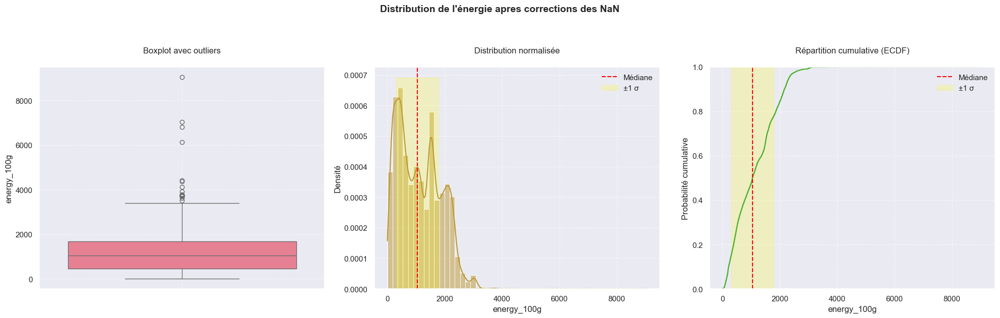

In [99]:
# Vérification avant correction 
visualiser_macronutriments(openfoodfactLight, 'energy_100g', titre='Distribution de l\'énergie apres corrections des NaN')

In [100]:
analyze_exploratoire_distribution(openfoodfactLight, 'energy_100g')

,Données manquantes,Données manquantes(%)
0,5,0.01583


In [101]:
# Affiche les lignes avec NaN pour une variable
nan_rows = openfoodfactLight[openfoodfactLight['energy_100g'].isna()]
display(nan_rows)

,product_key,pnns_groups_1,code,product_name,brands,countries_fr,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g
8137,carrefour_mon brownie moelleux aux noix de péc...,Sugary snacks,3560070891535,Mon Brownie moelleux aux noix de pécan caramél...,Carrefour,France,NaN,NaN,46.0,5.8,28.00,2.70,0.122000,NaN
16072,eco_mayonnaise à la moutarde de dijon,Fat and sauces,3450970007009,Mayonnaise à la moutarde de Dijon,Eco+,France,NaN,NaN,2.2,1.0,72.00,0.10,0.590551,NaN
37575,priméales_poireaux,Fruits and vegetables,3663362003316,Poireaux,Priméales,France,NaN,NaN,12.4,1.5,0.30,1.80,0.019685,NaN
39703,sabarot_mogette de vendée sabarot,Fruits and vegetables,3111950227304,Mogette de Vendée Sabarot,Sabarot,France,NaN,NaN,41.0,21.0,1.25,18.00,0.004930,NaN
39783,sagy_ylanté,Beverages,2000000035266,Ylanté,Sagy,France,NaN,NaN,0.5,0.5,0.01,0.01,0.003937,NaN


In [102]:
energy_nan = openfoodfactLight[openfoodfactLight['energy_100g'].isna()][['code', 'product_name','brands', 'energy_100g']]
#energy_nan.to_csv('energy_nan.csv', index=False)

In [103]:
#Correction en masse (recherche internet)
corrections_en_masse = {
    '3770004125005': 0,'3068320110042': 0,'3560070247592': 0,'3560070891535': 400,'3222472781844': 270,'3033490003951': 150,'3450970007009': 680,
    '3068320111919': 0,'3390390003475': 650,'3263851286017': 250,'8850987123641': 450,'3111950227304': 150,'3023260001263': 364,'3273220154083': 50,
    '3760096290101': 900,'2000000009453': 0,'3398289765671': 250,'3017760555494': 500,'26008059': 720,'5202659381058': 550,'3582740001105': 40,
    '3250391214273': 350,'20233679': 500,'3770000906288': 280,'5410471906391': 500,'8032697890222': 400,'3263859847616': 150,'8713600281169': 380,
    '3308960040157': 350,'5201119003547': 30,'3573091013107': 60,'3663362003316': 30,'2000000035266': 250,'3165950214543': 200,'3331720000344': 45,
    '5055953900292': 1,'94185454': 60,'6932760600159': 100,
    }

for code, nouvelle_valeur in corrections_en_masse.items():
    openfoodfactLight.loc[openfoodfactLight['code'] == code, 'energy_100g'] = nouvelle_valeur

In [104]:
analyze_exploratoire_distribution(openfoodfactLight, 'energy_100g')

,Données manquantes,Données manquantes(%)
0,0,0.0


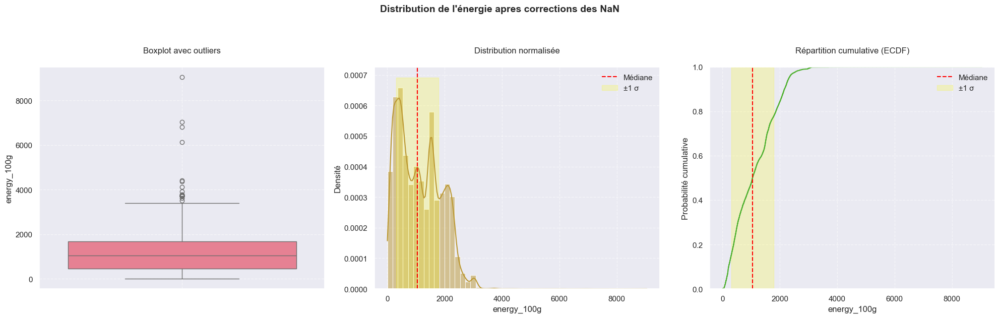

In [105]:
# Vérification après correction
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'energy_100g', titre='Distribution de l\'énergie apres corrections des NaN')

### proteins_100g

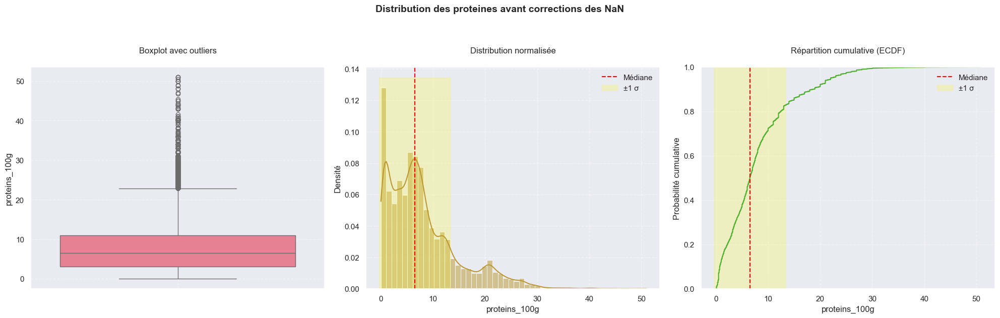

In [107]:
visualiser_macronutriments(openfoodfactLight, 'proteins_100g', titre='Distribution des proteines avant corrections des NaN')

In [108]:
# Affiche les lignes avec NaN pour une variable
nan_rows = openfoodfactLight[openfoodfactLight['proteins_100g'].isna()]
display(nan_rows)

,product_key,pnns_groups_1,code,product_name,brands,countries_fr,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g
168,agir carrefourcarrefour_biscuit croustillants ...,Sugary snacks,3245413922403,Biscuit croustillants sésame,"Agir Carrefour,Carrefour",France,NaN,2037.0,56.40,NaN,22.60,5.60,0.300000,NaN
1155,aro_jus dananas,Beverages,3439495410051,Jus d'ananas,Aro,France,NaN,191.0,10.60,NaN,0.50,0.50,0.011811,NaN
4361,bionade_bionade aux plantes,Beverages,4014472021001,Bionade aux plantes,Bionade,France,NaN,95.0,5.00,NaN,0.10,0.50,0.039370,NaN
6091,brossard_savane recette à base de 16 de ayourt,Sugary snacks,3660140823456,Savane recette à base de 16% de ayourt,Brossard,France,NaN,1812.0,52.00,NaN,22.00,6.20,0.204724,NaN
6467,cantadoucantadou professionnelbel_cantadou pro...,Milk and dairy products,3073780847162,Cantadou Professionnel Nature,"Cantadou,Cantadou Professionnel,Bel",France,NaN,1365.0,2.50,NaN,32.50,7.00,0.346457,NaN
8576,carrefour_rôti de bœuf 4 tranches,Fish Meat Eggs,3560071011055,Rôti de bœuf (4 tranches),Carrefour,France,NaN,496.0,1.30,NaN,2.70,22.00,0.787402,NaN
9218,carrefoursélection carrefour_saumon atlantique...,Fish Meat Eggs,3245414079069,Saumon Atlantique fumé élevé dans les lochs d'...,"Carrefour,Sélection Carrefour",France,NaN,818.0,0.90,NaN,11.00,24.00,0.866142,NaN
9904,casino_galettes suédoises aux flocons davoine,Sugary snacks,3222473590308,Galettes suédoises aux flocons d'avoine,Casino,France,NaN,2063.0,64.00,NaN,24.00,2.90,0.300000,NaN
12096,conserverie la belleiloise_sardines à lhuile d...,Fish Meat Eggs,3660088116719,Sardines à l'huile d'olive et au citron,Conserverie La belle-iloise,France,NaN,1406.0,0.30,NaN,29.60,17.60,0.236220,NaN
15489,dole_sunny fruit,Fruits and vegetables,0038900719609,Sunny fruit,Dole,France,NaN,256.0,14.00,NaN,0.10,0.60,0.039370,NaN


In [109]:
# Affiche les lignes avec NaN pour une variable
nan_rows = openfoodfactLight[openfoodfactLight['proteins_100g'].isna()]

# Extraction des marques uniques
marques_uniques = nan_rows['brands'].unique().tolist()

# Affichage du nombre de marques uniques
print(f"Nombre de marques uniques : {len(marques_uniques)}")

print(marques_uniques)

Nombre de marques uniques : 23
['Agir Carrefour,Carrefour', 'Aro', 'Bionade', 'Brossard', 'Cantadou,Cantadou Professionnel,Bel', 'Carrefour', 'Carrefour,Sélection Carrefour', 'Casino', 'Conserverie La belle-iloise', 'Dole', 'Isigny Ste Mère', 'La crêpe de Brocéliande', 'La Gastronomia di Angelo,Treo', 'Labeyrie', 'Leader price', 'Leader Price', 'Maayane', 'Maître Coq', 'Monique Ranou', 'monoprix', 'RANA', 'Savoie Yaourt', 'U']


In [110]:
# Liste des marques d'eau
marques_eau = ['Volvic', 'Badoit', 'Évian', 'Saint Amand', 'Perrier', 'Plancoët', 'Mont Roucous', 'Volcania', 'Mont Dore', 
               'Aquarel', 'Valécrin', 'Contrex', 'Font Vella', 'Vittel', 'Vals','7 up,Seven-Up','Fresh Tea,Marque Repère',
               'Teisseire', 'Ricqles', 'Schweppes', 'Oasis', 'Juvamine', 'Melfor', 'Eyguebelle', 'Dark Dog', 'Arcens', 
               'Moulin de Valdonne', '7up', 'Pepsico', 'Lipton', 'Granini', 'Fresh Tea', 'Pause Fraîcheur','Bionade', 
               'Seven-Up', 'Monster', 'Aquarius', 'Chaudfontaine', 'Minute Maid', 'Powerade', 'Fanta', 'Coca Cola',
               'De Nigris','Lesieur','Emile Noël','Soléou'          
              ]

# Conversion des noms de marques en minuscules pour une comparaison insensible à la casse
marques_eau_lower = [marque.lower() for marque in marques_eau]

# Fonction pour vérifier si une marque correspond à une marque d'eau
def est_marque_eau(marque):
    return any(eau in str(marque).lower() for eau in marques_eau_lower)

# Application de la modification
mask = openfoodfactLight['brands'].apply(est_marque_eau) & openfoodfactLight['proteins_100g'].isna()
openfoodfactLight.loc[mask, 'proteins_100g'] = 0

print("Modification effectuée. Nombre de lignes modifiées :", sum(mask))

Modification effectuée. Nombre de lignes modifiées : 1


In [111]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'proteins_100g')

,Données manquantes,Données manquantes(%)
0,23,0.072819


In [112]:
proteins_nan = openfoodfactLight[openfoodfactLight['proteins_100g'].isna()][['code', 'product_name','brands', 'proteins_100g']]
proteins_nan.to_csv('proteins_nan.csv', index=False)

In [113]:
#Correction en masse (recherche internet)
corrections_en_masse = {
    '3245414079069':21.8,'3394270004316':21.8,'2283701010303':22.2,'3257981030770':2,'3257984410821':2,'3661945220013':2,'5201119003547':2,
    '3344094444447':2,'3560070829200':2,'3257981685611':2,'2000000022077':2,'3270190025542':4,'8480017027290':4,'3277393400015':4,
    '3273227582995':4,'3438860001887':4,'3560070746019':4,'3558463800028':4,'8000920400289':4,'3350031607233':4,'0328110051287':4,
    '3660140823456':4,'3456580000065':4,'3073780847162':7,'3263853106719':7,'7622300689124':7,'2000000035842':7,'3256225732166':7,
    '3336971605010':7,'3168930007142':8,'3245414254749':8,'8480017393029':8,'3326127000226':8,'3254560023093':8,'3250391121823':8,
    '8410076472779':8,'20116712':8,'5410613737159':8,'3760019718163':9,'3344290200007':9,'3245413922403':9,'8004365101060':9,'00819039':9,
    '3250391697205':9,'3368953036246':9,'2000000109879':9,'2000000117157':9,'3245414072657':10,'3222473590308':10,'3302746459027':12,
    '3263852553224':12,'3596710010660':12,'00819282':12,'0090131':12,'3250390017394':12,'7612100054826':12,'8001665128513':12,
    '20012168':12,'3263850513510':12,'3284570001354':13,'00481724':13,'2000000035803':15,'3222474657925':15,'3394270004477':20,
    '8480017017154':22,'5601010114036':25,'3660088116719':25,'3033610084556':25,'3263851286017':25,'3263859442415':25,'3700029203433':25,
    '0215448046705':25,'5053947099540':25,'3560071011055':29,'2441886023161':35,'3245413922403': 10,'3583788386674': 0,'3583788390800': 0,
    '3583788390732': 0,'3770004125005': 0,'3439495410051': 0.5,'3596710324453': 0.5,'26001463': 0,'3438860001887': 5,'3284570001354': 8,
    '3660140823456': 5,'3168930007142': 6,'3073780847162': 7,'3560070967230': 0.5,'3560070746019': 4,'3245414254749': 6,'3245412961953': 0.5,
    '3270190007074': 0.5,'3270190025542': 2,'3560070900046': 0.5,'3245412730917': 0.5,'3270190005261': 0.7,'3560070912735': 0.5,'3560071011055': 22,
    '3560070747863': 15,'3560070386659': 0.5,'3245414072657': 10,'3245414079069': 20,'8032665850586': 0.7,'3222473590308': 10,'3222474701307': 0.5,
    '3222472949275': 0,'8711900013213': 0,'3558463800028': 3,'5601010114036': 20,'20012168': 12,'3660088116719': 20,'3257981030770': 1,
    '3257981685611': 2,'3257981666603': 0.5,'3257984410821': 1,'3257980030573': 0,'3394270004477': 18,'3394270004316': 20,'8480017021083': 0,
    '8480017027290': 3,'8480017393029': 6,'8480017017154': 20,'0038900719609': 0.5,'2000000022077': 2,'3302746459027': 15,'8809059291993': 0,
    '3254550020262': 0.5,'3326127000226': 8,'3760019718163': 7,'3033610084556': 20,'3366321053864': 0.5,'3023430535505': 0.5,'8004365101060': 8,
    '3263855093581': 0,'3263853106719': 5,'3263852553224': 10,'3263850513510': 12,'3263850029912': 0,'3263851286017': 20,'3263859442415': 29,
    '3254560023093': 7,'3596710010660': 10,'7622300689124': 6,'3330720213013': 0.5,'3700029203433': 20,'2441886023161': 33,'00819282': 10,
    '00481724': 15,'0090131': 12,'2000000035803': 18,'819039': 8,'8000920400289': 3,'3250390017394': 12,'3350033006461': 0.5,
    '3350031607233': 3,'3257982272018': 0.5,'3250391121823': 7,'3250391697205': 8,'8410076472779': 6,'3661945220013': 1,'7612100054826': 10,
    '5201119003547': 1,'3344094444447': 1,'3560070823673': 0.7,'3760074473533': 1,'2283701010303': 22,'8001665128513': 10,'3560070829200': 0.5,
    '8001505004465': 0.5,'2000000035842': 6,'5201136117456': 0.5,'3277393400015': 3.5,'3273227582995': 3,'20116712': 7,'3366321051525': 0,
    '3456580000065': 5,'5053947099540': 22,'8852646023408': 0.5,'8853662023236': 0.5,'3368953036246': 8,'3256225732166': 12,'2000000109879': 8,
    '2000000117157': 8,'5410613737159': 7,'3501271217052': 0,'3336971605010': 6,'3344290200007': 8,'3222474657925': 15,
    }

for code, nouvelle_valeur in corrections_en_masse.items():
    openfoodfactLight.loc[openfoodfactLight['code'] == code, 'proteins_100g'] = nouvelle_valeur

In [114]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'proteins_100g')

,Données manquantes,Données manquantes(%)
0,0,0.0


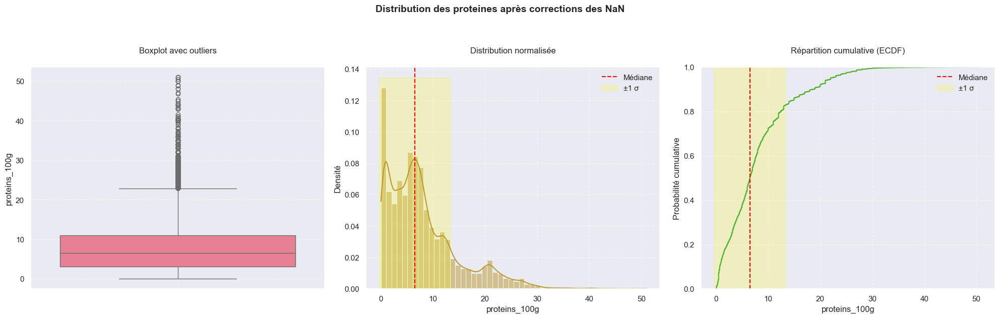

In [115]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'proteins_100g', titre='Distribution des proteines après corrections des NaN')

### carbohydrates_100g

In [117]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'carbohydrates_100g')

,Données manquantes,Données manquantes(%)
0,14,0.044325


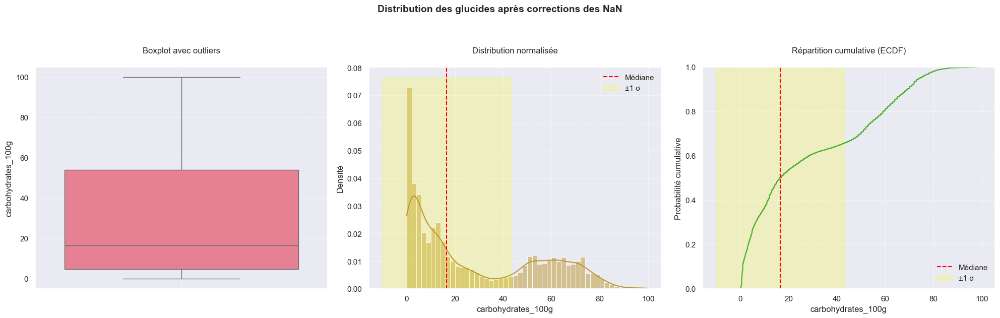

In [118]:
visualiser_macronutriments(openfoodfactLight, 'carbohydrates_100g', titre='Distribution des glucides après corrections des NaN')

In [119]:
# Affiche les lignes où carbohydrates_100g est le seul NaN
carbohydrates_only_nan = openfoodfactLight[openfoodfactLight['carbohydrates_100g'].isna() & openfoodfactLight.drop('carbohydrates_100g', axis=1).notna().all(axis=1)]
display(carbohydrates_only_nan)

,product_key,pnns_groups_1,code,product_name,brands,countries_fr,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g
31041,michel chatillon_les florentins chocolat lait...,Sugary snacks,3328481290008,Les Florentins ® Chocolat lait et orange,Michel Chatillon,France,12.0,2190.0,NaN,6.92,30.0,3.85,0.0162,0.385
31042,michel chatillon_les florentins chocolat noir...,Sugary snacks,3328481290374,Les Florentins ® Chocolat noir et caramel au b...,Michel Chatillon,France,21.0,2190.0,NaN,6.92,30.0,3.85,0.0162,0.385


In [120]:
energy_nan = openfoodfactLight[openfoodfactLight['carbohydrates_100g'].isna()][['code', 'product_name','brands', 'carbohydrates_100g']]
#energy_nan.to_csv('carbohydrates_nan.csv', index=False)

In [121]:
#Correction en masse (recherche internet)
corrections_en_masse = {'8718215720386':11,'5400601005360':10,'3270160311446':70,'3760093910033':60,'3162900001215':75,'3700211234351':65,
                        '3700211234030':55,'3252970006163':70,'5411188121992':12,'5411188122043':11,'5411188121770':8,'5411188106876':13,
                        '8722700189992':70,'8722700152767':30,'3700214610022':45,'8009327003963':0.7,'3608580007128':11,'3045320077636':17,
                        '3045320013559':60,'3045320509502':20,'3608580792802':12,'3608580720515':7.9,'3608580007135':14,'3608580844136':9.1,
                        '3608580837336':5,'613008742652':12,'3413880022906':45,'3596710341610':7,'3254565417873':0,'3596710344994':5,
                        '3596710353842':0.7,'3254560424944':0.7,'3254560046214':70,'3596710431748':3,'3596710432677':5,'3596710430246':10,
                        '3596710412822':40,'3596710427024':70,'3596710390144':75,'3596710356966':65,'3596710032709':10,'3254560051690':10,
                        '3596710329106':10,'3596710389964':11,'3596710432394':15,'3596710318889':5,'3596710345274':6,'3596710407712':67,
                        '3596710275625':10,'3596710021338':66,'3596710409259':60,'3254560064911':15,'3596710396597':70,'3596710356751':1,
                        '3596710182633':20,'3596710437528':70,'3596710252701':20,'3596710347247':4,'3596710330911':20,'3596710411610':8,
                        '3596710386215':2,'5690302115233':0,'4260121343875':0,'3017760555494':60,'3258561010052':65,'3258561301372':11,
                        '3254560051690':10,'3596710329106':10,'3596710389964':11,'3596710432394':15,'3596710318889':5,'3596710345274':6,
                        '3596710407712':67,'3596710275625':10,'3596710021338':66,'3596710409259':60,'3254560064911':15,'3596710396597':70,
                        '3596710356751':1,'3596710182633':20,'3596710437528':70,'3596710252701':20,'3596710347247':4,'3596710330911':20,
                        '3596710411610':8,'3596710386215':2,'5690302115233':0,'4260121343875':0,'3017760555494':60,'3258561010052':65,
                        '3258561301372':11,'26029535':80,'3083681017656':7,'3083680603119':6,'3261430007428':79,'5400141164091':70,
                        '5400141296143':5,'3608580780656':20,'3045320009385':60,'3608580823469':60,'3608580797180':60,'3045320094008':60,
                        '3045320094091':60,'3396410003227':0.7,'3396410024512':45,'3396410046941':50,'3396410031275':75,'3396410003838':5,
                        '3174503173428':70,'3222120006596':3,'3250391205424':65,'3182180060122':60,'3278310001278':0.7,'4008713756661':60,
                        '3760011731528':20,'7613033604645':30,'3770003475002':12,'3168930007159':65,'3168930006749':60,'8712566050116':10  
}

for code, nouvelle_valeur in corrections_en_masse.items():
    openfoodfactLight.loc[openfoodfactLight['code'] == code, 'carbohydrates_100g'] = nouvelle_valeur

In [122]:
analyze_exploratoire_distribution(openfoodfactLight, 'carbohydrates_100g')

,Données manquantes,Données manquantes(%)
0,14,0.044325


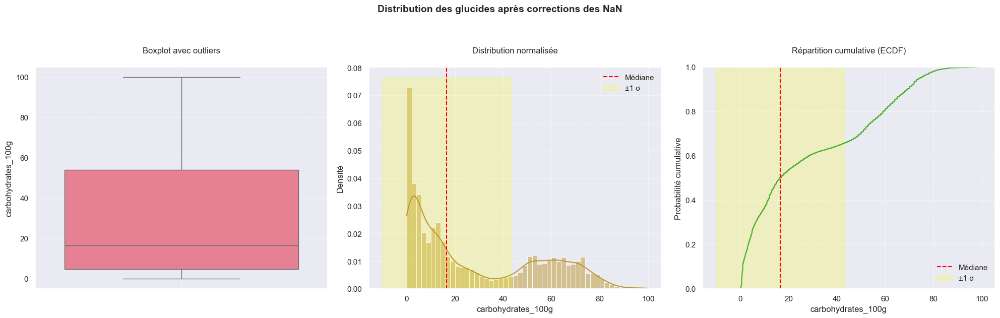

In [123]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'carbohydrates_100g', titre='Distribution des glucides après corrections des NaN')

### fat_100g

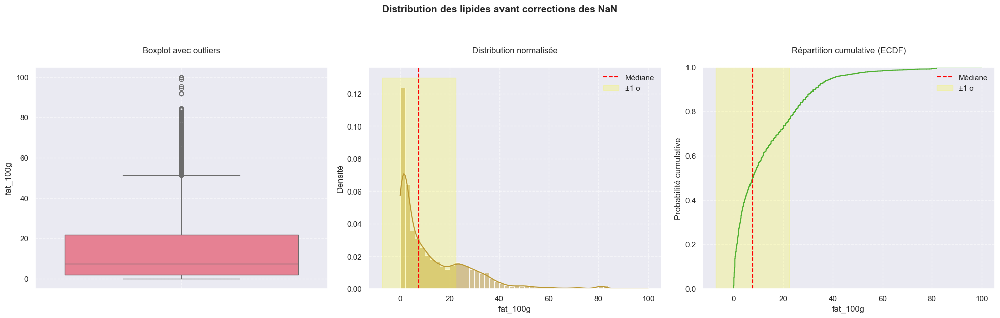

In [125]:
visualiser_macronutriments(openfoodfactLight, 'fat_100g', titre='Distribution des lipides avant corrections des NaN')

In [126]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'fat_100g')

,Données manquantes,Données manquantes(%)
0,50,0.158303


In [127]:
# Affiche les lignes avec NaN pour une variable
nan_rows = openfoodfactLight[openfoodfactLight['fat_100g'].isna()]

# Extraction des marques uniques
marques_uniques = nan_rows['brands'].unique().tolist()

# Affichage du nombre de marques uniques
print(f"Nombre de marques uniques : {len(marques_uniques)}")

print(marques_uniques)

Nombre de marques uniques : 33
["Auchan BIO,L'oiseau,Auchan", "Auchan Bio,L'oiseau,Auchan,Auchan Production,Groupe Auchan", 'Auchan', 'Bio Village', 'Bonneterre', 'Bosto', 'Carrefour Bio', 'Carrefour', 'carrefour', 'cora', 'Delhaize', 'Dukan', 'Erté', 'Florentin', 'Freshona', 'Fruistar,marque repère', "Grillon d'Or", 'hema', 'Kalibio', 'K.philus', 'Leclerc', 'Maison Roucadil,Bio source', 'Marque Repère', "Mcvitie's", 'Migros', 'Notre Jardin,Marque Repère', 'Notre jardin,Marque repère', 'Pedon', 'Pressade', 'Primeal', 'Produits blancs', 'Tables du monde', 'U']


In [128]:
# Liste des marques d'eau
marques_eau = ['Volvic', 'Badoit', 'Évian', 'Saint Amand', 'Perrier', 'Plancoët', 'Mont Roucous', 'Volcania', 'Mont Dore', 
               'Aquarel', 'Valécrin', 'Contrex', 'Font Vella', 'Vittel', 'Vals','7 up,Seven-Up','Fresh Tea,Marque Repère',
               'Teisseire', 'Ricqles', 'Schweppes', 'Oasis', 'Juvamine', 'Melfor', 'Eyguebelle', 'Dark Dog', 'Arcens', 
               'Moulin de Valdonne', '7up', 'Pepsico', 'Lipton', 'Granini', 'Fresh Tea', 'Pause Fraîcheur','Bionade', 
               'Seven-Up', 'Monster', 'Aquarius', 'Chaudfontaine', 'Minute Maid', 'Powerade', 'Fanta', 'Coca Cola',
               'De Nigris','Lesieur','Emile Noël','Soléou'          
              ]

# Conversion des noms de marques en minuscules pour une comparaison insensible à la casse
marques_eau_lower = [marque.lower() for marque in marques_eau]

# Fonction pour vérifier si une marque correspond à une marque d'eau
def est_marque_eau(marque):
    return any(eau in str(marque).lower() for eau in marques_eau_lower)

# Application de la modification
mask = openfoodfactLight['brands'].apply(est_marque_eau) & openfoodfactLight['fat_100g'].isna()
openfoodfactLight.loc[mask, 'fat_100g'] = 0

print("Modification effectuée. Nombre de lignes modifiées :", sum(mask))

Modification effectuée. Nombre de lignes modifiées : 0


In [129]:
# Nombre de lignes où uniquement fat_100g est NaN
unique = openfoodfactLight[openfoodfactLight['fat_100g'].isna() & openfoodfactLight.drop('fat_100g', axis=1).notna().all(axis=1)].shape[0]
print(f"Nombre de lignes où seul fat_100g est NaN : {unique}")

Nombre de lignes où seul fat_100g est NaN : 0


In [130]:
# Affiche les lignes où fat_100g  est NaN avec la somme des autres macro nutriments ≥ 98
columns_to_sum = ['sodium_100g', 'carbohydrates_100g', 'proteins_100g', 'fiber_100g']
mask = (openfoodfactLight['fat_100g'].isna()) & (openfoodfactLight[columns_to_sum].sum(axis=1) >= 98)
display(openfoodfactLight[mask])

,product_key,pnns_groups_1,code,product_name,brands,countries_fr,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g


In [131]:
fat_nan = openfoodfactLight[openfoodfactLight['fat_100g'].isna()][['code', 'product_name','brands', 'fat_100g']]
#fat_nan.to_csv('fat_nan.csv', index=False)

In [132]:
#Correction en masse (recherche internet)
corrections_en_masse = {
    '8712566351008': 3,
    '8710398169594': 2,
    '8594071484026': 31,
    '8480017010193': 80,
    '8436045040053': 6,
    '8421251891155': 30,
    '8410188112495': 31,
    '8410179005164': 100,
    '8410172652525': 31,
    '8001665128537': 2,
    '7640104952879': 18,
    '7613035032071': 31,
    '737282310700': 7,
    '66721005830': 3,
    '6111032004950': 2,
    '5600317470517': 30,
    '5414624147853': 7,
    '5414359922015': 35,
    '5412956214526': 31,
    '5411156031070': 80,
    '5411156000472': 80,
    '5410291012784': 17,
    '5410256704006': 20,
    '5410046000516': 20,
    '5400601200260': 2,
    '5400247010674': 2,
    '5400141296143': 30,
    '5400141169041': 2,
    '5400141167887': 2,
    '5400141167788': 2,
    '5400141101232': 12,
    '5400141041750': 17,
    '5400134371109': 2,
    '5400113535423': 30,
    '5400101046825': 33,
    '5202659381058': 31,
    '5201136117456': 20,
    '5200101108376': 100,
    '4026913121706': 25,
    '4008569028387': 2,
    '4006040202844': 31,
    '4003247101840': 100,
    '3770002165027': 3,
    '3760121210678': 20,
    '3760092217126': 18,
    '3760092215412': 30,
    '3760091727732': 80,
    '3760091722751': 20,
    '3760091721051': 35,
    '3760091720641': 31,
    '3760091720634': 31,
    '3760091347084': 17,
    '3760074310074': 2,
    '3760074310050': 2,
    '3760069560606': 35,
    '3760066230014': 2,
    '3760049795783': 3,
    '3760027470220': 31,
    '3700337100615': 6,
    '3700214610022': 2,
    '3700036903272': 30,
    '3661112096489': 6,
    '3660603004361': 33,
    '3660088101555': 10,
    '3660088101111': 10,
    '3660088100091': 10,
    '3660088100084': 10,
    '3608580823469': 20,
    '3608580797180': 20,
    '3596710445073': 3.7,
    '3596710441563': 2,
    '3596710438716': 2,
    '3596710434923': 33,
    '3596710418077': 2,
    '3596710413416': 100,
    '3596710412822': 20,
    '3596710410866': 40,
    '3596710407712': 3,
    '3596710407644': 31,
    '3596710396122': 10,
    '3596710396115': 10,
    '3596710385317': 30,
    '3596710355969': 35,
    '3596710318902': 3,
    '3596710318889': 3,
    '3596710129607': 20,
    '3589320121307': 30,
    '3578840000049': 2,
    '3564709022918': 20,
    '3564709021416': 10,
    '3564709015361': 20,
    '3564707087919': 2,
    '3564700808863': 3,
    '3564700793657': 30,
    '3564700756379': 20,
    '3564700753484': 33,
    '3564700749838': 35,
    '3564700724859': 20,
    '3564700695869': 33,
    '3564700683224': 30,
    '3564700651131': 30,
    '3564700633953': 35,
    '3564700596920': 20,
    '3564700596883': 20,
    '3564700549414': 17,
    '3564700500965': 80,
    '3564700497913': 80,
    '3564700494172': 20,
    '3564700494097': 25,
    '3564700451588': 30,
    '3564700429914': 80,
    '3564700370315': 2,
    '3564700366172': 2,
    '3564700318621': 2,
    '3564700225363': 2,
    '3564700220061': 20,
    '3564700022030': 6,
    '3564700011188': 20,
    '3564700010556': 3,
    '3560071080327': 2,
    '3560071013400': 2,
    '3560070900657': 80,
    '3560070825233': 20,
    '3560070749058': 2,
    '3560070708031': 6,
    '3560070701971': 20,
    '3560070701797': 20,
    '3560070701735': 20,
    '3560070508013': 6,
    '3560070496006': 6,
    '3560070470570': 30,
    '3560070437405': 2,
    '3560070369720': 20,
    '3523230032971': 2,
    '3523230026383': 17,
    '3523230001168': 2,
    '3523230000826': 80,
    '3522920001730': 10,
    '3513610140044': 2,
    '3501940131009': 31,
    '3483981002435': 31,
    '3483981002411': 31,
    '3477730001138': 31,
    '3467980310005': 40,
    '3456770034160': 2,
    '3452200009098': 20,
    '3452200004284': 20,
    '3452200004055': 20,
    '3452010001480': 100,
    '3452010000360': 100,
    '3451790936012': 30,
    '3451790857188': 30,
    '3450970063180': 20,
    '3450970060455': 15,
    '3450970044790': 3,
    '3441260003290': 20,
    '3438860004062': 80,
    '3438860002013': 5,
    '3435070118046': 3,
    '3431590010075': 2,
    '3423183280118': 20,
    '3421557107009': 18,
    '3413880022906': 31,
    '3412290070231': 20,
    '3412290016185': 80,
    '3410280059167': 6,
    '3410280021447': 12,
    '3410280019130': 6,
    '3410280004709': 30,
    '3396411225970': 31,
    '3396410048709': 31,
    '3396410024512': 31,
    '3396410024192': 31,
    '3396410024154': 31,
    '3396410016272': 10,
    '3396111000426': 35,
    '3395320066742': 2,
    '3390390000269': 17,
    '3380380072024': 30,
    '3380380052071': 18,
    '3375610000182': 30,
    '3368959012534': 17,
    '3368959012527': 17,
    '3368958362258': 20,
    '3367651005417': 30,
    '3350240051018': 40,
    '3350033200074': 3,
    '3347431922356': 18,
    '3347430697774': 3,
    '3339720413652': 6,
    '3339720413010': 6,
    '3339571110007': 10,
    '3336590105267': 100,
    '3335880001401': 20,
    '3335265200214': 2,
    '3335265200191': 2,
    '3335030003033': 2,
    '3332621044253': 30,
    '3330724201221': 20,
    '3330724201054': 20,
    '3330720213051': 20,
    '3330720211125': 20,
    '3321431020267': 12,
    '3307907990081': 20,
    '3291960012302': 100,
    '3291960010995': 100,
    '3291960010582': 3,
    '3288967428205': 20,
    '3279020000124': 3,
    '3277390015076': 2,
    '3275550003604': 3,
    '3273220540886': 2,
    '3273120022604': 2,
    '3273120022536': 30,
    '3273120014913': 18,
    '3273120014906': 18,
    '3270190129615': 100,
    '3270190022077': 2,
    '3270190007074': 20,
    '3270160436033': 30,
    '3266980138721': 20,
    '3266980043827': 20,
    '3266191151069': 20,
    '3266191151021': 20,
    '3266191104454': 31,
    '3266191104379': 31,
    '3266191104102': 31,
    '3266191104065': 31,
    '3266191104058': 31,
    '3266191104041': 31,
    '3266191104034': 31,
    '3266191104010': 31,
    '3266191080970': 7,
    '3266191057941': 6,
    '3266191056982': 2,
    '3266191056913': 2,
    '3266191056869': 2,
    '3266191056852': 2,
    '3266191056555': 2,
    '3266191055862': 80,
    '3266191055787': 2,
    '3266191055732': 2,
    '3266191055619': 30,
    '3266191055084': 4.3,
    '3266191054971': 2,
    '3266191018591': 33,
    '3266191018485': 3,
    '3266191010946': 100,
    '3266191010403': 100,
    '3266191008509': 3,
    '3266191008189': 18,
    '3266191008097': 18,
    '3266191007557': 30,
    '3266191007526': 30,
    '3266191007359': 30,
    '3266191006871': 17,
    '3266191002170': 3,
    '3266191000879': 17,
    '3266191000862': 17,
    '3266191000848': 17,
    '3266191000787': 80,
    '3266110053900': 6,
    '3265776658078': 20,
    '3265776307211': 80,
    '3263859760717': 3,
    '3263859401214': 17,
    '3263858360116': 17,
    '3263853107617': 35,
    '3263852213814': 31,
    '3263851928511': 20,
    '3263851870599': 20,
    '3263851286017': 10,
    '3263850583216': 31,
    '3263850571015': 2,
    '3263629965311': 3,
    '3261055910707': 30,
    '3258831020408': 33,
    '3258563420637': 80,
    '3258561462219': 30,
    '3258561450964': 30,
    '3258561420790': 80,
    '3258561060453': 31,
    '3258561040394': 7,
    '3258561021041': 30,
    '3257985024812': 30,
    '3257985023136': 3,
    '3257985023129': 3,
    '3257984998282': 80,
    '3257984763859': 30,
    '3257984550534': 7,
    '3257984441115': 20,
    '3257984355108': 100,
    '3257984346502': 80,
    '3257983973150': 18,
    '3257983303001': 2,
    '3257983103373': 25,
    '3257982124003': 35,
    '3257981937505': 20,
    '3257981665729': 3,
    '3257981411074': 80,
    '3257980838933': 100,
    '3257980579164': 20,
    '3257980483294': 30,
    '3257980373717': 80,
    '3257980305879': 20,
    '3257980204141': 100,
    '3257980084156': 2,
    '3257980045553': 2,
    '3257980024275': 2,
    '3257980024244': 30,
    '3257980021205': 3.2,
    '3256225042319': 7,
    '3256224375548': 30,
    '3256224375531': 30,
    '3256224231592': 30,
    '3256224231530': 30,
    '3256224034261': 3,
    '3256223195826': 7,
    '3256222646893': 80,
    '3256222254203': 2,
    '3256222242644': 2,
    '3256221408270': 20,
    '3256221407235': 31,
    '3256221136241': 20,
    '3256221099881': 30,
    '3256221016246': 40,
    '3256220871334': 7,
    '3256220410960': 17,
    '3256220362412': 2,
    '3256220210454': 30,
    '3254560424975': 80,
    '3254560416413': 80,
    '3254550030346': 30,
    '3254550025991': 80,
    '3252920016457': 80,
    '3250547813190': 3,
    '3250392383923': 7,
    '3250392246457': 30,
    '3250392152604': 6,
    '3250392034757': 3,
    '3250391819256': 25,
    '3250391461714': 2,
    '3250391402748': 12,
    '3250391345342': 30,
    '3250391337521': 20,
    '3250391319053': 20,
    '3250391218509': 6,
    '3250390862581': 31,
    '3250390538189': 3,
    '3250390465355': 6,
    '3250390408970': 30,
    '3250390010586': 30,
    '3250390000549': 100,
    '3248654100661': 30,
    '3245414659056': 35,
    '3245414229228': 20,
    '3245413852816': 2,
    '3245412477478': 12,
    '3245390220660': 40,
    '3245390194145': 6,
    '3245390093769': 30,
    '3245390021304': 30,
    '3245362071122': 20,
    '3245270000764': 100,
    '3228024150014': 30,
    '3222475458866': 30,
    '3222475412431': 2,
    '3222473703296': 6,
    '3222472770756': 20,
    '3222472008644': 35,
    '3222471141618': 3,
    '3220035228003': 20,
    '3184670016787': 20,
    '3180950007162': 30,
    '3180940073481': 6,
    '3177340019409': 6,
    '3176577291008': 2,
    '3175681051874': 3,
    '3173980040803': 2,
    '3168930000679': 35,
    '3162900057090': 10,
    '3116430057938': 20,
    '3111900350625': 18,
    '3101740020017': 20,
    '3101740010025': 20,
    '3089739926000': 6,
    '3077319432096': 3,
    '3046920045643': 31,
    '3045320013559': 20,
    '3045320009385': 20,
    '3038680807814': 12,
    '3024720027748': 40,
    '3019081235376': 10,
    '30087040': 30,
    '27067864': 30,
    '26065496': 30,
    '26033976': 100,
    '26032788': 25,
    '26021478': 20,
    '26017556': 20,
    '20725242': 12,
    '20681937': 2,
    '20593162': 30,
    '20474584': 33,
    '2045151099990': 18,
    '20368197': 31,
    '20342111': 6,
    '20167646': 2,
    '20114701': 20,
    '20046248': 10,
    '20034658': 12,
    '20014438': 31,
    '20013578': 100,
    '2000000109879': 3
}
for code, nouvelle_valeur in corrections_en_masse.items():
    openfoodfactLight.loc[openfoodfactLight['code'] == code, 'fat_100g'] = nouvelle_valeur

In [133]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'fat_100g')

,Données manquantes,Données manquantes(%)
0,44,0.139307


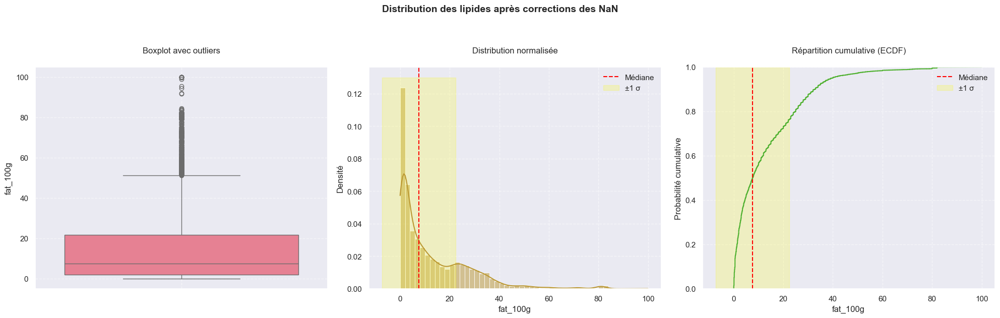

In [134]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'fat_100g', titre='Distribution des lipides après corrections des NaN')

### fiber_100g

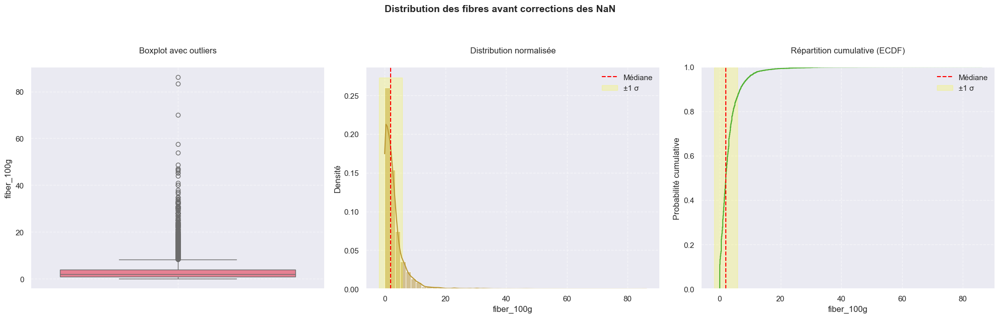

In [136]:
visualiser_macronutriments(openfoodfactLight, 'fiber_100g', titre='Distribution des fibres avant corrections des NaN')

In [137]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'fiber_100g')

,Données manquantes,Données manquantes(%)
0,11110,35.174925


In [138]:
# Affiche les lignes avec NaN pour une variable
nan_rows = openfoodfactLight[openfoodfactLight['fiber_100g'].isna()]
display(nan_rows)

,product_key,pnns_groups_1,code,product_name,brands,countries_fr,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g
8,1001 delights_falafel,Composite foods,20793227,Falafel,1001 delights,France,11.0,1461.0,24.3,10.3,22.1,NaN,0.401575,NaN
9,1001 delights_mini börek,Composite foods,20793142,Mini Börek,1001 delights,France,4.0,1090.0,30.1,5.3,13.2,NaN,0.346457,NaN
10,1001 delights_potato crisps kebab flavour,Salty snacks,20758073,Potato Crisps Kebab flavour,1001 Delights,France,15.0,2251.0,50.5,6.0,34.0,NaN,0.681102,NaN
11,1001delights_potato crisps sweet spicy,Salty snacks,20758066,Potato crisps sweet & spicy,1001delights,France,14.0,2251.0,50.5,6.0,34.0,NaN,0.551181,NaN
30,5 ocean_morceaux de thon au naturel,Fish Meat Eggs,6187751053333,Morceaux de thon au naturel,5 ocean,France,-1.0,421.0,0.5,23.0,0.8,NaN,0.295276,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48294,étoile du vercors_saintmarcellin,Milk and dairy products,3237051002531,Saint-Marcellin,Étoile du Vercors,France,14.0,1138.0,0.9,16.0,23.0,NaN,0.629921,NaN
48295,étoile du vercors_saintmarcellin 23 mg,Milk and dairy products,3237051002661,Saint-Marcellin (23% MG),Étoile du Vercors,France,14.0,1138.0,0.9,16.0,23.0,NaN,0.629921,NaN
48305,öma_mozza,Milk and dairy products,4026913151857,Mozza,ÖMA,France,10.0,1026.0,1.0,18.0,19.0,NaN,0.196850,NaN
48308,ülkervildiz holding_çikolata,Sugary snacks,8690504022732,Çikolata,"Ülker,Vildiz holding",France,28.0,2371.0,56.1,10.5,33.3,NaN,0.354331,NaN


In [139]:
# Nombre de lignes où uniquement fiber_100g est NaN
unique = openfoodfactLight[openfoodfactLight['fiber_100g'].isna() & openfoodfactLight.drop('fiber_100g', axis=1).notna().all(axis=1)].shape[0]
print(f"Nombre de lignes où seul fiber_100g est NaN : {unique}")

Nombre de lignes où seul fiber_100g est NaN : 21


In [140]:
# Affiche les lignes où fiber_100g est NaN avec la somme des autres macro nutriments ≥ 98
columns_to_sum = ['sodium_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g'] 
mask = (openfoodfactLight['fiber_100g'].isna()) & (openfoodfactLight[columns_to_sum].sum(axis=1) >= 98)

# Mettre à jour fiber_100g à 0 pour ces lignes
openfoodfactLight.loc[mask, 'fiber_100g'] = 0

# Vérifier les modifications
print(f"Nombre de lignes modifiées : {mask.sum()}")

# Export en CSV
#openfoodfactLight[mask].to_csv('fiber_nan_fiber_sum98.csv', index=False)

Nombre de lignes modifiées : 72


In [141]:
fiber_nan = openfoodfactLight[openfoodfactLight['fiber_100g'].isna()][['code', 'product_name','brands', 'fiber_100g']]
fiber_nan.to_csv('fiber_nan.csv', index=False)

In [142]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'fiber_100g')

,Données manquantes,Données manquantes(%)
0,11038,34.946968


In [143]:
#Correction en masse (recherche internet)
corrections_en_masse = {'3410280020358': 4, '26043371': 4, '2000000009452': 4, '26017211': 4, '3350031913563': 4, '8480017016065': 4, '3248650124777': 4, '3222472481812': 4, '3250391774081': 4, '3347437756313': 4, '3250390962281': 4, '3410280000114': 4, '3435649842976': 4, '3439497014837': 4, '3250391418916': 4, '3215351040088': 4, '3270160065424': 4, '3350031999871': 4, '3410280000107': 4, '3335880004211': 4, '3083680482004': 4, '3222471135570': 4, '3222471096994': 4, '3017800109731': 4, '3596710387724': 4, '3410280000121': 4, '3250391340385': 4, '3596710068586': 4, '3435649841481': 4, '5400247029997': 4, '26043494': 4, '3335880004426': 4, '3350030134198': 4, '3023290169971': 4, '3560070951673': 4, '3252920037704': 4, '32638596918202': 4, '3250390682462': 4, '3023290152812': 4, '2000000036687': 4, '3276650050017': 4, '3165440008102': 4, '3580281042052': 4, '3580281042250': 4, '20029838': 5, '3250390618959': 6, '3660992015009': 6, '3017620713729': 6, '3596710412907': 6, '3410280023243': 6, '3263852406513': 6, '3700152400235': 6, '3263852201514': 6, '9002859087431': 6, '3588400253686': 6, '4013900720349': 6, '3760170090016': 6, '20418786': 6, '4044889001518': 6, '3760170098470': 6, '3046920047418': 6, '5400265025711': 6, '898575001375': 6, '20437756': 6, '20681357': 6, '3263850574115': 6, '3116430201997': 6, '4013900864760': 6, '3046920059275': 6, '3760231780085': 6, '3760170094151': 6, '3222472669111': 6, '3350031947940': 6, '3760170093772': 6, '7610036000818': 6, '7610008631002': 6, '3250390411932': 6, '3263852201910': 6, '3222472523918': 6, '3263852200517': 6, '3254560713352': 6, '3250390862604': 6, '3760170099873': 6, '3700152400037': 6, '20047009': 6, '3392070010018': 6, '8718421154760': 6, '8718421156290': 6, '8718421154753': 6, '3173282600835': 6, '3173282600187': 6, '3173282606790': 6, '3173281610750': 6, '3173281601840': 6, '5400247012906': 6, '20177201': 6, '3250391782819': 6, '3273220085523': 6, '3184830101476': 6, '3760091722607': 6, '3483981301637': 6, '3046920027946': 6, '3700279303716': 6, '3760231780207': 6, '8000500182963': 6, '3250390268642': 6, '3396413709775': 6, '3410280005607': 6, '3596710366354': 6, '3501940129006': 6, '3501940170008': 6, '3760008560377': 6, '26040042': 6, '3250391374113': 6, '3350131247711': 6, '3760020500252': 6, '3760121210623': 6, '3396411221286': 6, '3046920010009': 6, '3700279306182': 6, '7610248503404': 6, '5412956214540': 6, '6148022866793': 6, '3596710338955': 6, '7610400082907': 6, '3263852978119': 6, '3046920027885': 6, '3173281604995': 6, '3370077586002': 6, '3396410048686': 6, '3760231780122': 6, '3046920010047': 6, '3046920022606': 6, '20691998': 6, '3250391503834': 6, '3046920057745': 6, '8480017516114': 6, '3046920010825': 6, '8480017013378': 6, '7610400069267': 6, '3250391737284': 6, '3501940001708': 6, '4044889000054': 6, '3760020500290': 6, '3396413709355': 6, '3396410047559': 6, '3501940117003': 6, '5400265025704': 6, '3222471858721': 6, '42127767': 6, '3250391422715': 6, '4044889002225': 6, '3250392007768': 6, '3370077586033': 6, '20713713': 6, '3046920027960': 6, '3254560069466': 6, '3120470188507': 6, '3046920009997': 6, '3046920007382': 6, '3396410024147': 6, '3263852213395': 6, '3501940105000': 6, '5412038129205': 6, '3396410024208': 6, '3501940001609': 6, '3046920010368': 6, '3250392087210': 6, '3501940573007': 6, '3263852191013': 6, '3410280023304': 6, '27085219': 6, '20593643': 6, '3046920017640': 6, '3700279305772': 6, '4000539677809': 6, '7610148166167': 6, '7610008638506': 6, '5000159471749': 6, '8712566934744': 6, '5010775193277': 6, '7350022392588': 6, '5400265024097': 6, '76840600038': 6, '8711200562718': 6, '3263858056514': 6, '8480017015532': 6, '3046920029759': 6, '3284230004138': 6, '7630030301711': 6, '3273070062651': 6, '3173287631285': 6, '3173287631025': 6, '3173287631100': 6, '3173287630943': 6, '3760013724542': 6, '3263855573311': 6, '3120340024416': 6, '3120340024423': 6, '3046920023009': 6, '7610400084895': 6, '3046920038652': 6, '3046920041911': 6, '7610400081313': 6, '8003340095073': 6, '7610400071185': 6, '2044318073545': 6, '3046920042758': 6, '3046920042826': 6, '3046920009973': 6, '3046920009980': 6, '3046920000437': 6, '3046920074001': 6, '3046920045896': 6, '3046920047203': 6, '3046920029674': 6, '3046920028370': 6, '3046944045315': 6, '26043395': 6, '8717496903914': 6, '3250390000778': 6, '5060176410152': 6, '3439497012314': 6, '3083680085311': 6, '3270160595228': 6, '3596710395972': 6, '3580282213017': 6, '3335880004723': 6, '3083680085304': 6, '3222472384090': 6, '3256221142990': 6, '3270160435203': 7, '3270160431403': 7, '3600900010283': 7, '3600900005586': 7, '3600900020091': 7, '3600900005524': 7, '3090070101131': 7, '3090070101148': 7, '3600900005203': 7, '161710018621': 7, '3165440008621': 7, '3165440008935': 7, '26070247': 7, '3760240720041': 7, '3033610035541': 7, '3760018884166': 7, '3250392215248': 7, '3600900010771': 7, '3600900011037': 7, '3600900001922': 7, '3222472845751': 7, '7753228000064': 7, '3760136680770': 7, '3046920010740': 8, '3046920022651': 8, '3046920027656': 8, '3046920057738': 8, '3046920027649': 8, '3046920057721': 8, '3046920027953': 8, '4000539203602': 8, '3046920028721': 8, '3046920010412': 8, '3046920010405': 8, '3046920057776': 8, '3046920029698': 8, '3046920027724': 8, '3046920027281': 8, '3046920011501': 8, '3120470146514': 8, '3046920084000': 8, '3046920027458': 8, '3046920010610': 8, '3046920057769': 8, '3046920027861': 8, '3046920028752': 8, '3046920029452': 8, '4000539083501': 8, '3046920055789': 8, '3046920010603': 8, '3046920017527': 8, '3046920010801': 8, '3046920057752': 8, '3046920027878': 8, '3046920017565': 8, '3120470111581': 8, '3046920017503': 8, '3046920057707': 8, '3083680027311': 8, '3266191107677': 8, '8000066095127': 8, '3021690026115': 8, '3292320048627': 8, '3483190002509': 8, '3261055932815': 8, '3083680652094': 8, '3425471202086': 8, '3760215380140': 8, '3250390005179': 8, '3663783000499': 8, '26061283': 8, '10603069': 8, '3600900010597': 8, '3700214613948': 8, '3600900020084': 8, '3215355070081': 8, '3760092219014': 8, '3760014422904': 8, '2000000032518': 8, '3263850821110': 8, '227628013582': 8, '26077345': 8, '3250390387244': 8, '3350031937798': 8, '3111900308299': 8, '3350031937804': 8, '3760103003434': 8, '3266191008134': 8, '3760077181718': 8, '4000417214003': 8, '4000417018007': 8, '4000417260000': 8, '4000417023001': 8, '4000417602008': 8, '4000417027009': 8, '4000417294005': 8, '4000417618009': 8, '4000417607003': 8, '4000417623003': 8, '42208587': 8, '4000417300003': 8, '4000417019004': 8, '4000417025005': 8, '4000417044303': 8, '4000417224002': 8, '4000417622006': 8, '4000417026002': 8, '4000417012005': 8, '4000417650702': 8, '4000417611000': 8, '4000417013002': 8, '3396410052553': 9, '3250391533107': 9, '3329630301699': 9, '20381417': 9, '5400247026903': 9, '8033413731317': 9, '3259749700840': 9, '27066577': 9, '3329630301736': 9, '3329630904906': 9, '5400247020949': 9, '3329630901103': 9, '3250390786979': 9, '3258561110547': 9, '3222475618031': 9, '26042466': 9, '3250392208530': 9, '3250391364787': 9, '3596710108664': 9, '3410280023755': 9, '3596710088478': 9, '3222473808946': 9, '3250391191215': 9, '3329630901110': 9, '20681760': 9, '3250390638803': 9, '3261055862419': 9, '3512690002211': 9, '3350030182793': 9, '3329630903503': 9, '3263859855116': 9, '3222475618048': 9, '20347413': 9, '3263859855819': 9, '3263850534416': 9, '8713600116126': 9, '8712566408153': 9, '3350030195663': 9, '3502490019335': 9, '3276650124534': 9, '3162050018699': 9, '4442197109740': 9, '4008258146026': 9, '3179142054725': 9, '3240931539706': 10, '8005121053081': 10, '8005658018058': 10, '8005658018010': 10, '8005658018041': 10, '3222474211905': 10, '3222475122446': 10, '3250390000419': 10, '3250390000365': 10, '3264961127351': 10, '3250392053383': 10, '3263859830816': 10, '3596710262823': 10, '3250391781652': 10, '3250391986606': 10, '3264961827312': 10, '5400247011671': 10, '26019345': 10, '3250390000389': 10, '8009303037630': 10, '8025202002654': 10, '3250392263607': 10, '3264963013263': 10, '3347430100397': 10, '3250390009474': 10, '8015602000244': 10, '3222476099280': 10, '3263850534119': 10, '20258634': 10, '3240931534985': 10, '3240931534879': 10, '3240931537139': 10, '3240930007787': 10, '3250390287735': 10, '5011069149529': 10, '8024257270063': 10, '2225884050257': 10, '3222471799734': 10, '3222473390069': 10, '26022314': 10, '3242272253051': 10, '3240931539355': 10, '3240931534619': 10, '3240931540481': 10, '3240931536866': 10, '3250391535460': 10, '8001060027152': 10, '8017977013386': 10, '3240931540221': 10, '9002859064210': 10, '8004690052716': 10, '3250390300984': 10, '3266140059149': 10, '3250391163069': 10, '3240930301205': 10, '8016857020094': 10, '20441944': 10, '3266140059125': 10, '3240931539485': 10, '3240931541099': 10, '3596710283484': 10, '3218260005025': 10, '5400247044990': 10, '3240930514025': 10, '3240931531106': 10, '8016857040047': 10, '3760019718163': 10, '3572170373002': 10, '8016857014000': 10, '3760098451104': 10, '3240931538952': 10, '8001665128049': 10, '3770003725121': 10, '3038352910101': 10, '8480017334145': 10, '8480017334169': 10, '3261052882007': 10, '3261055939142': 10, '3261055940681': 10, '3038352880305': 10, '3038352890304': 10, '3261055941862': 10, '3250391372287': 10, '8007303205059': 10, '3660861023975': 10, '3240931538877': 10, '3367651005523': 10, '3250390000396': 10, '3410280024387': 10, '5400247011657': 10, '3250390009443': 10, '3760136681333': 10, '26019062': 10, '3770002558119': 10, '20031244': 10, '20486501': 10, '4821221008813': 10, '8005658008813': 10, '3240931541150': 10, '3564709000268': 10, '8712100679216': 10, '8712100386992': 10, '3560070824854': 10, '3560070824861': 10, '8852018101055': 10, '3222471002919': 10, '3250390000303': 10, '20534653': 10, '3250392041809': 10, '20533649': 10, '6933362461551': 10, '20534707': 10, '4710008211730': 10, '3250391954353': 10, '9556041130677': 10, '4002359660894': 10, '8850987123641': 10, '3379145024156': 10, '3760092457478': 10, '3760092457492': 10, '3379141908214': 10, '5997523317119': 10, '3043675624871': 10, '5997523317171': 10, '8712429176403': 10, '5997523317096': 10, '5997523317133': 10, '8712429176502': 10, '8712429176304': 10, '8853662006833': 10, '6933362462299': 10, '3250390009498': 10, '8005658008899': 10, '3250392334352': 10, '8001665123068': 10, '1001124320004': 10, '3242272252559': 10, '3242272252962': 10, '3242272253655': 10, '3242272253754': 10, '3242272254553': 10, '3242272256359': 10, '3242272256250': 10, '3242272256656': 10, '3250392141585': 10, '3760098459032': 10, '3560070712489': 10, '3250391374816': 10, '20003500': 10, '8004880000367': 10, '3347439020313': 10, '4018722301844': 10, '3263856484814': 10, '3596710406722': 10, '3660861002413': 10, '3193482626961': 10, '8480011114361': 10, '3250391535408': 10, '3263859491024': 10, '3276650100965': 10, '8005121000344': 10, '26019680': 10, '26066059': 10, '8005658008745': 10, '3256221111736': 10, '20691981': 10, '3270727002923': 10, '20359607': 10, '20005719': 10, '3595930805452': 10, '3502490099139': 10, '3760181140182': 10, '3760181140212': 10, '3580281580110': 10, '3250390207542': 10, '14113911719': 10, '26024677': 10, '14113912853': 10, '14113912938': 10, '14113912860': 10, '3250390733539': 10, '3245363952017': 10, '3367651005226': 10, '3367651004922': 10, '3240937300553': 10, '3240931539546': 10, '3240931539539': 10, '3266140059446': 10, '3240931538204': 10, '3266140057954': 10, '3240931538198': 10, '3266140050801': 10, '3266140059514': 10, '3266140058913': 10, '3760098459063': 10, '3266140051785': 10, '3222476310132': 10, '3250391549313': 10, '3266140051679': 10, '3266140053581': 10, '3266140051655': 10, '3596710214716': 10, '3292830292824': 10, '3266140051600': 10, '3292830291995': 10, '3760098459124': 10, '3240931539836': 10, '3261055931566': 10, '3261058155266': 10, '3240930000801': 10, '3210791540150': 10, '3266140051792': 10, '3250392356279': 10, '5400247009968': 10, '3261055931580': 10, '8021733250892': 10, '3250390520337': 10, '3263859471019': 10, '3263859479817': 10, '3240931541136': 10, '3263859471521': 10, '3760098451050': 10, '3263856731413': 10, '3596710173471': 10, '3596710421862': 10, '3250392066192': 10, '3431590002117': 10, '3431590002780': 10, '3760098459056': 10, '3250391740895': 10, '2000000045022': 10, '3261055931528': 10, '3261055932280': 10, '3240932422359': 10, '3396410037451': 10, '3240931539577': 10, '3335880006512': 10, '3760098459094': 10, '8001665700702': 10, '3596710421275': 10, '3250390001072': 10, '3263851611215': 10, '3038352880701': 10, '3240931539140': 10, '3261055932549': 10, '3261055940094': 10, '3410280020648': 10, '3760098452774': 10, '3240931540184': 10, '3760098459087': 10, '3260930200766': 10, '3276650100811': 10, '3261055931559': 10, '3188720600414': 10, '3266140051198': 10, '3596710364350': 10, '3266140057947': 10, '3335880006543': 10, '8001665113069': 10, '3350030120450': 10, '26019246': 10, '3038354526102': 10, '3250392272784': 10, '3222475440373': 10, '3350031912382': 10, '8480017124852': 10, '8480017126887': 10, '3250390108245': 10, '3241931217175': 10, '3240930217735': 10, '3240931538655': 10, '3240931538181': 10, '3240931534633': 10, '3261055935939': 10, '3261055935922': 10, '3261055935915': 10, '3052420300007': 10, '20122591': 10, '3760019710082': 10, '3700566451076': 10, '4013200330019': 10, '3564700009864': 10, '26019055': 10, '5948935002605': 10, '8025202001459': 10, '3263859846213': 10, '3264963012280': 10, '3222473010103': 10, '3250391985685': 10, '3073190107870': 10, '3250390009481': 10, '3276650059829': 10, '3256221111705': 10, '3188720600223': 10, '4000512776635': 10, '8001665701815': 10, '3180950008367': 10, '3180950066602': 10, '4000915102642': 10, '20012212': 10, '3038350054203': 10, '8001665701495': 10, '5400247044921': 10, '3760077534057': 10, '3263859847418': 10, '3760077534064': 10, '8005658008073': 10, '3760077530615': 10, '8000139001314': 10, '8480017110879': 10, '3760077530639': 10, '26045658': 10, '3250390346753': 10, '3467740060416': 10, '3252090000706': 10, '3250392220266': 10, '3250392259686': 10, '3350030204112': 10, '3240930021592': 10, '3250391781621': 10, '3263850515019': 10, '3760098459117': 10, '3222475752308': 10, '3240931540665': 10, '20466985': 10, '3350030202057': 10, '3240930020151': 10, '3266140058258': 10, '3266140059743': 10, '3250390858102': 10, '20534752': 10, '3596710326600': 10, '3760077534453': 10, '8020083000911': 10, '14119309': 10, '20164041': 10, '3222473959075': 10, '3258561110431': 10, '3250391967858': 10, '3263850534515': 10, '3467740092530': 10, '641243940359': 10, '3660861019947': 10, '8410740000918': 10, '3547130057117': 10, '3240931540641': 10, '3263859472313': 10, '3240931537689': 10, '3240931533292': 10, '3242272251453': 10, '3266140054045': 10, '3240931536859': 10, '4000915107715': 10, '3242272250555': 10, '3240931536187': 10, '3240931531007': 10, '80564874': 10, '3242272256458': 10, '8001665128520': 10, '3240931540115': 10, '20351922': 10, '8001665702713': 10, '3596710173457': 10, '3242272250050': 10, '20351915': 10, '3410280023649': 10, '8033413731089': 10, '3240930613001': 10, '3263850515910': 10, '3263859471415': 10, '3266140059415': 10, '5400247064387': 10, '3254560153257': 10, '3261055937711': 10, '20488468': 10, '3263859471712': 10, '3250390292760': 10, '3250390860525': 10, '3250390772187': 10, '3250390000358': 10, '8480017019226': 10, '3276650100972': 10, '3250391422562': 10, '8480017091291': 10, '3263856485019': 10, '3240931539164': 10, '3240931539614': 10, '5412514333393': 10, '5412514933050': 10, '20208887': 10, '3250390841210': 10, '3250391162246': 10, '3250391123513': 10, '20151140': 10, '8420056041017': 10, '8420056031209': 10, '8420056097601': 10, '20501396': 10, '3270160304769': 10, '3580282930167': 10, '3250391162215': 10, '3250392108656': 10, '8005658018096': 10, '8005658018102': 10, '3240931539294': 10, '26019581': 10, '3251490481009': 15, '3254560065055': 17, '3700225117084': 17, '3266191103457': 17, '3410280000077': 17, '3596710389988': 17, '3335880004655': 17, '3580281355145': 17, '3276650101153': 17, '3030210540741': 17, '8410313325813': 17, '3661945730031': 17, '5410928058130': 18, '3663783000123': 18, '5400247029300': 18, '26043586': 18, '3250391343348': 18, '3596710420087': 18, '3250390003786': 18, '3030210540727': 18, '3335880004617': 18, '3292320048634': 18, '3502490019496': 20, '3502490125456': 20, '5400247032898': 20, '3179142066902': 20, '3351700036583': 25, '26075181': 25, '3030212302330': 25, '3250390561392': 25, '8428532230146': 25, '3073781073539': 25, '3073781040692': 25, '3073781043365': 25, '3502490002078': 25, '3257980532893': 25, '3270720000155': 25, '3502490122554': 25, '3179140503249': 25, '3270720000261': 25, '3250390770879': 25, '3179140503294': 25, '838948007559': 25, '3272770097178': 25, '3350031990991': 25, '20267605': 25, '20413422': 25, '4003786911511': 25, '3336971508076': 25, '8480017034540': 25, '3336971311065': 25, '3502490099153': 25, '3596710133291': 25, '3276650127030': 25, '26036120': 25, '1303405450005': 25, '3250390207511': 25, '3760023450721': 25, '3250391906673': 25, '3760091722522': 25, '3760091722539': 25, '4008258038000': 25}
for code, nouvelle_valeur in corrections_en_masse.items():
    openfoodfactLight.loc[openfoodfactLight['code'] == code, 'fiber_100g'] = nouvelle_valeur

Les produits concernés sont les huiles, les sucres, les confiseries reputées pour ne pas avoir de fibres.

In [145]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'fiber_100g')

,Données manquantes,Données manquantes(%)
0,10338,32.730727


In [146]:
### Remplacement par 0
openfoodfactLight['fiber_100g'] = openfoodfactLight['fiber_100g'].fillna(0)

In [147]:
### Analyse exploratoire
analyze_exploratoire_distribution(openfoodfactLight, 'fiber_100g')

,Données manquantes,Données manquantes(%)
0,0,0.0


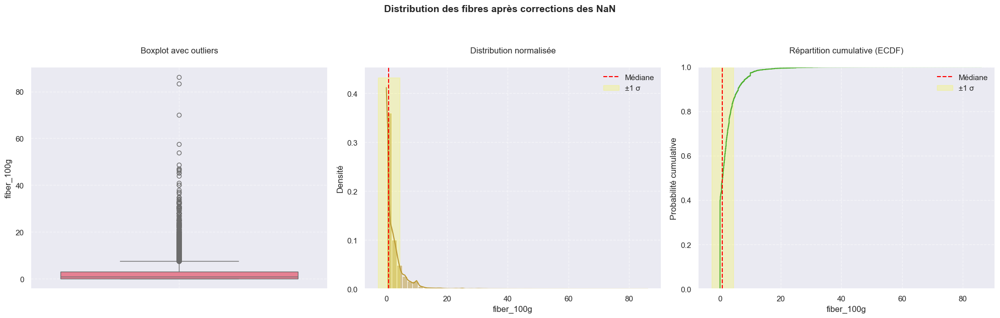

In [148]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'fiber_100g', titre='Distribution des fibres après corrections des NaN')

## Correction des NaN restant - models

In [150]:
print(openfoodfactLight['energy_100g'].describe())
print("\nNombre de NaN:",openfoodfactLight['energy_100g'].isna().sum())

count    31585.000000
mean      1128.753925
std        736.952983
min          1.000000
25%        464.000000
50%       1049.000000
75%       1678.000000
max       9050.000000
Name: energy_100g, dtype: float64

Nombre de NaN: 0


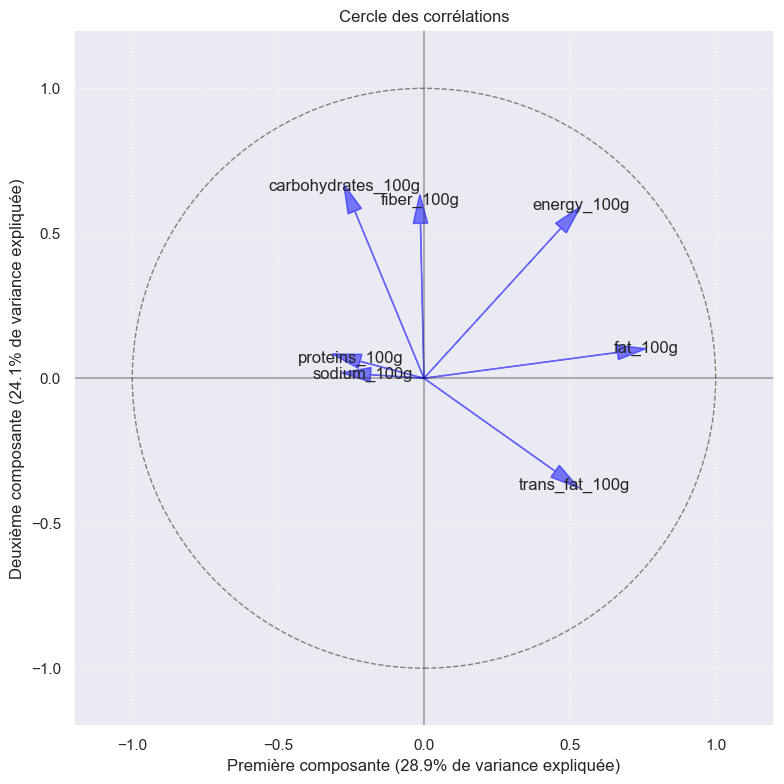

In [151]:
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

X_complete = openfoodfactLight[variables].dropna()

# Standardisation et ACP
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_complete)
pca = PCA()
pca_result = pca.fit_transform(X_scaled)

# Création de la figure 
fig, ax = plt.subplots(figsize=(8, 8))

# Ajout du cercle
circle = plt.Circle((0,0), radius=1, fill=False, color='gray', linestyle='--')
ax.add_patch(circle)

# Ajout des axes
plt.axhline(y=0, color='k', linestyle='-', alpha=0.3)
plt.axvline(x=0, color='k', linestyle='-', alpha=0.3)

# Ajout des flèches et labels avec une meilleure lisibilité
for i, (x, y) in enumerate(zip(pca.components_[0], pca.components_[1])):
    plt.arrow(0, 0, x, y, head_width=0.05, head_length=0.1, fc='blue', ec='blue', alpha=0.5)
    plt.text(x*1.15, y*1.15, variables[i], ha='center', va='center')

# Ajout d'une grille
plt.grid(True, linestyle=':', alpha=0.6)

# Configuration des limites et labels des axes
plt.xlim(-1.2, 1.2)
plt.ylim(-1.2, 1.2)
plt.xlabel(f'Première composante ({pca.explained_variance_ratio_[0]:.1%} de variance expliquée)')
plt.ylabel(f'Deuxième composante ({pca.explained_variance_ratio_[1]:.1%} de variance expliquée)')

plt.title('Cercle des corrélations')
plt.tight_layout()
plt.show()
plt.close()

Première composante (axe horizontal - 28.9% de variance) :
- Corrélation positive forte avec energy_100g et fat_100g
- Corrélation négative avec carbohydrates_100g
- Cette composante oppose les aliments gras/énergétiques aux aliments glucidiques


Deuxième composante (axe vertical - 24.1% de variance) :
- Corrélation positive avec les glucides et les fibres
- Corrélation négative avec les acides gras trans (trans_fat_100g)
- Représente l'opposition entre glucides/fibres et graisses trans

Points notables :
- Les protéines et le sodium sont peu représentés (proches du centre)

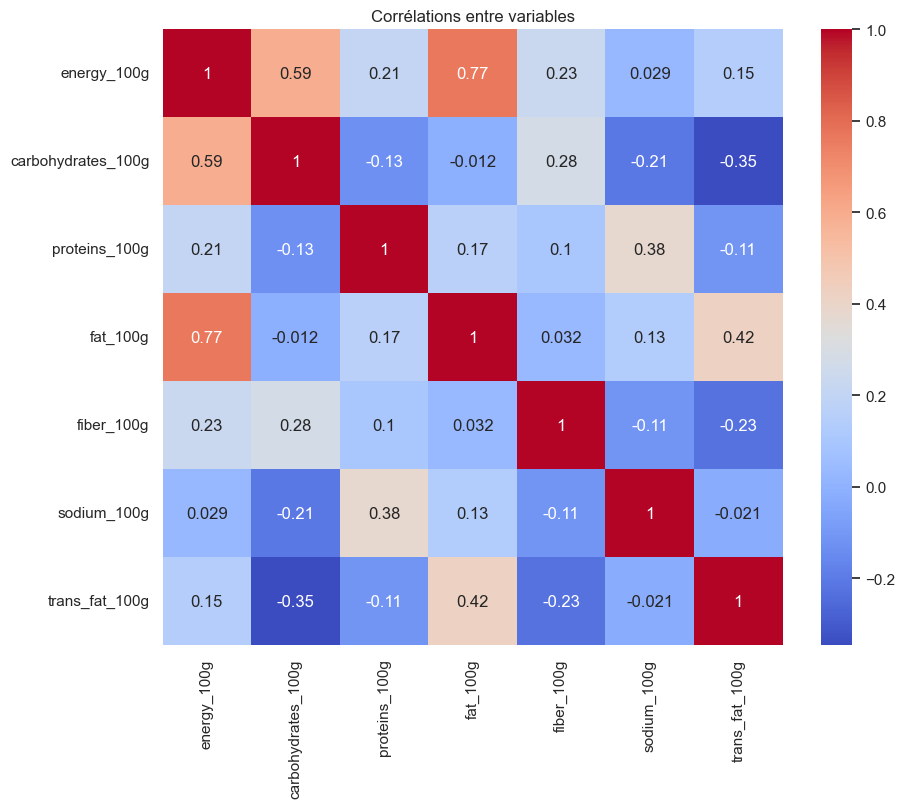

In [153]:
openfoodfactLight_test = openfoodfactLight.copy()

variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

plt.figure(figsize=(10, 8))
sns.heatmap(openfoodfactLight_test[variables].corr(), annot=True, cmap='coolwarm')
plt.title('Corrélations entre variables')
plt.show()
plt.close()

Corrélations fortes positives :
- Energy_100g et fat_100g (0.77) : logique car les graisses sont très caloriques
- Energy_100g et carbohydrates_100g (0.59) : contribution importante des glucides aux calories


Corrélations modérées :
- Fat_100g et trans_fat_100g (0.42) : lien attendu entre graisses totales et graisses trans
- Proteins_100g et sodium_100g (0.38) : suggère des aliments protéinés souvent plus salés


Corrélations négatives notables :
- Carbohydrates_100g et trans_fat_100g (-0.35) : opposition entre produits sucrés et gras trans
- Carbohydrates_100g et sodium_100g (-0.21) : opposition entre produits sucrés et salés

#### carbohydrates_100g

In [156]:
print(openfoodfactLight['carbohydrates_100g'].describe())
print("\nNombre de NaN:",openfoodfactLight['carbohydrates_100g'].isna().sum())

count    31571.000000
mean        28.726213
std         26.741794
min          0.000000
25%          4.700000
50%         16.500000
75%         54.000000
max        100.000000
Name: carbohydrates_100g, dtype: float64

Nombre de NaN: 14


In [157]:
#Imputation par la médiane
openfoodfactLight['carbohydrates_100g'] = openfoodfactLight['carbohydrates_100g'].fillna(openfoodfactLight['carbohydrates_100g'].median())

In [158]:
print(openfoodfactLight['carbohydrates_100g'].describe())
print("\nNombre de NaN:",openfoodfactLight['carbohydrates_100g'].isna().sum())

count    31585.000000
mean        28.720794
std         26.737105
min          0.000000
25%          4.700000
50%         16.500000
75%         54.000000
max        100.000000
Name: carbohydrates_100g, dtype: float64

Nombre de NaN: 0


#### fat_100g

In [160]:
print(openfoodfactLight['fat_100g'].describe())
print("\nNombre de NaN:",openfoodfactLight['fat_100g'].isna().sum())

count    31541.000000
mean        13.232523
std         14.887658
min          0.000000
25%          2.000000
50%          7.600000
75%         21.700000
max        100.000000
Name: fat_100g, dtype: float64

Nombre de NaN: 44


In [161]:
from sklearn.linear_model import LinearRegression

# Crée un masque pour les lignes où fat_100g n'est pas NaN
mask = openfoodfactLight['fat_100g'].notna()

# Prépare des données pour la régression
X = openfoodfactLight.loc[mask, ['energy_100g']]
y = openfoodfactLight.loc[mask, 'fat_100g']

# Crée et entraîne le modèle
reg = LinearRegression()#regression linéaire
reg.fit(X, y)

# Imputate les valeurs manquantes
openfoodfactLight.loc[~mask, 'fat_100g'] = reg.predict(openfoodfactLight.loc[~mask, ['energy_100g']])

In [162]:
print(openfoodfactLight['fat_100g'].describe())
print("\nNombre de NaN:",openfoodfactLight['fat_100g'].isna().sum())

count    31585.000000
mean        13.220785
std         14.885001
min         -3.329371
25%          2.000000
50%          7.600000
75%         21.700000
max        100.000000
Name: fat_100g, dtype: float64

Nombre de NaN: 0


In [163]:
openfoodfactLight.loc[openfoodfactLight['fat_100g'] < 0, 'fat_100g'] = 0

In [164]:
print(openfoodfactLight['fat_100g'].describe())
print("\nNombre de NaN:",openfoodfactLight['fat_100g'].isna().sum())

count    31585.000000
mean        13.222433
std         14.883406
min          0.000000
25%          2.000000
50%          7.600000
75%         21.700000
max        100.000000
Name: fat_100g, dtype: float64

Nombre de NaN: 0


#### sodium-100g

Les micronutriments (sodium_100g, calcium, iron, vitamin-c) sont faiblement corrélés

In [167]:
print(openfoodfactLight[['sodium_100g']].describe())
print("\nNombre de NaN:")
print(openfoodfactLight[['sodium_100g']].isna().sum())

        sodium_100g
count  31448.000000
mean       0.364150
std        0.479017
min        0.000000
25%        0.043307
50%        0.270000
75%        0.511811
max        8.346457

Nombre de NaN:
sodium_100g    137
dtype: int64


In [168]:
from sklearn.linear_model import LinearRegression

# Sélection des données sans NaN
mask_sodium = openfoodfactLight['sodium_100g'].notna()

# Variables prédictives (corrélation avec proteins_100g = 0.38)
X = openfoodfactLight[mask_sodium][['proteins_100g', 'carbohydrates_100g', 'fat_100g']]
y = openfoodfactLight[mask_sodium]['sodium_100g']

# Création et entraînement du modèle
reg_sodium = LinearRegression()
reg_sodium.fit(X, y)

# Prédiction des valeurs manquantes
mask_nan = openfoodfactLight['sodium_100g'].isna()
openfoodfactLight.loc[mask_nan, 'sodium_100g'] = reg_sodium.predict(openfoodfactLight[mask_nan][['proteins_100g', 'carbohydrates_100g', 'fat_100g']])

In [169]:
print(openfoodfactLight[['sodium_100g']].describe())
print("\nNombre de NaN:")
print(openfoodfactLight[['sodium_100g']].isna().sum())

        sodium_100g
count  31585.000000
mean       0.363902
std        0.478154
min        0.000000
25%        0.043307
50%        0.268000
75%        0.511811
max        8.346457

Nombre de NaN:
sodium_100g    0
dtype: int64


Les statistiques sont relativement similaires (moy 0.357 à 0.353) et distribution cohérente.

C:\Users\beche\AppData\Local\Temp\ipykernel_13992\2704499416.py:49: RuntimeWarning: invalid value encountered in log10
  [np.log10(mediane-std), np.log10(mediane+std)],


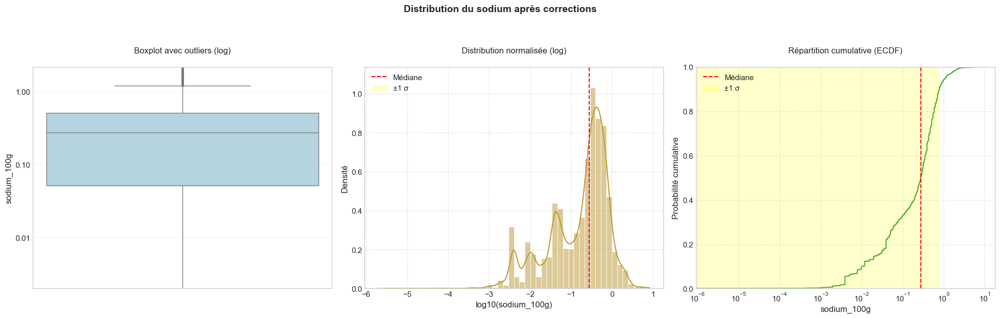

In [171]:
visualiser_micronutriments_nan_corriges(openfoodfactLight, 'sodium_100g', titre='Distribution du sodium après corrections')#pour slide

### trans_fat_100g

In [173]:
print(openfoodfactLight[['trans_fat_100g']].describe())
print("\nNombre de NaN:")
print(openfoodfactLight[['trans_fat_100g']].isna().sum())

       trans_fat_100g
count      222.000000
mean         0.193351
std          0.325189
min          0.000000
25%          0.000000
50%          0.000000
75%          0.294000
max          1.780000

Nombre de NaN:
trans_fat_100g    31363
dtype: int64


In [174]:
#conservation de la variables avec mise à 0 des valeurs manquantes
openfoodfactLight['trans_fat_100g'] = openfoodfactLight['trans_fat_100g'].fillna(0)

## Controles et corrections

### Correction des totaux > 100

In [177]:
variables = ['carbohydrates_100g', 'proteins_100g', 'fat_100g','sodium_100g']
sum_variables = openfoodfactLight[variables].sum(axis=1)
mask_over_100 = (sum_variables > 100) & (~openfoodfactLight[variables].isna().any(axis=1))

# Correction des valeurs
if len(openfoodfactLight[mask_over_100]) > 0:
    # Calcule le facteur de normalisation
    correction_factor = 100 / sum_variables[mask_over_100]
    
    # Applique la correction aux lignes concernées
    for col in variables:
        openfoodfactLight.loc[mask_over_100, col] = openfoodfactLight.loc[mask_over_100, col] * correction_factor

    # Résultat
    new_sum = openfoodfactLight[variables].sum(axis=1)
    print("Après correction, nombre de produits > 100g :", sum((new_sum > 100) & (~openfoodfactLight[variables].isna().any(axis=1))))

Après correction, nombre de produits > 100g : 24


### nutrition-score-fr_100g

In [179]:
print(openfoodfactLight[['nutrition-score-fr_100g']].describe())
print("\nNombre de NaN:")
print(openfoodfactLight[['nutrition-score-fr_100g']].isna().sum())

       nutrition-score-fr_100g
count             30938.000000
mean                  8.338678
std                   9.368674
min                 -15.000000
25%                   1.000000
50%                   8.000000
75%                  16.000000
max                  40.000000

Nombre de NaN:
nutrition-score-fr_100g    647
dtype: int64


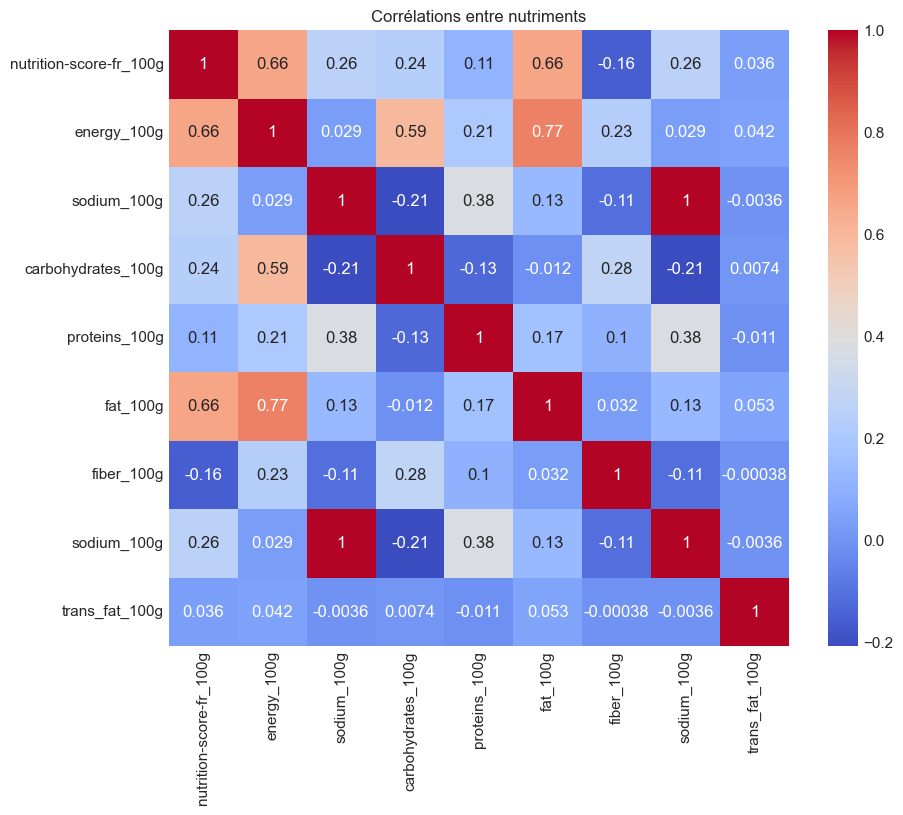

In [180]:
openfoodfactLight_test = openfoodfactLight.copy()

variables = ['nutrition-score-fr_100g','energy_100g','sodium_100g', 'carbohydrates_100g', 'proteins_100g', 
              'fat_100g', 'fiber_100g', 'sodium_100g','trans_fat_100g']


plt.figure(figsize=(10, 8))
sns.heatmap(openfoodfactLight_test[variables].corr(), annot=True, cmap='coolwarm')
plt.title('Corrélations entre nutriments')
plt.show()

Corrélations importantes :
- Energy : 0.61 (corrélation forte)
- Fat : 0.57 (corrélation modérée)
- Sodium : 0.23 (faible)
- Carbohydrates : 0.23 (faible)

Nombre de NaN initial: 647

Régression Linéaire:
R² score: 0.551
Coefficients: {'energy_100g': -0.0020627941315790295, 'fat_100g': 0.4761138286579573, 'sodium_100g': 4.998515881467989, 'carbohydrates_100g': 0.13915661256248393}

KNN (k=5):


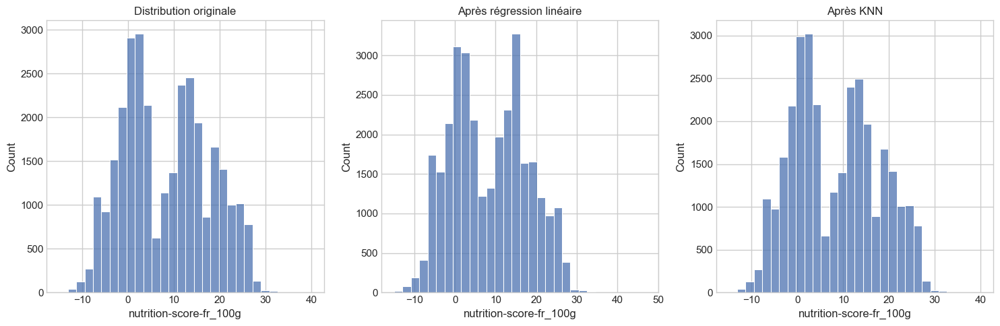


Statistiques descriptives:

Originale:
count    30938.000000
mean         8.338678
std          9.368674
min        -15.000000
25%          1.000000
50%          8.000000
75%         16.000000
max         40.000000
Name: nutrition-score-fr_100g, dtype: float64

Régression linéaire:
count    31585.000000
mean         8.325774
std          9.350562
min        -15.000000
25%          1.000000
50%          8.000000
75%         16.000000
max         47.019569
Name: nutrition-score-fr_100g, dtype: float64

KNN:
count    31585.000000
mean         8.272498
std          9.346950
min        -15.000000
25%          1.000000
50%          8.000000
75%         15.500000
max         40.000000
Name: nutrition-score-fr_100g, dtype: float64


In [182]:
#Fonctions et graphiques pour comparer 2 méthodes d'imputation (Linaire multiple Vs KNN)
def test_linear_regression(df):
    """Test d'imputation avec régression linéaire"""
    df_copy = df.copy()
    
    # Masque pour les données non-manquantes
    mask = ~df_copy['nutrition-score-fr_100g'].isna()
    
    # Prépare les variables
    variables = ['energy_100g', 'fat_100g', 'sodium_100g', 'carbohydrates_100g']
    
    # Entraînement du modèle
    reg = LinearRegression()
    X = df_copy.loc[mask, variables]
    y = df_copy.loc[mask, 'nutrition-score-fr_100g']
    reg.fit(X, y)
    
    # Prédiction des valeurs manquantes
    missing_X = df_copy.loc[~mask, variables]
    df_copy.loc[~mask, 'nutrition-score-fr_100g'] = reg.predict(missing_X)
    
    print("\nRégression Linéaire:")
    print(f"R² score: {reg.score(X, y):.3f}")
    print(f"Coefficients: {dict(zip(variables, reg.coef_))}")
    return df_copy

def test_knn(df, n_neighbors=5):
    """Test d'imputation avec KNN"""
    df_copy = df.copy()
    
    variables = ['energy_100g', 'fat_100g', 'sodium_100g', 'carbohydrates_100g']
    
    imputer = KNNImputer(n_neighbors=n_neighbors)
    
    # Prépare et imputate
    X = df_copy[variables + ['nutrition-score-fr_100g']]
    X_imputed = imputer.fit_transform(X)
    
    # Mise à jour des valeurs
    df_copy['nutrition-score-fr_100g'] = X_imputed[:, -1]
    
    print(f"\nKNN (k={n_neighbors}):")
    return df_copy

# Test les deux méthodes
print("Nombre de NaN initial:", openfoodfactLight['nutrition-score-fr_100g'].isna().sum())

# Applique les deux méthodes
df_linear = test_linear_regression(openfoodfactLight)
df_knn = test_knn(openfoodfactLight)

# Visualise des distributions
plt.figure(figsize=(15, 5))

# Distribution originale
plt.subplot(1, 3, 1)
sns.histplot(openfoodfactLight['nutrition-score-fr_100g'].dropna(), bins=30)
plt.title('Distribution originale')

# Distribution après régression linéaire
plt.subplot(1, 3, 2)
sns.histplot(df_linear['nutrition-score-fr_100g'], bins=30)
plt.title('Après régression linéaire')

# Distribution après KNN
plt.subplot(1, 3, 3)
sns.histplot(df_knn['nutrition-score-fr_100g'], bins=30)
plt.title('Après KNN')

plt.tight_layout()
plt.show()

# Statistiques descriptives
print("\nStatistiques descriptives:")
print("\nOriginale:")
print(openfoodfactLight['nutrition-score-fr_100g'].describe())
print("\nRégression linéaire:")
print(df_linear['nutrition-score-fr_100g'].describe())
print("\nKNN:")
print(df_knn['nutrition-score-fr_100g'].describe())

Choix du K_means KNN  :
- Préserve mieux la forme de la distribution originale
- Maintient les bornes naturelles (max à 40 comme l'originale)
- Les statistiques descriptives sont très proches de l'originale
- La moyenne (8.27) et l'écart-type (9.35) restent cohérents

In [184]:
# Nombre de NaN avant
print("Avant imputation:", openfoodfactLight['nutrition-score-fr_100g'].isna().sum(), "valeurs manquantes")

# variables pour l'imputation
variables = ['energy_100g', 'fat_100g', 'sodium_100g', 'carbohydrates_100g']

# Création et application de l'imputer
imputer = KNNImputer(n_neighbors=5)
X = openfoodfactLight[variables + ['nutrition-score-fr_100g']]
X_imputed = imputer.fit_transform(X)

# Mise à jour directe du DataFrame original
openfoodfactLight['nutrition-score-fr_100g'] = X_imputed[:, -1]

# Vérification
print("Après imputation:", openfoodfactLight['nutrition-score-fr_100g'].isna().sum(), "valeurs manquantes")

Avant imputation: 647 valeurs manquantes
Après imputation: 0 valeurs manquantes


In [185]:
print(openfoodfactLight['nutrition-score-fr_100g'].describe())
print("\nNombre de NaN:",openfoodfactLight['nutrition-score-fr_100g'].isna().sum())

count    31585.000000
mean         8.272498
std          9.346950
min        -15.000000
25%          1.000000
50%          8.000000
75%         15.500000
max         40.000000
Name: nutrition-score-fr_100g, dtype: float64

Nombre de NaN: 0


In [186]:
openfoodfactLight.loc[openfoodfactLight['nutrition-score-fr_100g'] > 40, 'nutrition-score-fr_100g'] = 40

In [187]:
print(openfoodfactLight[['energy_100g','sodium_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g', 'fiber_100g', 'sodium_100g']].describe())
print("\nNombre de NaN:")
print(openfoodfactLight[['energy_100g','sodium_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g', 'fiber_100g', 'sodium_100g']].isna().sum())

        energy_100g   sodium_100g  carbohydrates_100g  proteins_100g  \
count  31585.000000  31585.000000        31585.000000   31585.000000   
mean    1128.753925      0.363879           28.715958       8.050388   
std      736.952983      0.478122           26.728986       6.823388   
min        1.000000      0.000000            0.000000       0.000000   
25%      464.000000      0.043307            4.700000       3.100000   
50%     1049.000000      0.268000           16.500000       6.500000   
75%     1678.000000      0.511811           54.000000      11.000000   
max     9050.000000      8.346457           99.795302      51.000000   

           fat_100g    fiber_100g   sodium_100g  
count  31585.000000  31585.000000  31585.000000  
mean      13.220254      2.141008      0.363879  
std       14.878254      3.585002      0.478122  
min        0.000000      0.000000      0.000000  
25%        2.000000      0.000000      0.043307  
50%        7.600000      0.800000      0.268000  
7

### Controle des NaN

In [189]:
# Afficher le nombre de NaN par colonne
nan_count = openfoodfactLight.isna().sum()
print(nan_count)

product_key                0
pnns_groups_1              0
code                       0
product_name               0
brands                     0
countries_fr               0
nutrition-score-fr_100g    0
energy_100g                0
carbohydrates_100g         0
proteins_100g              0
fat_100g                   0
fiber_100g                 0
sodium_100g                0
trans_fat_100g             0
dtype: int64


### Suppresion des colonnes product_key, code et countries_fr

In [191]:
openfoodfactLight = openfoodfactLight.drop(['product_key', 'code', 'countries_fr'], axis=1)

### Normalisation des libellés de pnns_groups_1

In [193]:
# Extraction des pnns_groups_1 uniques
pnns_groups_1_uniques = nan_rows['pnns_groups_1'].unique().tolist()
print(f"Nombre de pnns_groups_1 uniques : {len(pnns_groups_1_uniques)}")
print(pnns_groups_1_uniques)

Nombre de pnns_groups_1 uniques : 11
['Composite foods', 'Salty snacks', 'Fish Meat Eggs', 'Milk and dairy products', 'Sugary snacks', 'Fat and sauces', 'fruits-and-vegetables', 'Beverages', 'Cereals and potatoes', 'Fruits and vegetables', 'sugary-snacks']


In [194]:
# Simplification des catégories
# Mapping de normalisation
mapping = {
    'Fruits and vegetables': 'fruits-and-vegetables',
    'Sugary snacks': 'sugary-snacks',
    'Cereals and potatoes':'cereals-and-potatoes',
}

# Application du mapping
openfoodfactLight['pnns_groups_1'] = openfoodfactLight['pnns_groups_1'].map(lambda x: mapping.get(x, x))

# Vérification des catégories uniques 
print(openfoodfactLight['pnns_groups_1'].nunique())
print(sorted(openfoodfactLight['pnns_groups_1'].unique()))

9
['Beverages', 'Composite foods', 'Fat and sauces', 'Fish Meat Eggs', 'Milk and dairy products', 'Salty snacks', 'cereals-and-potatoes', 'fruits-and-vegetables', 'sugary-snacks']


# Analyses

## Statistiques descriptives

In [197]:
openfoodfactLight.describe()

,nutrition-score-fr_100g,energy_100g,carbohydrates_100g,proteins_100g,fat_100g,fiber_100g,sodium_100g,trans_fat_100g
count,31585.000000,31585.000000,31585.000000,31585.000000,31585.000000,31585.000000,31585.000000,31585.000000
mean,8.272498,1128.753925,28.715958,8.050388,13.220254,2.141008,0.363879,0.001359
std,9.346950,736.952983,26.728986,6.823388,14.878254,3.585002,0.478122,0.031637
min,-15.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,464.000000,4.700000,3.100000,2.000000,0.000000,0.043307,0.000000
50%,8.000000,1049.000000,16.500000,6.500000,7.600000,0.800000,0.268000,0.000000
75%,15.500000,1678.000000,54.000000,11.000000,21.700000,3.000000,0.511811,0.000000
max,40.000000,9050.000000,99.795302,51.000000,99.760724,86.200000,8.346457,1.780000


## Analyses univariées de chaque variable

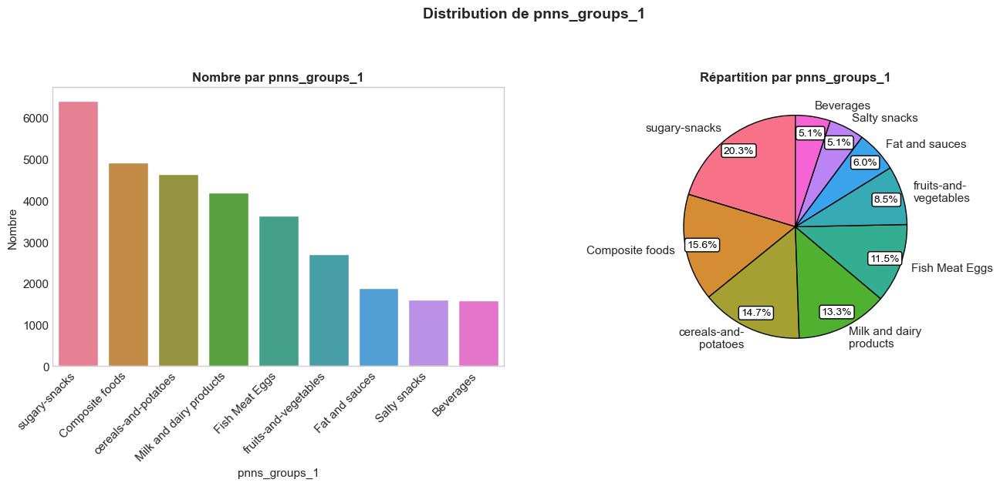

In [199]:
# Fonction pour visualiser la distribution d'une variable catégorielle.
import textwrap

def visualiser_distribution(df, colonne, ordre=None, palette='husl', titre=None, xlabel=None, ylabel=None):

    counts = df[colonne].value_counts()

    # Trier les données si un ordre est fourni
    if ordre:
        counts = counts.reindex(ordre).dropna()

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

    # Barplot
    sns.barplot(x=counts.index, y=counts.values, ax=ax1, hue=counts.index, palette=sns.color_palette(palette, n_colors=len(counts)), legend=False)
    ax1.set_facecolor('white')
    ax1.grid(False)
    ax1.set_title(f'Nombre par {colonne}', fontsize=12, fontweight='bold')
    ax1.set_xlabel(xlabel or colonne, fontsize=11)
    ax1.set_ylabel(ylabel or 'Nombre', fontsize=11)

    ax1.set_xticks(range(len(counts)))
    ax1.set_xticklabels(counts.index, rotation=45, ha="right")

    # Gestion des labels longs
    def wrap_labels(labels, width=15):
        return [textwrap.fill(label, width) for label in labels]

    labels = wrap_labels(counts.index)
    
    # Pie chart amélioré
    wedges, texts, autotexts = ax2.pie(counts, labels=labels, autopct=lambda p: f'{p:.1f}%' if p > 2 else '', 
                                       startangle=90, colors=sns.color_palette(palette, n_colors=len(counts)), 
                                       pctdistance=0.85, labeldistance=1.1, wedgeprops={'edgecolor': 'black'})
    
    # Amélioration de la lisibilité des pourcentages
    for autotext in autotexts:
        autotext.set_fontsize(10)
        autotext.set_color('black')
        autotext.set_bbox(dict(facecolor='white', edgecolor='black', boxstyle='round,pad=0.2'))

    ax2.set_title(f'Répartition par {colonne}', fontsize=12, fontweight='bold')

    fig.suptitle(titre or f'Distribution de {colonne}', y=1.05, fontsize=14, fontweight='bold')

    plt.tight_layout()

    # Sauvegarde de l’image avec horodatage
    date = datetime.datetime.now().strftime("%Y%m%d_%H%M")
    plt.savefig(f'distribution_{colonne}_{date}.png', bbox_inches='tight', dpi=300)

    plt.show()
    plt.close()

# Utilisation
visualiser_distribution(openfoodfactLight, 'pnns_groups_1')


analyse de la distribution des groupes alimentaires (pnns_groups_1) :

Groupes dominants :
- Sugary-snacks en tête (>6000 produits, 20.3%)
- Composite foods en seconde position (~5000 produits, 15.6%)
- Cereals and potatoes en troisième (~4500 produits, 14.7%)


Groupes intermédiaires :
- Milk and dairy products et Fish Meat Eggs représentent chacun environ 11-13% du total
- Fruits-and-vegetables constituent 8.5%


Groupes minoritaires :
- Fat and sauces (6.0%)
- Salty snacks et cereals-and-potatoes (environ 5% chacun)

Surreprésentation des produits transformés et sucrés dans le jeu de données, comparé aux aliments de base comme les fruits et légumes.

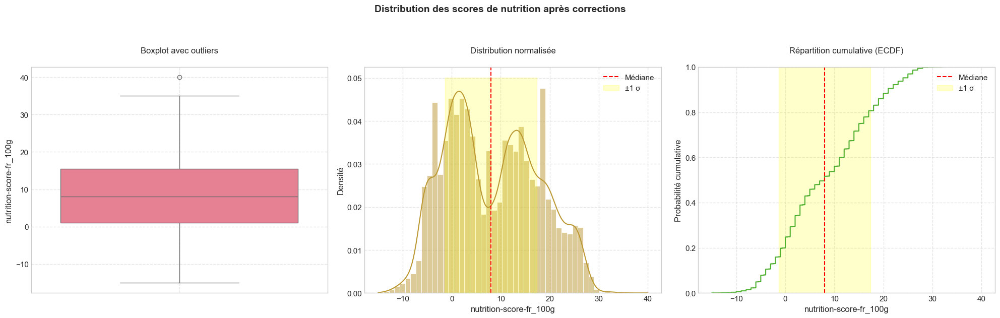

In [201]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'nutrition-score-fr_100g', titre='Distribution des scores de nutrition après corrections')#pour slide

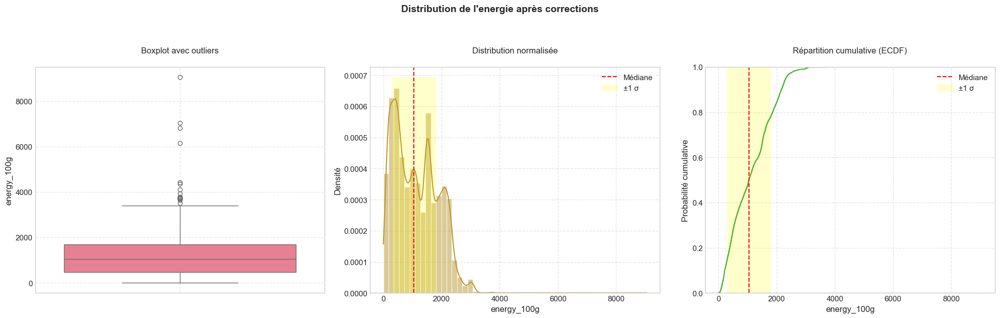

In [202]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'energy_100g', titre='Distribution de l\'energie après corrections') #pour slide

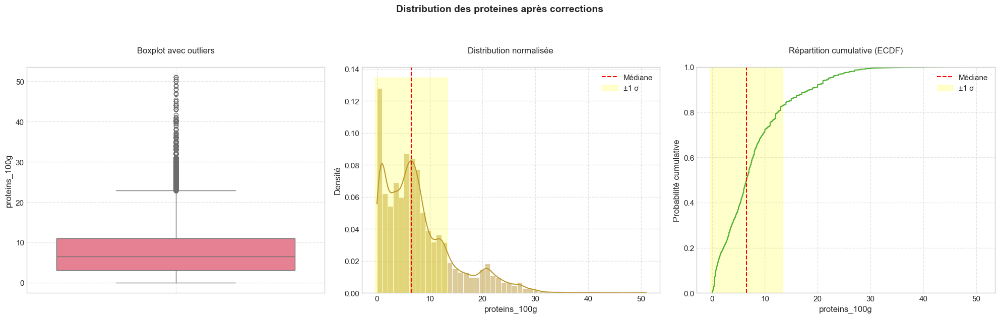

In [203]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'proteins_100g', titre='Distribution des proteines après corrections')#pour slide

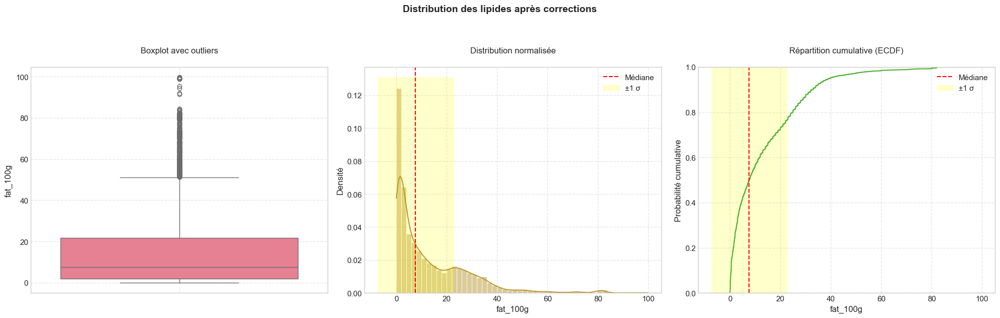

In [204]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'fat_100g', titre='Distribution des lipides après corrections')#pour slide

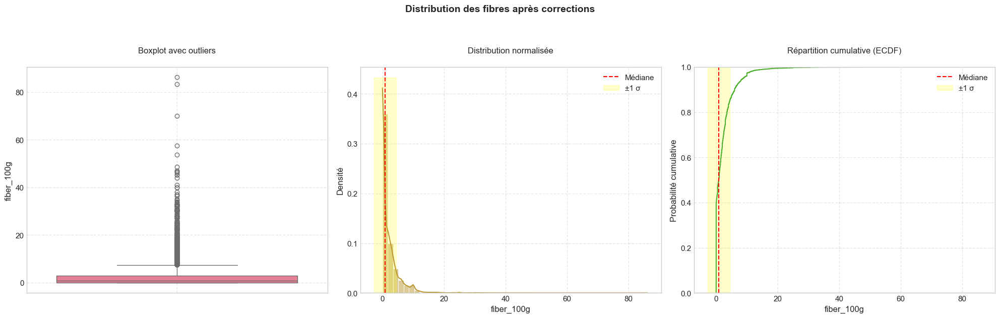

In [205]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'fiber_100g', titre='Distribution des fibres après corrections')#pour slide

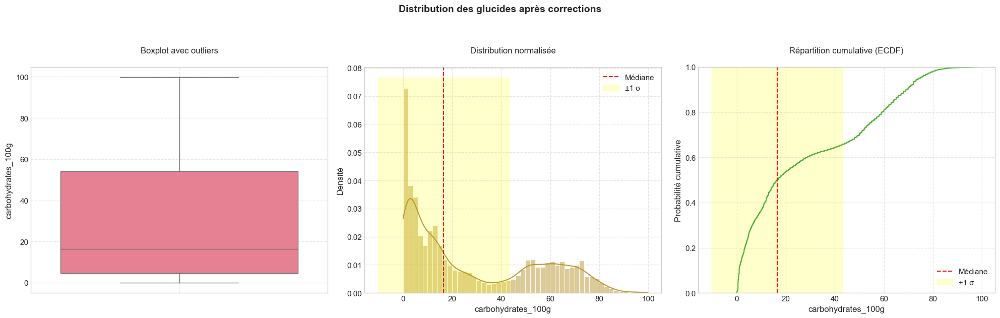

In [206]:
visualiser_macronutriments_nan_corriges(openfoodfactLight, 'carbohydrates_100g', titre='Distribution des glucides après corrections')#pour slide

Analyse  des distributions des nutriments après corrections :
Score nutritionnel (nutrition-score-fr_100g) :
- Distribution bimodale centrée autour de 0 et 20
- Majorité des valeurs entre -10 et 30
- Présence d'"outliers" jusqu'à 40

Énergie (energy_100g) :
- Distribution asymétrique droite
- Forte concentration autour de 0-2000 kcal/100g
- Quelques valeurs extrêmes jusqu'à 8000 kcal/100g

Protéines (proteins_100g) :
- Distribution asymétrique droite
- Majorité des produits < 20g/100g
- Nombreux outliers jusqu'à 50g/100g

Lipides (fat_100g) :
- Distribution asymétrique droite marquée
- La plupart des produits < 40g/100g
- Quelques valeurs extrêmes jusqu'à 100g/100g

Fibres (fiber_100g) :
- Distribution très asymétrique
- Forte concentration près de 0
- Rares valeurs > 20g/100g

Glucides (carbohydrates_100g) :
- Distribution multimodale
- Pics autour de 0, 40 et 60g/100g
- Valeurs maximales autour de 100g/100g

Toutes ces distributions montrent une forte asymétrie et la présence de valeurs extrêmes.

C:\Users\beche\AppData\Local\Temp\ipykernel_13992\2704499416.py:49: RuntimeWarning: invalid value encountered in log10
  [np.log10(mediane-std), np.log10(mediane+std)],


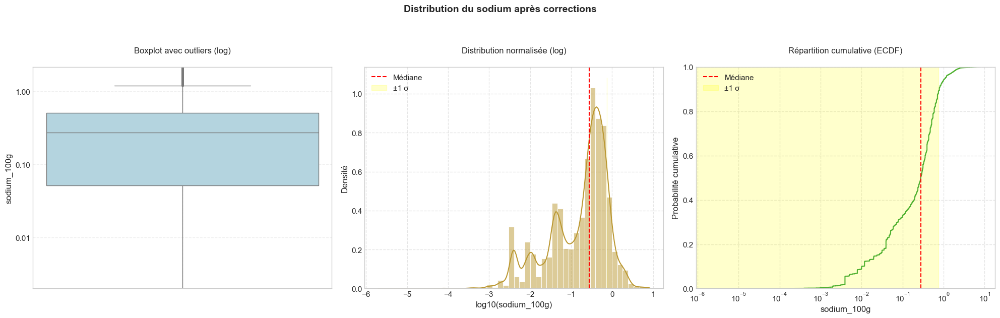

In [208]:
visualiser_micronutriments_nan_corriges(openfoodfactLight, 'sodium_100g', titre='Distribution du sodium après corrections')#pour slide

C:\Users\beche\AppData\Local\Temp\ipykernel_13992\2704499416.py:49: RuntimeWarning: invalid value encountered in log10
  [np.log10(mediane-std), np.log10(mediane+std)],


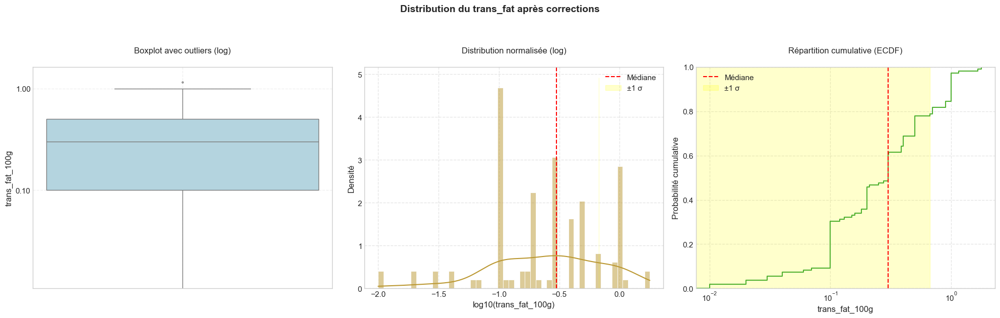

In [209]:
visualiser_micronutriments_nan_corriges(openfoodfactLight, 'trans_fat_100g', titre='Distribution du trans_fat après corrections')#pour slide

Sodium (sodium_100g) :
- Distribution log-normale
- Majorité des valeurs entre 10^-3 et 10^0
- Pic principal autour de 10^-1
- La courbe ECDF montre une progression régulière sur l'échelle log

Acides gras trans (trans_fat_100g) :
- Distribution très discontinue sur l'échelle log
- Beaucoup de valeurs autour de 10^-1
- Progression par paliers sur l'ECDF

## Analyses bivariées de chaque variable

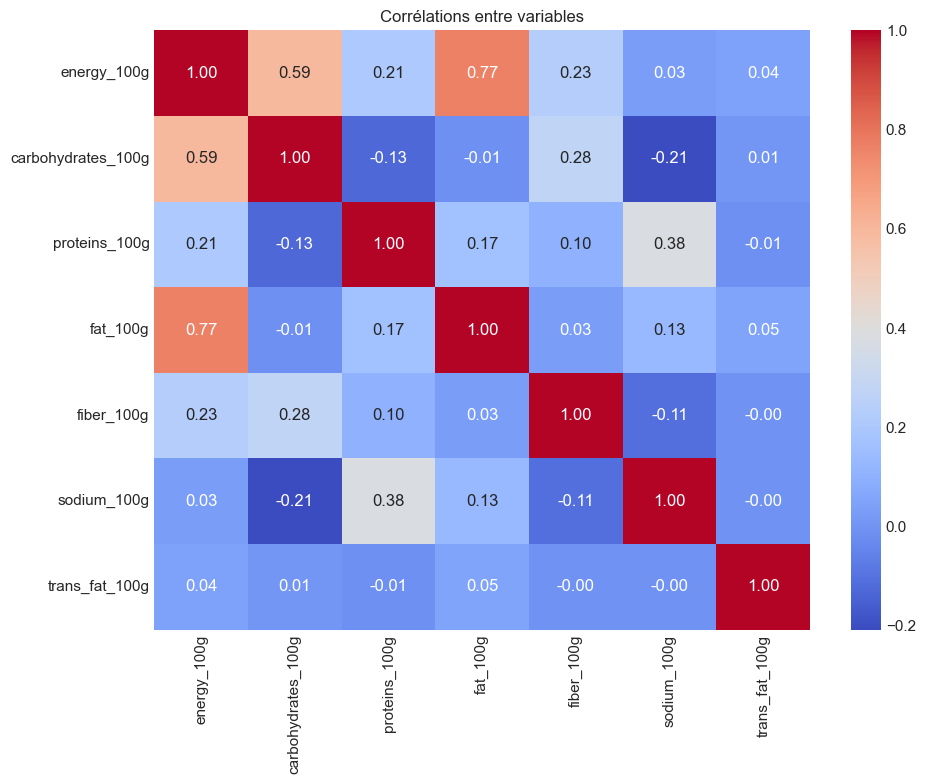

In [212]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

variables = ['energy_100g','carbohydrates_100g', 'proteins_100g', 'fat_100g', 'fiber_100g', 'sodium_100g','trans_fat_100g']

# Heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(openfoodfactLight[variables].corr(), 
            annot=True,
            cmap='coolwarm',
            fmt='.2f')
plt.title('Corrélations entre variables')
plt.tight_layout()
plt.show()

Analyse de la matrice de corrélations entre les varaibles

Corrélations fortes (>0.6) :
- Energy_100g et fat_100g (0.77) : les lipides étant très caloriques
- Energy_100g et carbohydrates_100g (0.59) : contribution notable des glucides à l'énergie

Corrélations modérées (0.2-0.4) :
- Proteins_100g et sodium_100g (0.38) : suggère des produits protéinés plus salés
- Fiber_100g et carbohydrates_100g (0.28) : lien logique entre fibres et glucides
- Energy_100g et proteins_100g (0.21)

Corrélations faibles ou négatives :
- Sodium_100g et carbohydrates_100g (-0.21) : opposition entre produits salés et sucrés
- Trans_fat_100g montre des corrélations très faibles avec tous les nutriments (<0.05)

### Boxplot

C:\Users\beche\AppData\Local\Temp\ipykernel_13992\1895651834.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
C:\Users\beche\AppData\Local\Temp\ipykernel_13992\1895651834.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')


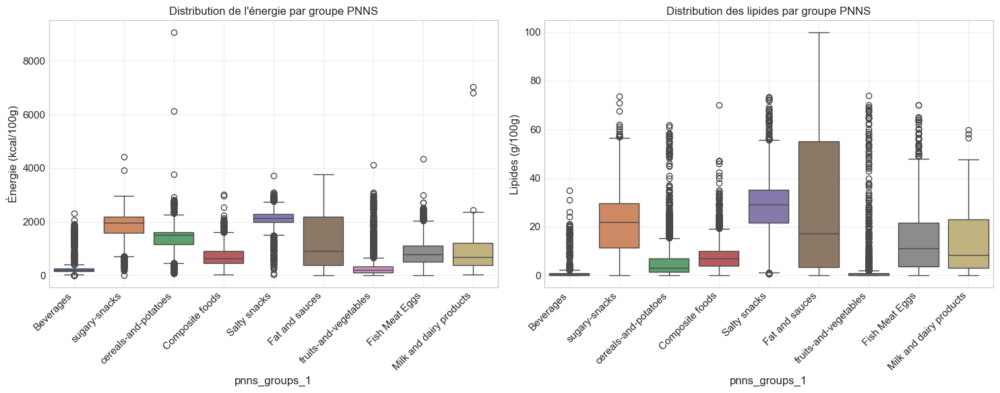

In [215]:
# Code pour la slide Énergie et Lipides
def plot_energy_fat_profiles(df):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    # Configuration commune
    def setup_box(data, y_col, ax, title):
        sns.boxplot(
            data=data,
            x='pnns_groups_1',
            y=y_col,
            hue='pnns_groups_1',  # Ajout du hue
            legend=False,         # Pas de légende
            ax=ax
        )
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
        ax.set_title(title)
        ax.grid(True, alpha=0.3)
    
    # Premier graphique - Énergie
    setup_box(
        df,
        'energy_100g',
        ax1,
        'Distribution de l\'énergie par groupe PNNS'
    )
    ax1.set_ylabel('Énergie (kcal/100g)')
    
    # Second graphique - Lipides
    setup_box(
        df,
        'fat_100g',
        ax2,
        'Distribution des lipides par groupe PNNS'
    )
    ax2.set_ylabel('Lipides (g/100g)')
    
    plt.tight_layout()
    plt.savefig('energy_fat_profiles.png', dpi=300, bbox_inches='tight')
    plt.show()

# Utilisation
plot_energy_fat_profiles(openfoodfactLight)

Distribution de l'énergie :
- sugary-snacks présente la médiane la plus élevée (~2000 kcal/100g)
- Beverages a la médiane la plus basse avec peu de dispersion
- Fat and sauces montre une grande variabilité avec de nombreux outliers
- Salty snacks présente une distribution compacte autour de 2000 kcal/100g


Distribution des lipides :
- Fat and sauces se distingue avec la médiane la plus élevée (~20g/100g)
- Fruits-and-vegetables montre la plus faible teneur en lipides
- Fish Meat Eggs présente une distribution étalée avec de nombreux outliers
- Milk and dairy products montre une variabilité modérée

A noter :
- Les deux nutriments présentent des distributions asymétriques
- Présence de nombreux outliers dans plusieurs groupes
- Les groupes montrent des profils cohérents avec leur nature (ex: graisses élevées dans "Fat and sauces")

C:\Users\beche\AppData\Local\Temp\ipykernel_13992\714750621.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
C:\Users\beche\AppData\Local\Temp\ipykernel_13992\714750621.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')


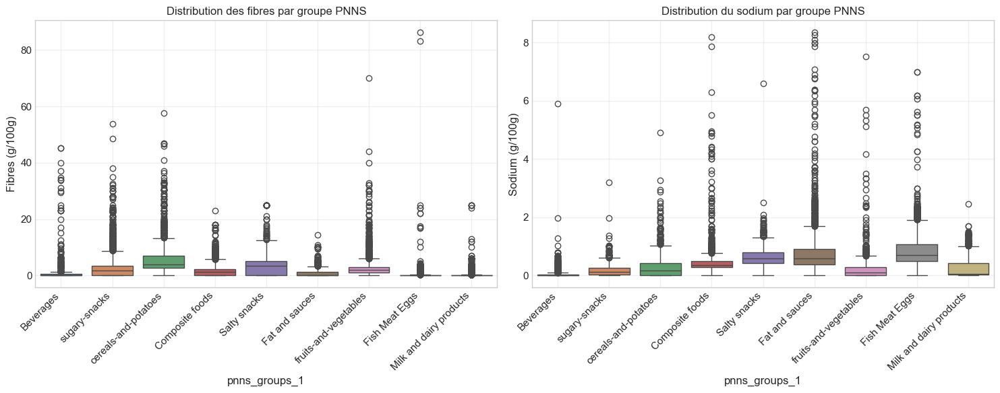

In [217]:
# Code pour la slide fbres et sodium
def plot_protein_carb_profiles(df):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    # Configuration commune
    def setup_box(data, y_col, ax, title):
        sns.boxplot(
            data=data,
            x='pnns_groups_1',
            y=y_col,
            hue='pnns_groups_1',  # Ajout du hue
            legend=False,         # Pas de légende
            ax=ax
        )
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
        ax.set_title(title)
        ax.grid(True, alpha=0.3)
    
    # Premier graphique - Protéines
    setup_box(
        df,
        'fiber_100g',
        ax1,
        'Distribution des fibres par groupe PNNS'
    )
    ax1.set_ylabel('Fibres (g/100g)')
    
    # Second graphique - Glucides
    setup_box(
        df,
        'sodium_100g',
        ax2,
        'Distribution du sodium par groupe PNNS'
    )
    ax2.set_ylabel('Sodium (g/100g)')
    
    plt.tight_layout()
    plt.savefig('sodium_carb_profiles.png', dpi=300, bbox_inches='tight')
    plt.show()

# Utilisation
plot_protein_carb_profiles(openfoodfactLight)

Distribution des fibres :
- Cereals and potatoes montre la plus forte teneur médiane (~5g/100g)
- Fruits-and-vegetables présente de nombreux outliers élevés (jusqu'à 80g/100g)
- La plupart des groupes ont une médiane basse (<2g/100g)
- Fat and sauces et Beverages ont les teneurs les plus faibles


Distribution du sodium :
- Fat and sauces et Fish Meat Eggs ont les médianes les plus élevées
- Salty snacks montre logiquement une distribution étalée avec beaucoup d'outliers
- Beverages et sugary-snacks ont les teneurs les plus faibles
- La majorité des valeurs reste sous 2g/100g, avec des outliers jusqu'à 8g/100g

A noter :
- Distributions très asymétriques pour les deux nutriments
- Nombreux outliers, particulièrement marqués pour certains groupes
- Les distributions reflètent bien la nature des différents groupes alimentaires
- La plupart des produits ont des teneurs faibles, avec quelques valeurs extrêmes

C:\Users\beche\AppData\Local\Temp\ipykernel_13992\4261057959.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
C:\Users\beche\AppData\Local\Temp\ipykernel_13992\4261057959.py:15: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')


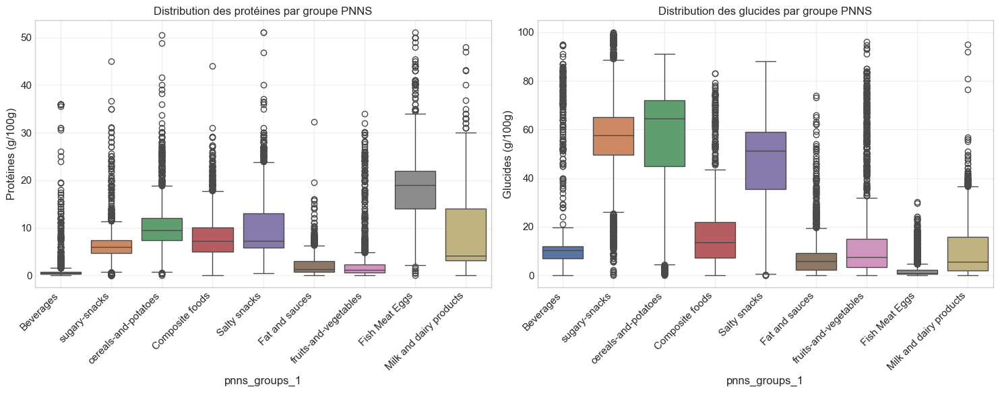

In [219]:
# Code pour la slide Protéines et Glucides
def plot_protein_carb_profiles(df):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
    
    # Configuration commune
    def setup_box(data, y_col, ax, title):
        sns.boxplot(
            data=data,
            x='pnns_groups_1',
            y=y_col,
            hue='pnns_groups_1',  # Ajout du hue
            legend=False,         # Pas de légende
            ax=ax
        )
        ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right')
        ax.set_title(title)
        ax.grid(True, alpha=0.3)
    
    # Premier graphique - Protéines
    setup_box(
        df,
        'proteins_100g',
        ax1,
        'Distribution des protéines par groupe PNNS'
    )
    ax1.set_ylabel('Protéines (g/100g)')
    
    # Second graphique - Glucides
    setup_box(
        df,
        'carbohydrates_100g',
        ax2,
        'Distribution des glucides par groupe PNNS'
    )
    ax2.set_ylabel('Glucides (g/100g)')
    
    plt.tight_layout()
    plt.savefig('protein_carb_profiles.png', dpi=300, bbox_inches='tight')
    plt.show()

# Utilisation
plot_protein_carb_profiles(openfoodfactLight)

Distribution des protéines :
- Fish Meat Eggs présente logiquement la plus forte teneur (médiane ~20g/100g)
- Milk and dairy products en seconde position (médiane ~10g/100g)
- Fat and sauces et Beverages montrent les teneurs les plus faibles
- Nombreux outliers dans plusieurs groupes, notamment Fish Meat Eggs

Distribution des glucides :
- Cereals and potatoes et sugary-snacks dominent (médianes ~50-60g/100g)
- Fish Meat Eggs et Fat and sauces ont les teneurs les plus faibles
- Salty snacks montre une distribution étalée (20-60g/100g)
- Fruits-and-vegetables présente une distribution variée avec de nombreux outliers

A noter :
- Les distributions sont généralement asymétriques
- Les profils nutritionnels correspondent aux attentes pour chaque groupe
- Présence systématique d'outliers, reflétant la diversité des produits dans chaque catégorie

Synthèse

Tendances principales par groupe :
- Fat and sauces : Riches en lipides, sodium, faibles en fibres
- Sugary-snacks : Forte teneur en énergie et glucides, faibles en protéines
- Fish Meat Eggs : Riches en protéines, pauvres en glucides
- Cereals and potatoes : Équilibrés en glucides et fibres
- Fruits-and-vegetables : Généralement faibles en énergie, quelques outliers en fibres

Caractéristiques des distributions :
- Asymétrie positive prononcée pour tous les nutriments
- Présence systématique d'outliers
- Grande variabilité intra-groupe pour certains nutriments

A noter :
- Cohérence entre compositions et catégories d'aliments
- Complémentarité nutritionnelle entre groupes
- Certains groupes montrent des profils nutritionnels très distinctifs

### Analyse des distributions par violin plot 

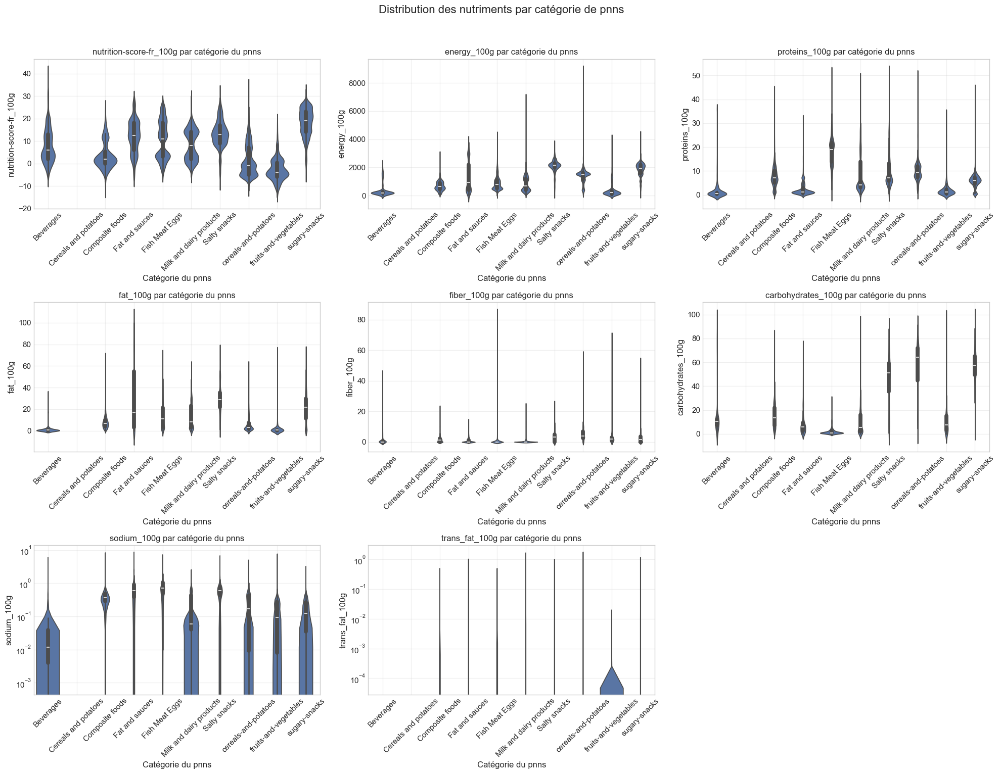

In [223]:
import math

# variables par catégorie
variable_categories = {
    'Nutrition Score': ['nutrition-score-fr_100g'],
    'Énergie': ['energy_100g'],
    'Macronutriments': ['proteins_100g', 'fat_100g', 'fiber_100g', 'carbohydrates_100g'],
    'Micronutriments': ['sodium_100g','trans_fat_100g']
    
}

# Aplatie la liste des variables
all_variables = [item for sublist in variable_categories.values() for item in sublist]

# Fonction pour tracer les violons avec l'échelle appropriée(log pour micronutriments)
def plot_violin(data, var, ax, is_micro=False):
    sns.violinplot(data=data, 
                   x='pnns_groups_1', 
                   y=var,
                   order=['Beverages', 
                          'Cereals and potatoes', 
                          'Composite foods', 
                          'Fat and sauces', 
                          'Fish Meat Eggs', 
                          'Milk and dairy products', 
                          'Salty snacks', 
                          'cereals-and-potatoes', 
                          'fruits-and-vegetables', 
                          'sugary-snacks'
                         ], 
                   ax=ax)
    
    ax.set_title(f'{var} par catégorie du pnns')
    ax.set_xlabel('Catégorie du pnns')
    ax.set_ylabel(var)
    ax.grid(True, alpha=0.3)
    
    if is_micro:
        ax.set_yscale('log')
    
    # Définir explicitement les ticks et leurs labels
    ax.set_xticks(range(10))
    ax.set_xticklabels(['Beverages', 
                          'Cereals and potatoes', 
                          'Composite foods', 
                          'Fat and sauces', 
                          'Fish Meat Eggs', 
                          'Milk and dairy products', 
                          'Salty snacks', 
                          'cereals-and-potatoes', 
                          'fruits-and-vegetables', 
                          'sugary-snacks'
                       ], rotation=45)

# Calcule le nombre de lignes nécessaires
n_variables = len(all_variables)
n_rows = math.ceil(n_variables / 3)

# Crée des violins plots pour chaque variable numérique vs nutrition_grade_fr
fig, axes = plt.subplots(n_rows, 3, figsize=(20, 5*n_rows))
fig.suptitle('Distribution des nutriments par catégorie de pnns', fontsize=16, y=1.02)

for idx, var in enumerate(all_variables):
    row = idx // 3
    col = idx % 3
    
    is_micro = var in variable_categories['Micronutriments']
    
    try:
        if n_rows > 1:
            plot_violin(openfoodfactLight, var, axes[row, col], is_micro)
        else:
            plot_violin(openfoodfactLight, var, axes[col], is_micro)
    except Exception as e:
        print(f"Erreur lors du tracé de {var}: {e}")
        if n_rows > 1:
            axes[row, col].text(0.5, 0.5, f"Erreur: {var} non disponible", ha='center', va='center')
        else:
            axes[col].text(0.5, 0.5, f"Erreur: {var} non disponible", ha='center', va='center')

# Supprime les sous-graphiques vides
for idx in range(n_variables, n_rows*3):
    row = idx // 3
    col = idx % 3
    if n_rows > 1:
        fig.delaxes(axes[row, col])
    else:
        fig.delaxes(axes[col])

plt.tight_layout()

plt.show()


Score nutritionnel et Énergie :
- Distribution la plus étalée pour les sugary-snacks
- Beverages montre une concentration vers les valeurs basses
- Fat and sauces présente une grande variabilité


Macronutriments :
- Protéines : Pic marqué pour Fish Meat Eggs
- Lipides : Distribution large pour Fat and sauces
- Glucides : Forte concentration pour Cereals and potatoes et sugary-snacks
- Fibres : Distributions généralement resserrées, avec quelques valeurs extrêmes


Sodium et acides gras trans (échelle log) :
- Sodium : Grande variabilité dans Salty snacks et Fat and sauces
- Trans_fat : Très peu de données, distributions peu informatives

Les violin plots révèlent efficacement :
- La forme des distributions pour chaque groupe
- Les concentrations des valeurs (largeur des violons)
- Les différences de dispersion entre groupes
- Les asymétries dans les distributions

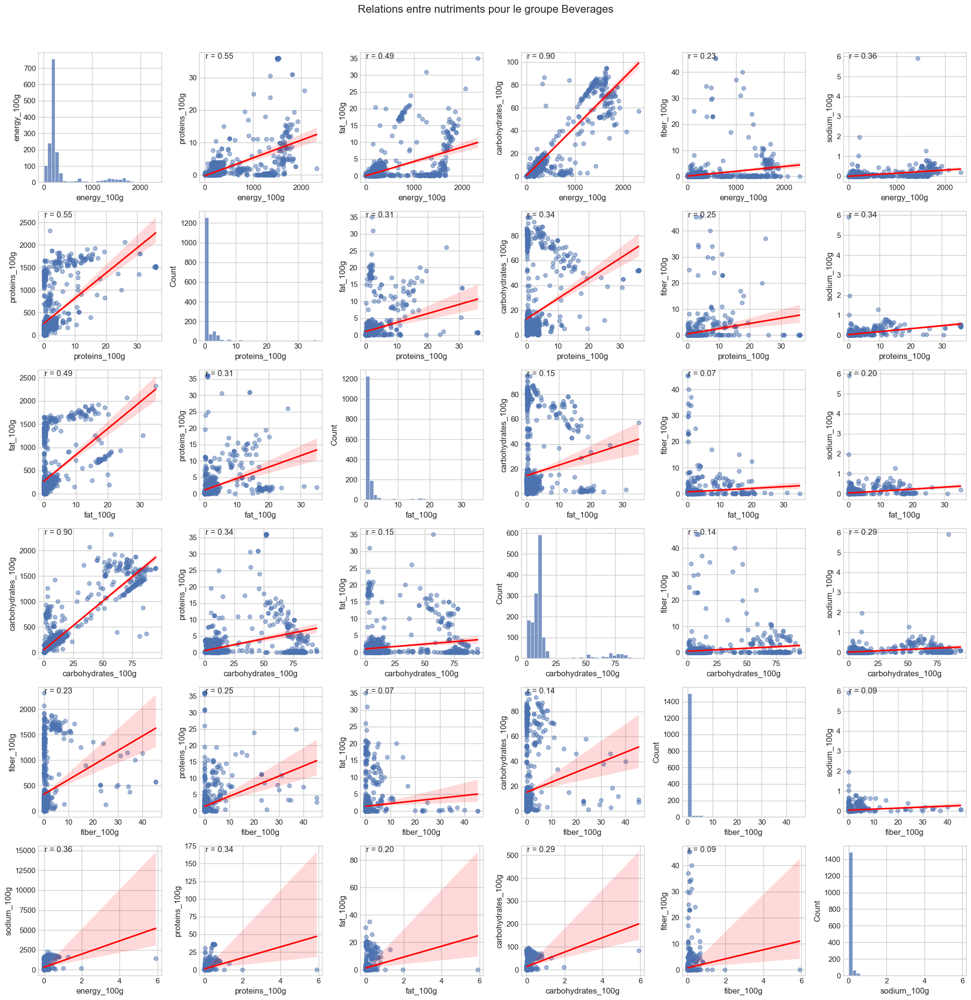

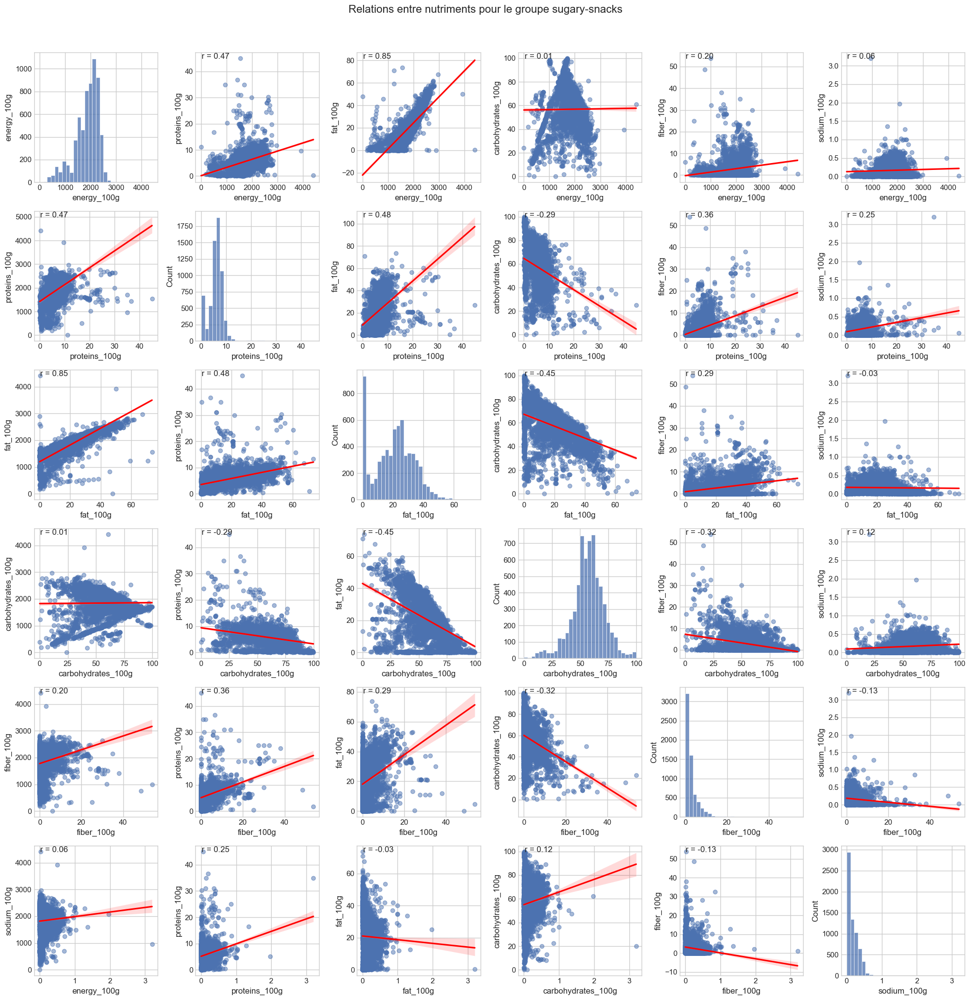

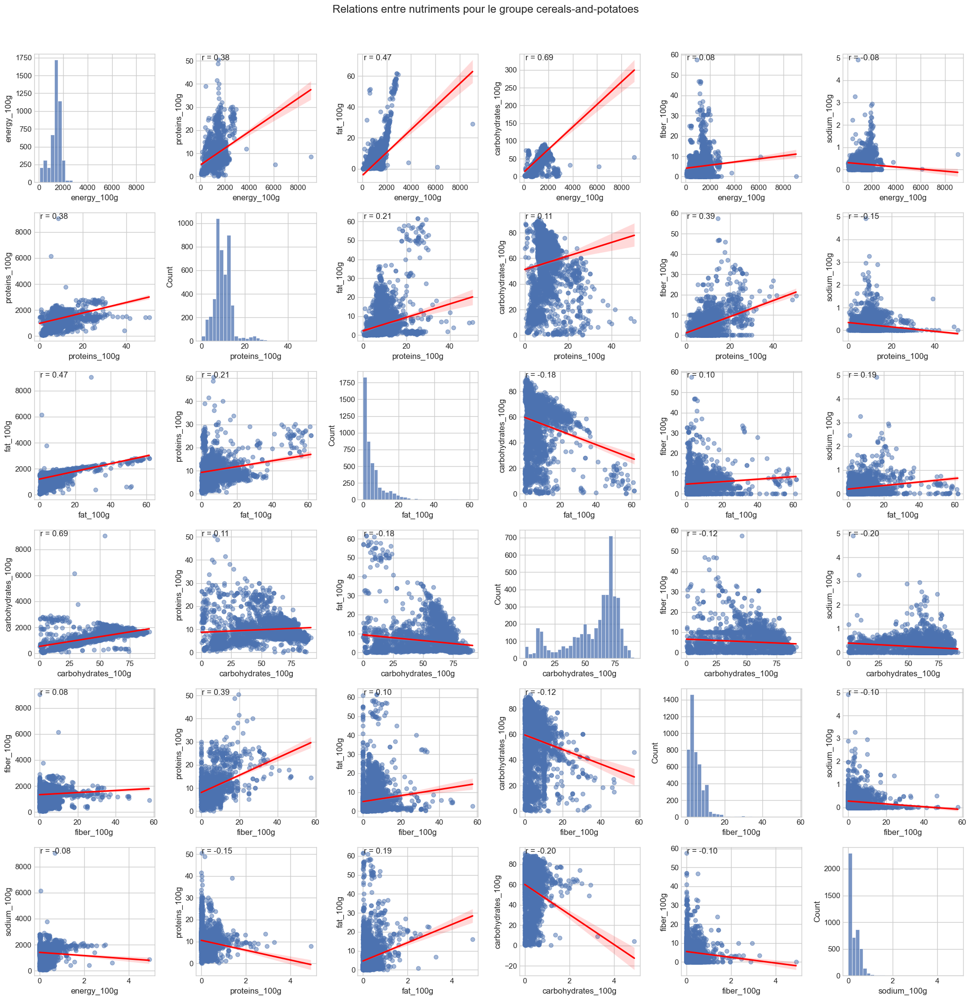

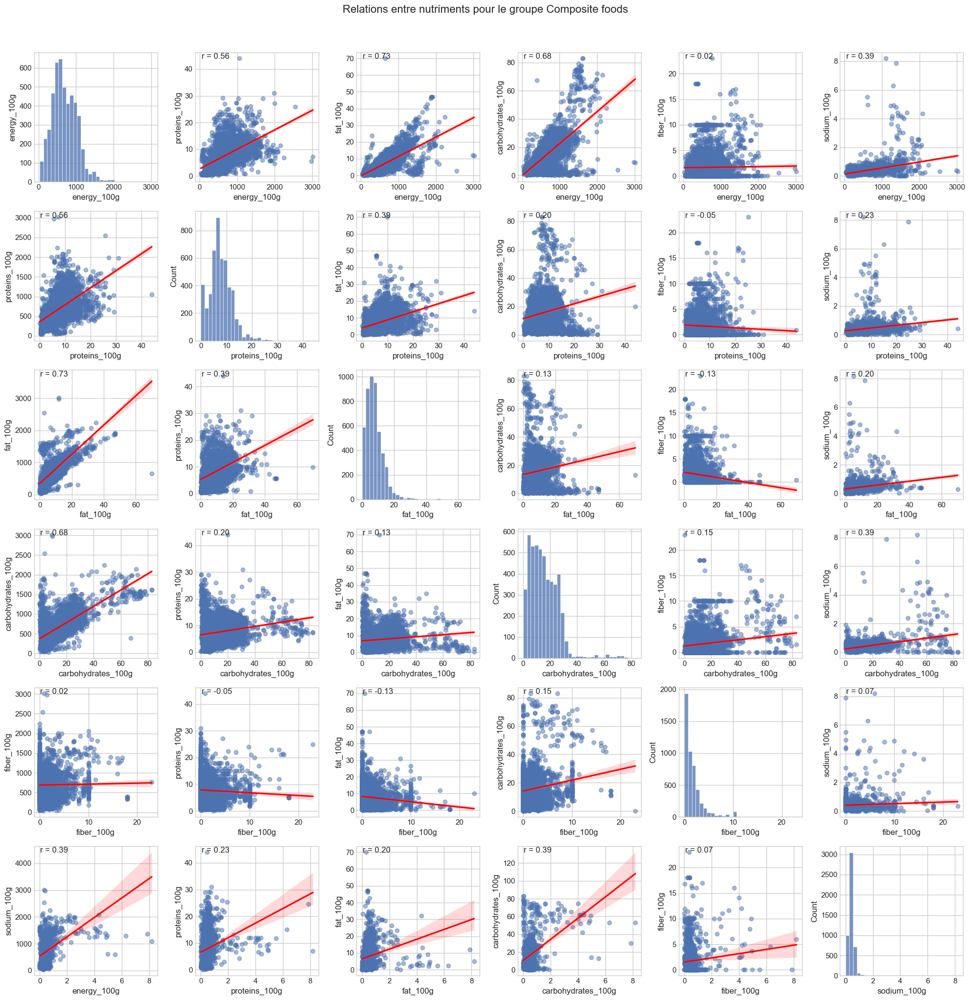

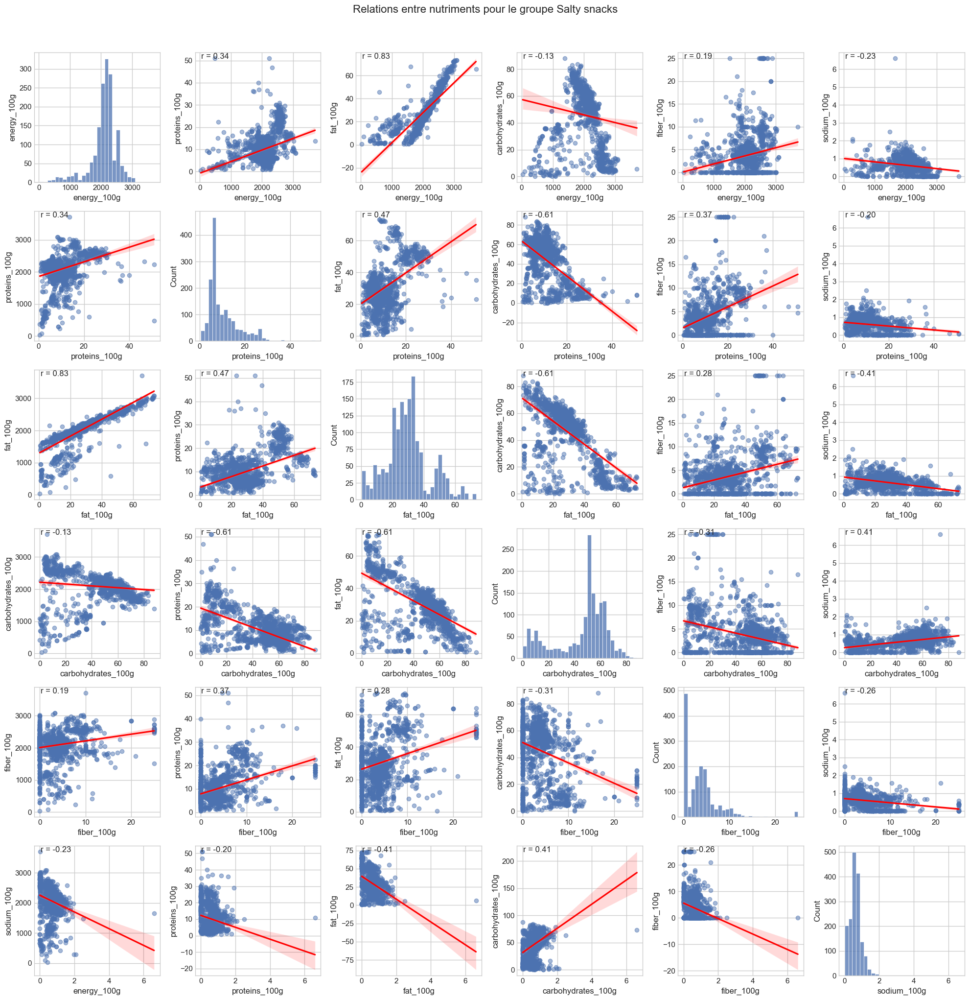

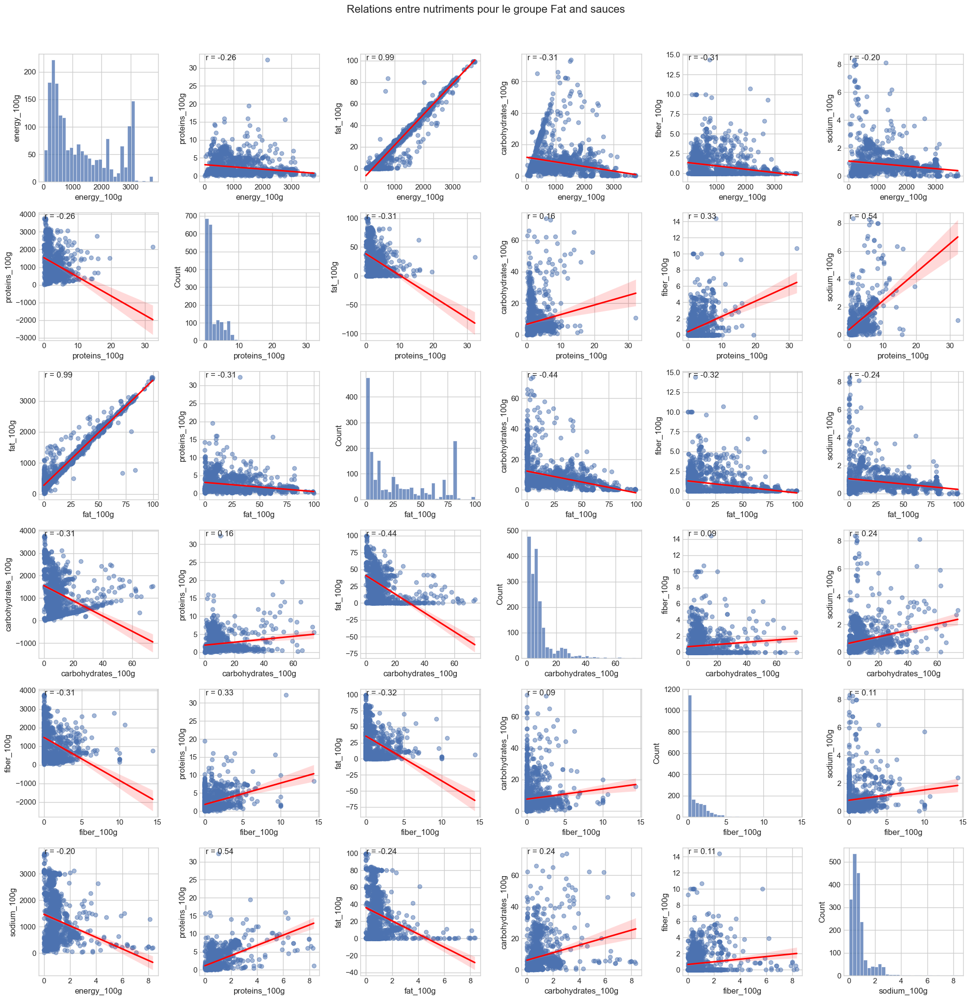

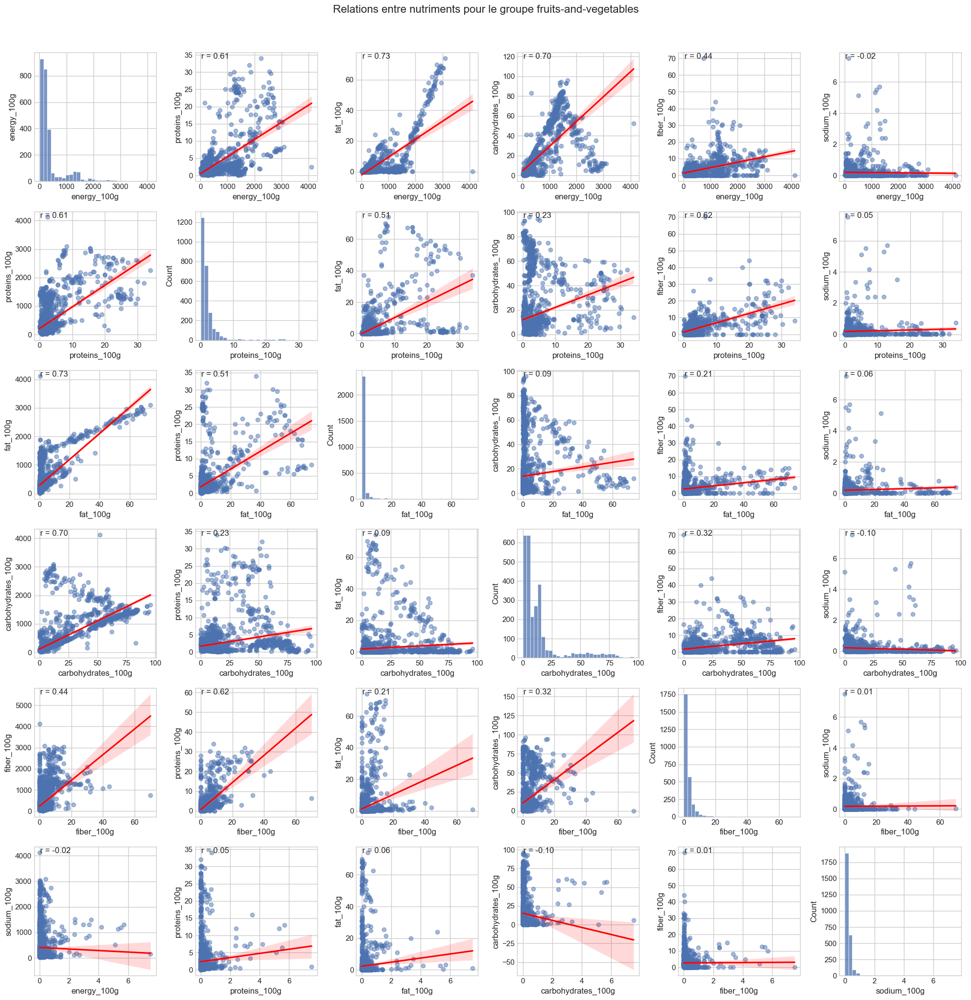

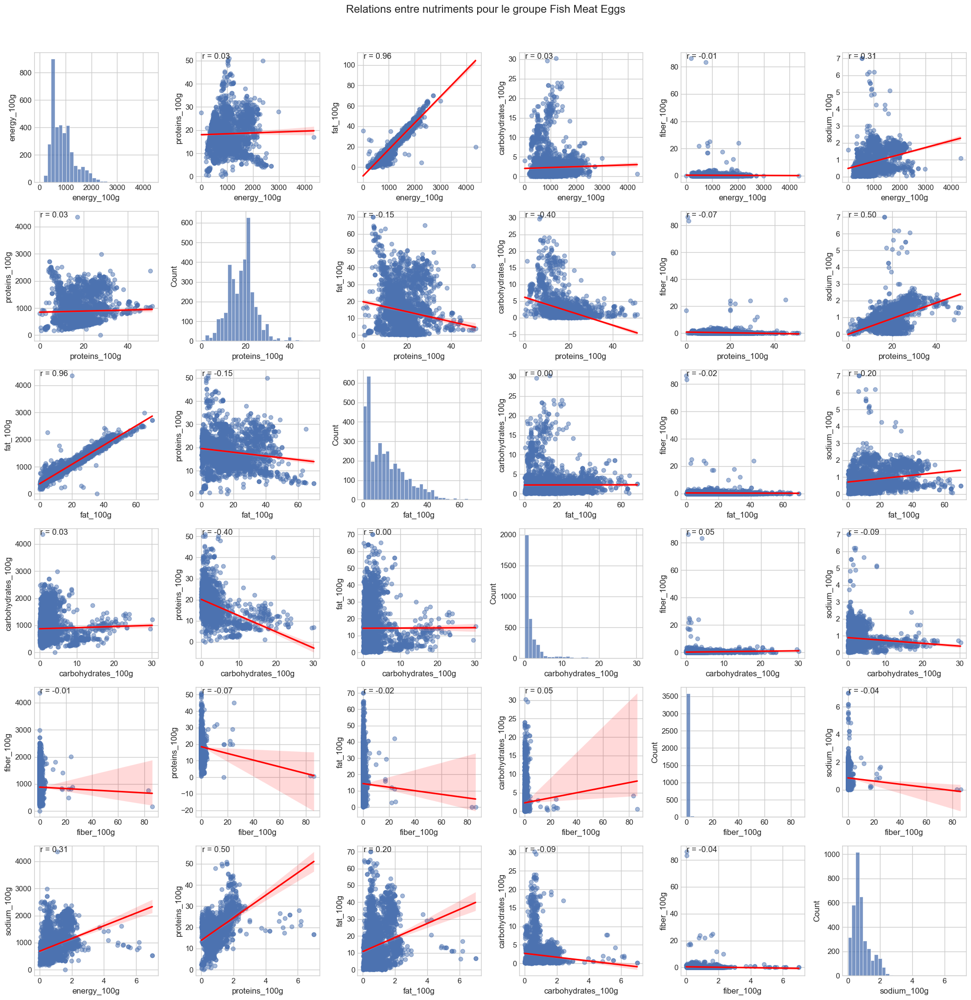

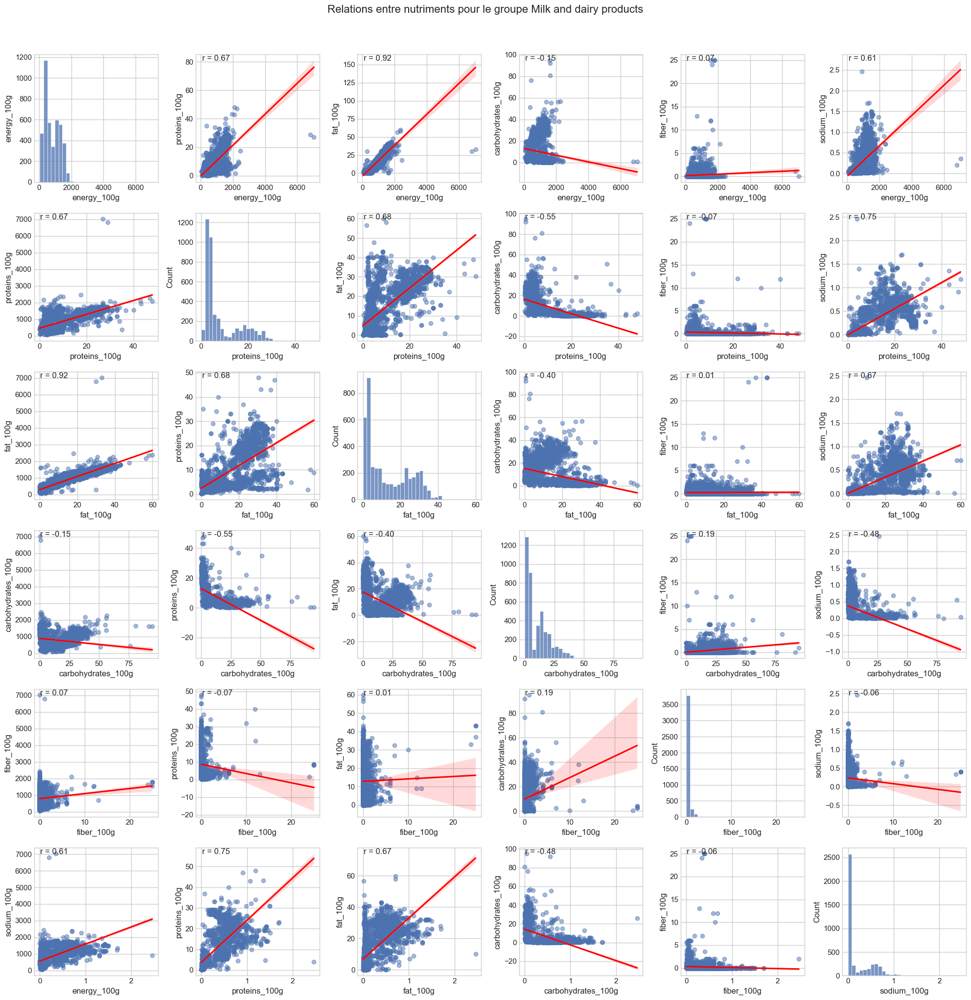

In [225]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

def plot_nutrient_relationships(df, nutriments, pnns_group, palette='husl'):
    # Création d'un subplot pour chaque paire de nutriments
    n_nutriments = len(nutriments)
    fig, axes = plt.subplots(n_nutriments, n_nutriments, figsize=(20, 20))
    plt.suptitle(f'Relations entre nutriments pour le groupe {pnns_group}', y=1.02, fontsize=16)
    
    # Filtrer les données pour le groupe PNNS spécifique
    data = df[df['pnns_groups_1'] == pnns_group]
    
    # Créer les plots pour chaque paire de nutriments
    for i, nut1 in enumerate(nutriments):
        for j, nut2 in enumerate(nutriments):
            if i != j:
                # Scatter plot avec ligne de régression
                sns.regplot(data=data, x=nut1, y=nut2, ax=axes[i, j], 
                          scatter_kws={'alpha':0.5}, line_kws={'color': 'red'})
                
                # Calculer la corrélation
                corr = data[nut1].corr(data[nut2])
                axes[i, j].text(0.05, 0.95, f'r = {corr:.2f}', 
                              transform=axes[i, j].transAxes)
            else:
                # Histogramme sur la diagonale
                sns.histplot(data=data[nut1], ax=axes[i, j], bins=30)
            
            # Ajuster les labels
            if i == n_nutriments-1:
                axes[i, j].set_xlabel(nut2)
            if j == 0:
                axes[i, j].set_ylabel(nut1)
                
    plt.tight_layout()
    plt.show()

# Liste des nutriments à analyser
nutriments = ['energy_100g', 'proteins_100g', 'fat_100g', 
              'carbohydrates_100g', 'fiber_100g', 'sodium_100g']

# Pour chaque groupe PNNS
for group in openfoodfactLight['pnns_groups_1'].unique():
    plot_nutrient_relationships(openfoodfactLight, nutriments, group)

ces graphiques fournissent trop d'informations, procedons différement ...

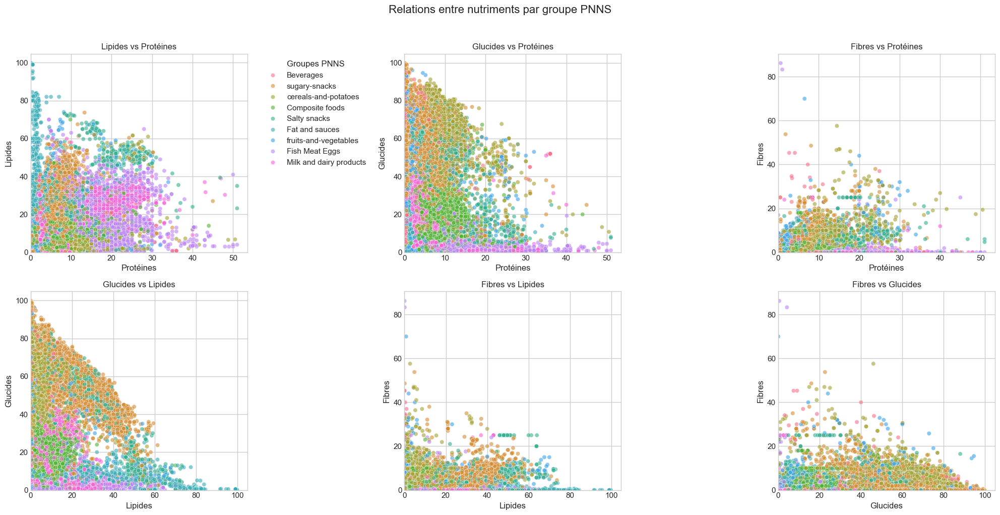

In [227]:
# Graphique Relations entre les principaux nutriments par groupe PNNS
import seaborn as sns
import matplotlib.pyplot as plt
import itertools

def create_nutrient_relationships_plot(df, nutrients_dict):
    # Générer toutes les combinaisons possibles de nutriments
    comparisons = list(itertools.combinations(nutrients_dict.items(), 2))
    n_comparisons = len(comparisons)
    
    # Calculer le nombre de lignes et colonnes nécessaires
    n_cols = 3  # ou autre nombre selon préférence
    n_rows = (n_comparisons + n_cols - 1) // n_cols
    
    # Créer la figure
    fig = plt.figure(figsize=(20, 5*n_rows))
    plt.suptitle('Relations entre nutriments par groupe PNNS', fontsize=16, y=1.02)
    
    # Créer les subplots
    for idx, ((x_var, x_label), (y_var, y_label)) in enumerate(comparisons, 1):
        ax = plt.subplot(n_rows, n_cols, idx)
        
        # Créer le scatter plot
        sns.scatterplot(
            data=df,
            x=x_var,
            y=y_var,
            hue='pnns_groups_1',
            palette='husl',
            alpha=0.6,
            ax=ax
        )
        
        # Configurer le subplot
        ax.set_title(f'{y_label} vs {x_label}')
        ax.set_xlabel(x_label)
        ax.set_ylabel(y_label)
        
        # Gérer la légende
        if idx == 1:  # Garder une seule légende
            ax.legend(title='Groupes PNNS', 
                     bbox_to_anchor=(1.05, 1),
                     loc='upper left')
        else:
            ax.get_legend().remove()
            
        # Ajuster les limites des axes si nécessaire
        ax.set_xlim(left=0)
        ax.set_ylim(bottom=0)
    
    plt.tight_layout()
    plt.show()
    plt.close()

# Dictionnaire des nutriments avec leurs labels
variables = {
    'proteins_100g': 'Protéines',
    'fat_100g': 'Lipides',
    'carbohydrates_100g': 'Glucides',
    'fiber_100g': 'Fibres',
}

# Créer le graphique
create_nutrient_relationships_plot(openfoodfactLight, variables)

Relations avec l'énergie :
- Lipides vs Énergie : Corrélation positive forte (0.77), particulièrement pour Fat and sauces
- Glucides vs Énergie : Corrélation positive modérée (0.59), marquée pour Cereals and potatoes
- Protéines vs Énergie : Corrélation faible (0.21), plus visible dans Fish Meat Eggs
- Fibres/Sodium vs Énergie : Corrélations très faibles


Relations entre macronutriments :
- Lipides vs Glucides : Corrélation négative, suggérant une compensation
- Protéines vs Lipides : Distribution dispersée, sans tendance claire
- Protéines vs Glucides : Légère corrélation négative


Particularités par groupe :
- Beverages : Concentré dans les zones de faibles valeurs
- Fat and sauces : Valeurs élevées en lipides
- Cereals and potatoes : Dominance en glucides
- Fish Meat Eggs : Concentration en protéines


Relations avec micronutriments :
- Sodium : Corrélations faibles avec tous les nutriments
- Fibres : Principalement liées aux glucides, surtout dans Cereals and potatoes

Cette visualisation met en évidence les profils nutritionnels distincts de chaque groupe PNNS et les interactions complexes entre nutriments.

<Figure size 1200x1000 with 0 Axes>

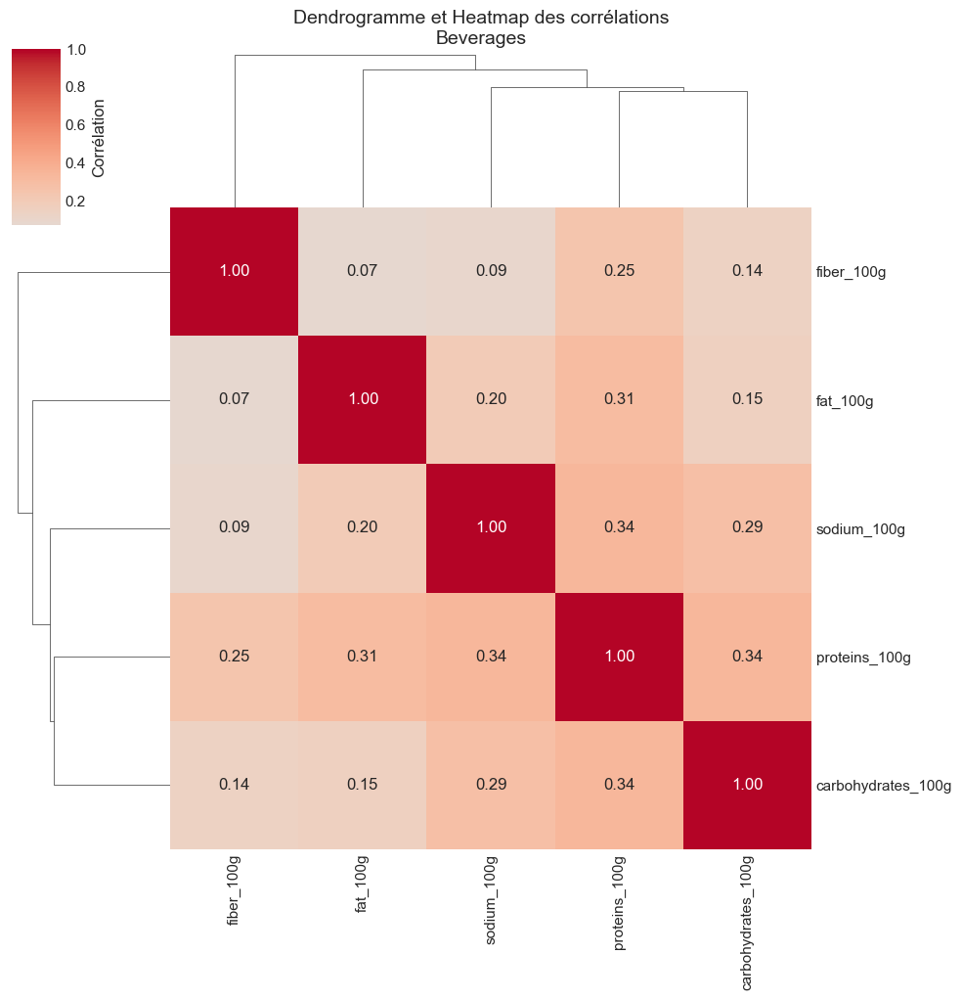

<Figure size 1200x1000 with 0 Axes>

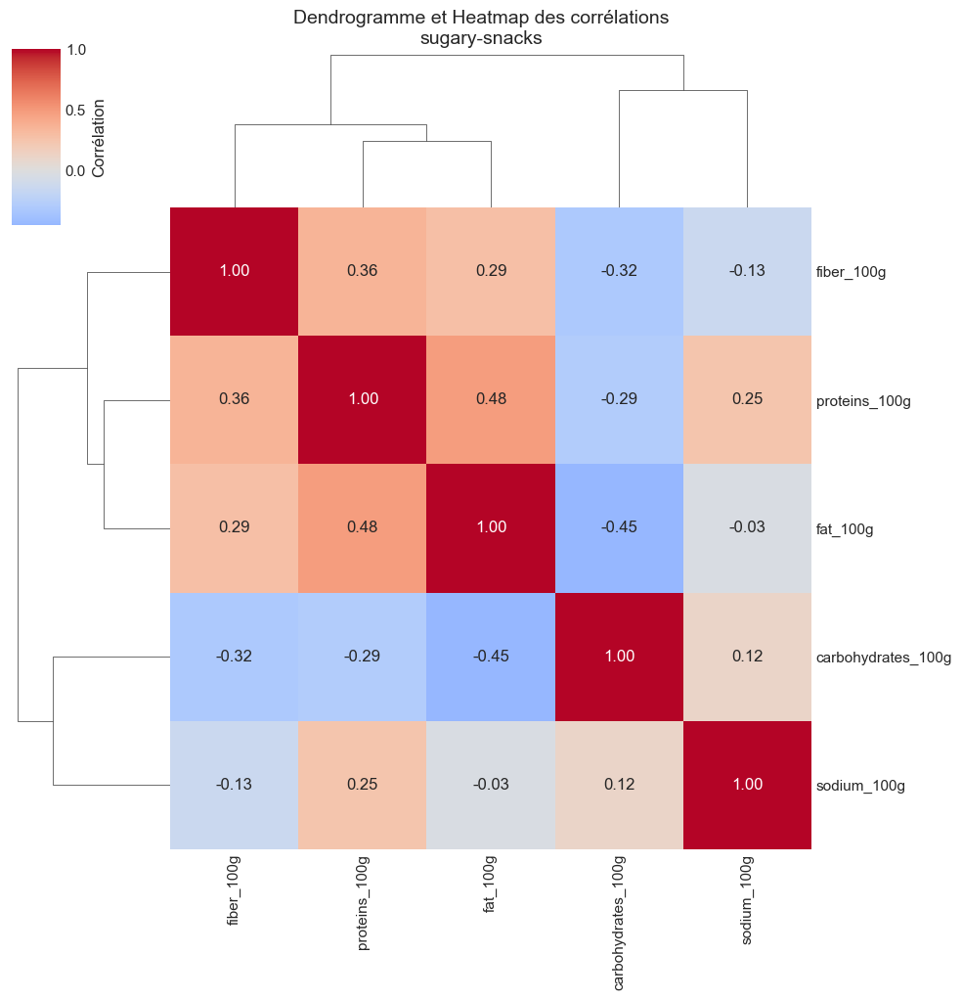

<Figure size 1200x1000 with 0 Axes>

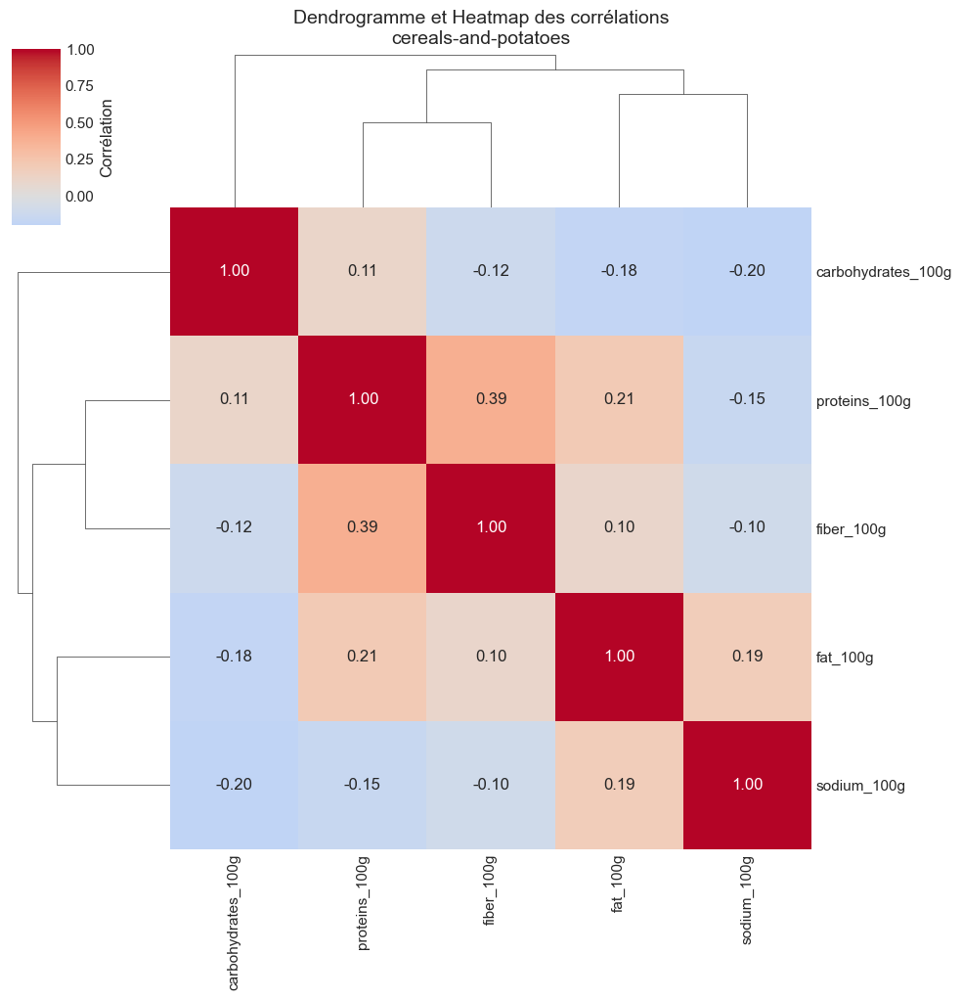

<Figure size 1200x1000 with 0 Axes>

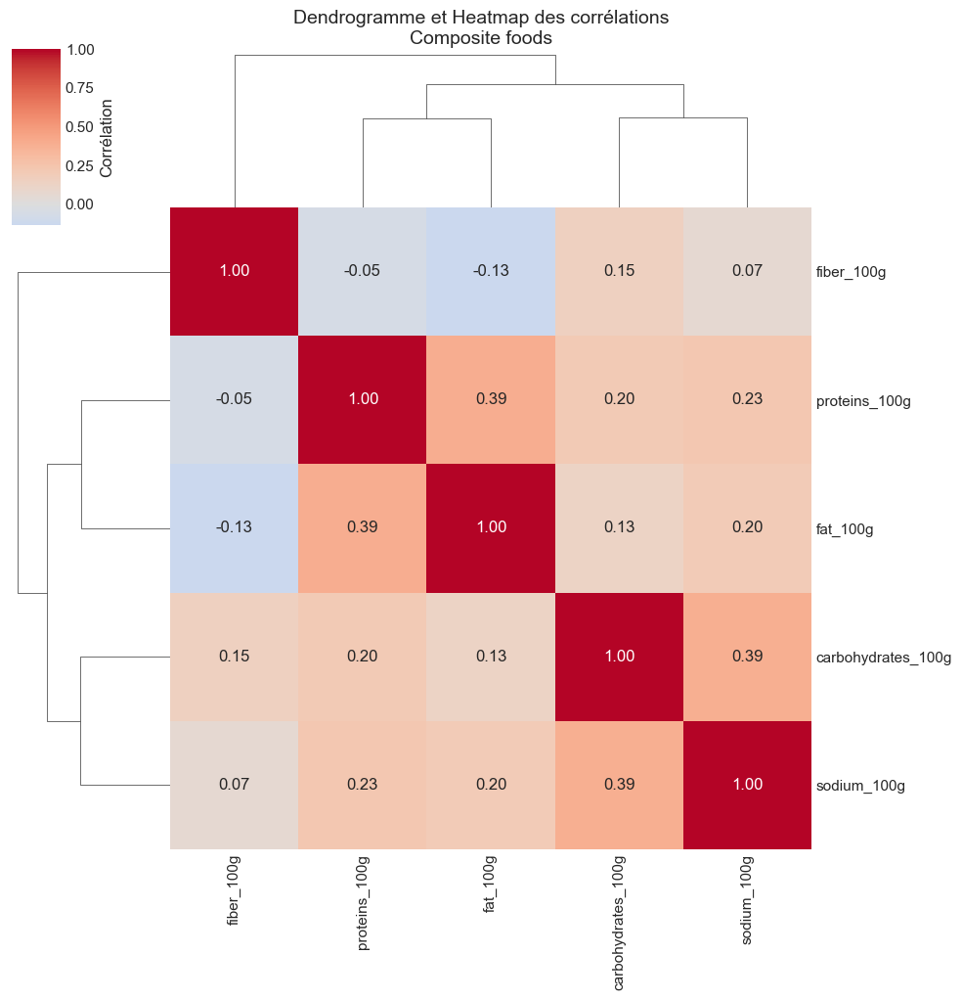

<Figure size 1200x1000 with 0 Axes>

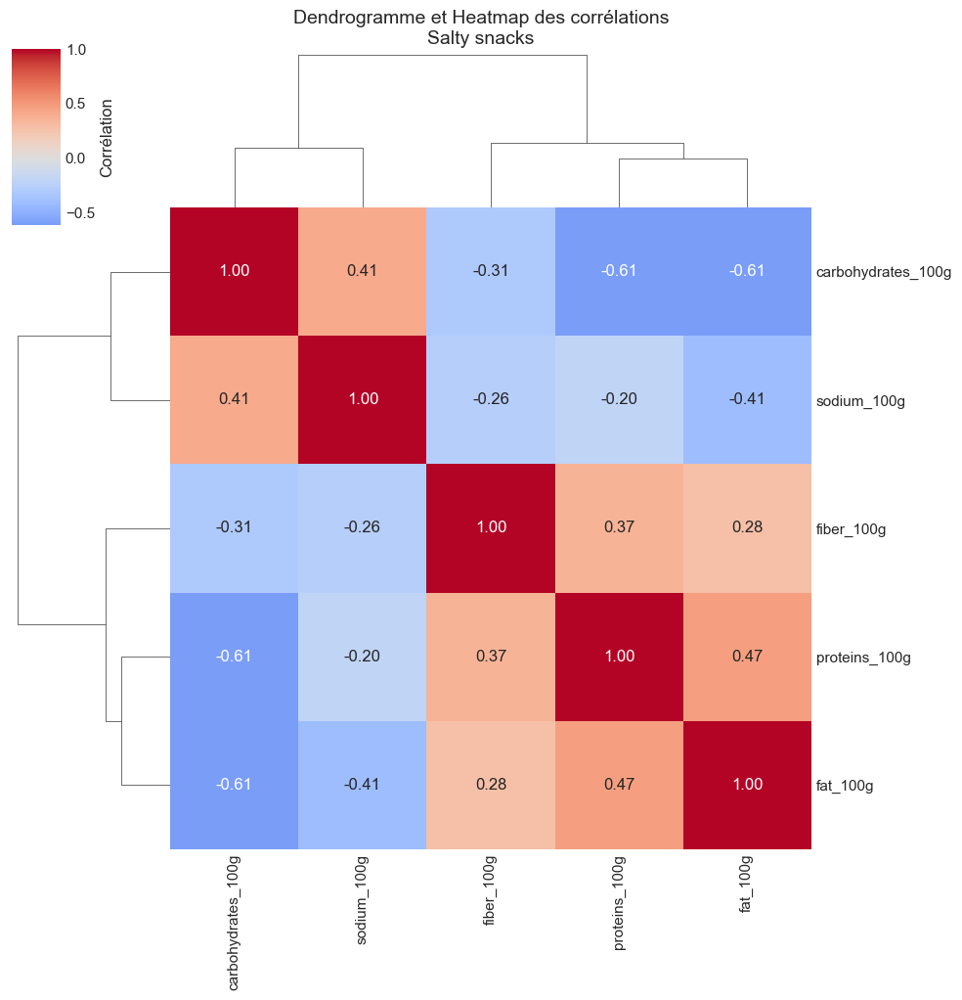

<Figure size 1200x1000 with 0 Axes>

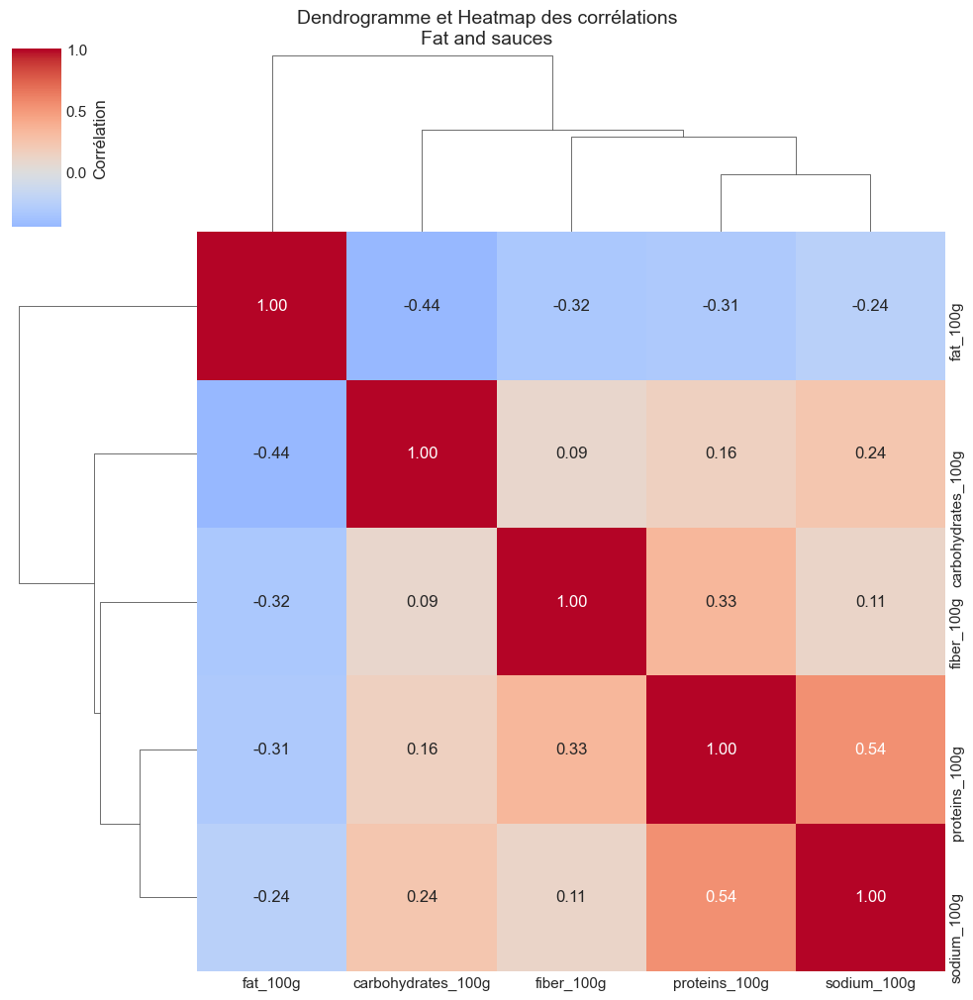

<Figure size 1200x1000 with 0 Axes>

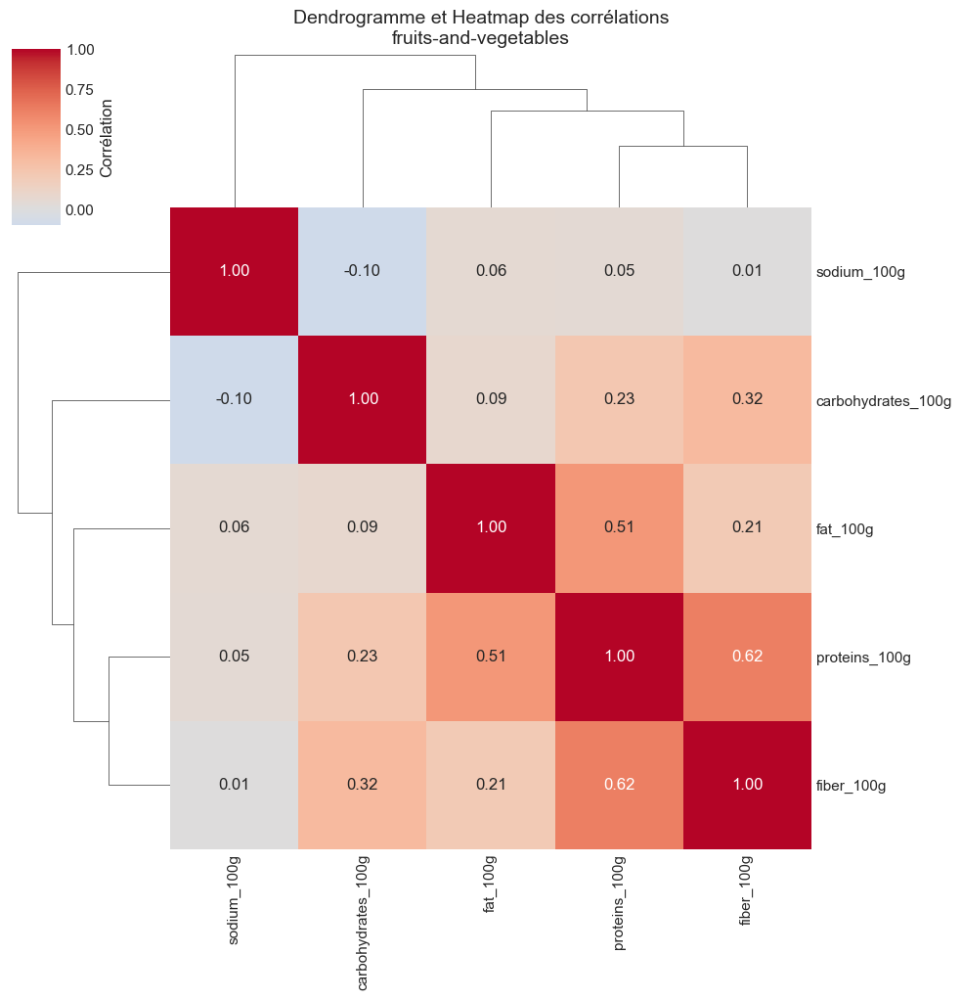

<Figure size 1200x1000 with 0 Axes>

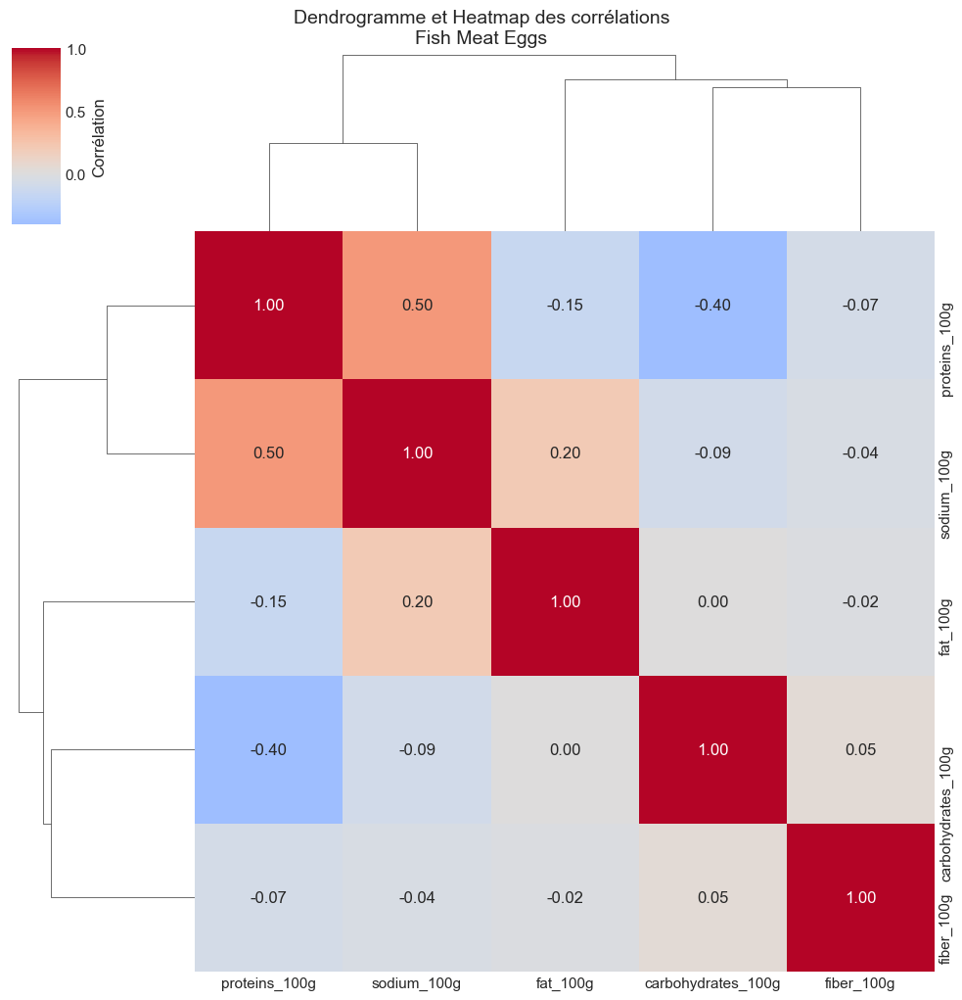

<Figure size 1200x1000 with 0 Axes>

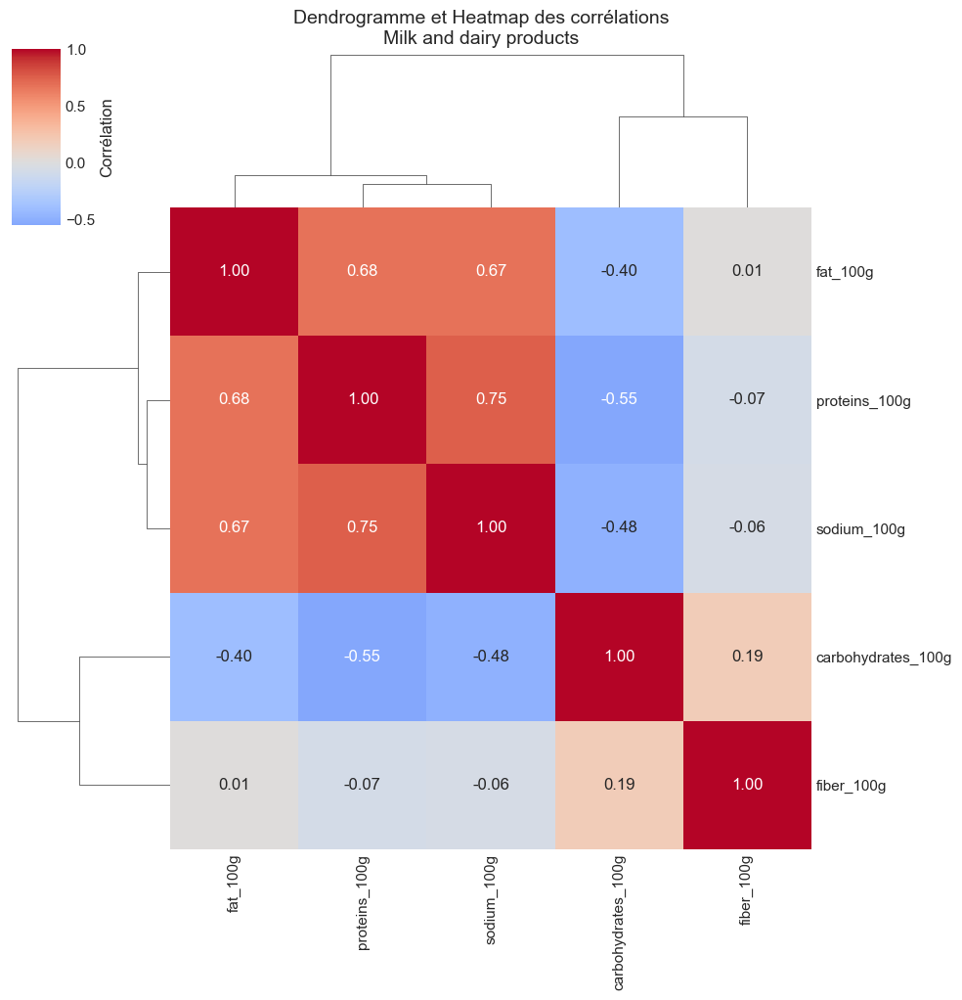

<Figure size 1200x1000 with 0 Axes>

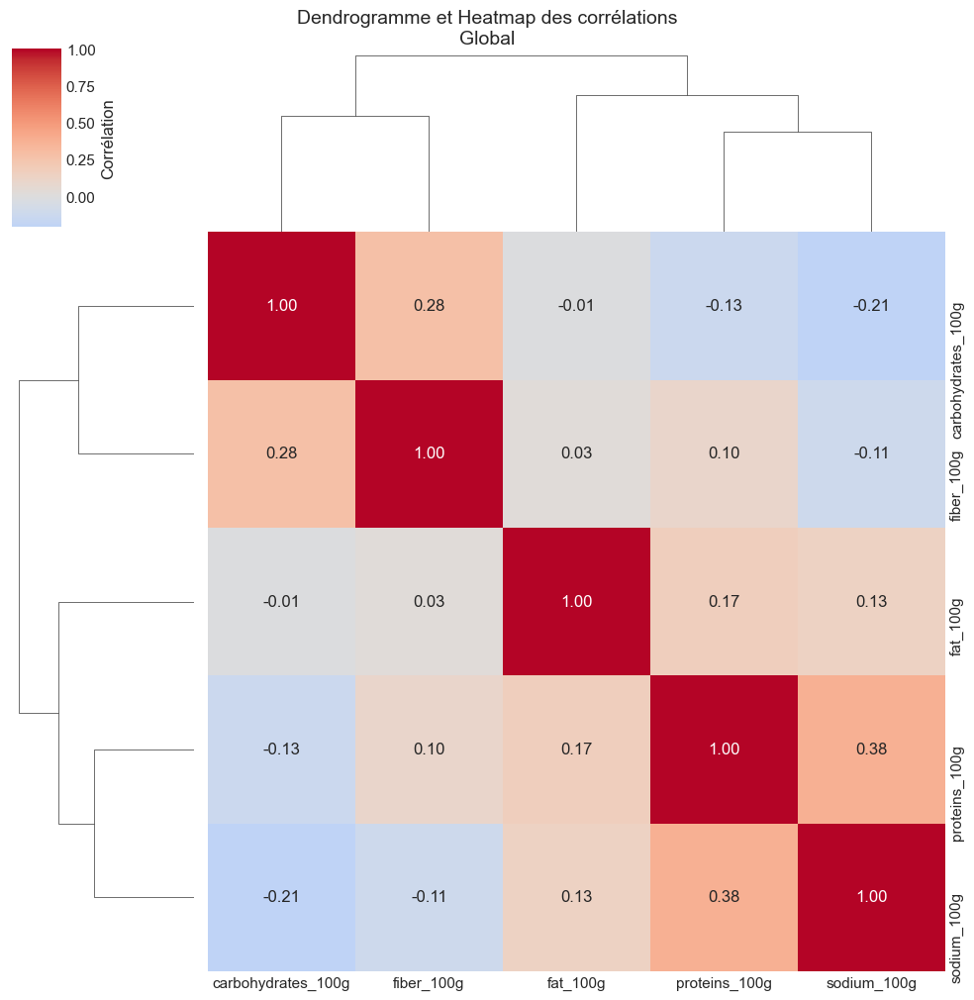

In [229]:
from scipy.cluster import hierarchy
import seaborn as sns
import matplotlib.pyplot as plt

def plot_dendrogram_heatmap(df, pnns_group, nutrients):
    """
    Crée un dendrogramme avec heatmap pour un groupe PNNS.
    """
    # Filtrer les données pour le groupe PNNS
    if pnns_group:
        data = df[df['pnns_groups_1'] == pnns_group]
    else:
        data = df
    
    # Calculer la matrice de corrélation
    corr_matrix = data[nutrients].corr()
    
    # Créer la figure
    plt.figure(figsize=(12, 10))
    
    # Calculer les liens pour le dendrogramme
    row_linkage = hierarchy.linkage(
        hierarchy.distance.pdist(corr_matrix),
        method='average'
    )
    
    # Créer le clustered heatmap
    sns.clustermap(corr_matrix,
                  row_linkage=row_linkage,
                  col_linkage=row_linkage,
                  cmap='coolwarm',
                  center=0,
                  annot=True,
                  fmt='.2f',
                  cbar_kws={'label': 'Corrélation'})
    
    plt.suptitle(f'Dendrogramme et Heatmap des corrélations\n{pnns_group if pnns_group else "Global"}',
                 y=1.02, fontsize=14)
    
    return plt.gcf()

# Liste des nutriments
variables = [
    'proteins_100g',
    'fat_100g',
    'carbohydrates_100g',
    'fiber_100g',
    'sodium_100g'
]

# Créer un graphique pour chaque groupe PNNS
for pnns_group in openfoodfactLight['pnns_groups_1'].unique():
    fig = plot_dendrogram_heatmap(openfoodfactLight, pnns_group, variables)
    plt.show()
    plt.close()

# Graphique global
fig = plot_dendrogram_heatmap(openfoodfactLight, None, variables)
plt.show()
plt.close()


## Analyses multivariées

### Analyse ACP

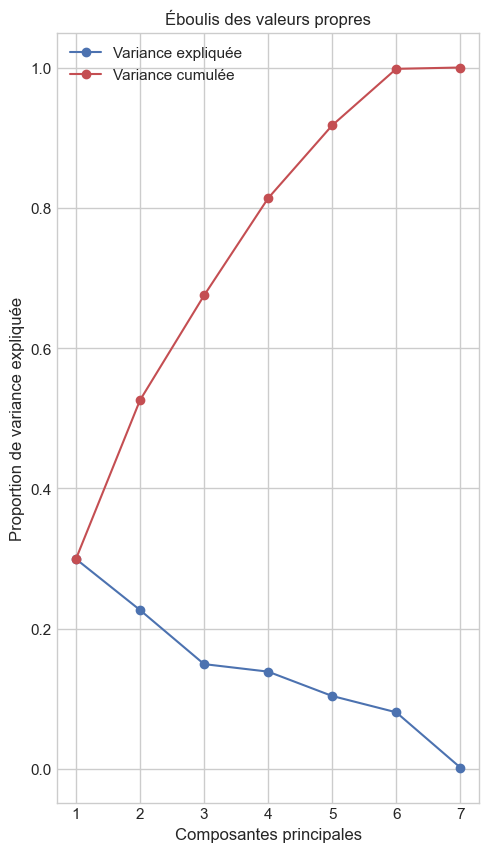

In [232]:
# Importation des bibliothèques nécessaires
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA


variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

# Préparation des données pour l'ACP
X = openfoodfactLight[variables]

# Standardisation des données
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Création et ajustement de l'ACP
pca = PCA()
X_pca = pca.fit_transform(X_scaled)

# Calcul de la variance expliquée
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance_ratio = np.cumsum(explained_variance_ratio)

# Eéboulis des valeurs propres (Scree plot)
plt.figure(figsize=(12, 10))
plt.subplot(1, 2, 1)
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, 'bo-')
plt.plot(range(1, len(cumulative_variance_ratio) + 1), cumulative_variance_ratio, 'ro-')
plt.xlabel('Composantes principales')
plt.ylabel('Proportion de variance expliquée')
plt.title('Éboulis des valeurs propres')
plt.legend(['Variance expliquée', 'Variance cumulée'])
plt.grid(True)


In [233]:
# Statistiques
print("\nVariance expliquée par composante :")
for i, var in enumerate(explained_variance_ratio[:4]):
    print(f"PC{i+1}: {var:.1%}")

print("\nVariance expliquée cumulée :")
for i, var in enumerate(cumulative_variance_ratio[:4]):
    print(f"PC1 à PC{i+1}: {var:.1%}")


Variance expliquée par composante :
PC1: 29.9%
PC2: 22.6%
PC3: 14.9%
PC4: 13.9%

Variance expliquée cumulée :
PC1 à PC1: 29.9%
PC1 à PC2: 52.6%
PC1 à PC3: 67.5%
PC1 à PC4: 81.4%


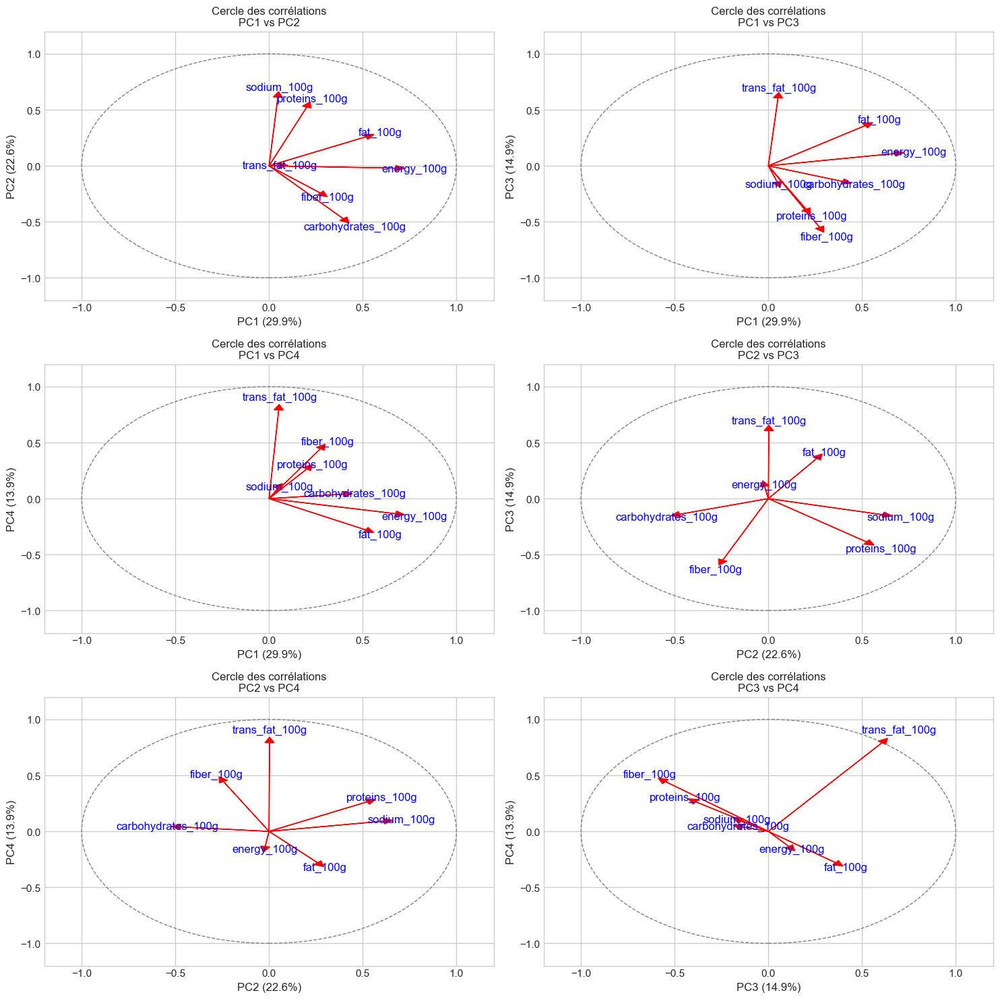

In [234]:
def plot_correlation_circles(pca, features, n_components=4):
   """
   Crée les cercles de corrélation pour toutes les paires de composantes pertinentes.
   
   Args:
       pca: Objet PCA déjà ajusté
       features: Liste des noms de variables
       n_components: Nombre de composantes à considérer
   """
   
   # Calcul du nombre de paires de composantes
   n_pairs = (n_components * (n_components - 1)) // 2
   
   # Calcul du nombre de lignes/colonnes pour le subplot
   n_cols = 2
   n_rows = (n_pairs + 1) // 2
   
   # Création de la figure
   fig = plt.figure(figsize=(15, 5*n_rows))
   
   # Pour chaque paire de composantes
   pair_idx = 1
   for i in range(n_components):
       for j in range(i+1, n_components):
           # Création du subplot
           ax = plt.subplot(n_rows, n_cols, pair_idx)
           
           # Tracer le cercle
           circle = plt.Circle((0,0), 1, fill=False, color='gray', linestyle='--')
           ax.add_patch(circle)
           
           # Tracer les flèches pour chaque variable
           for idx, var in enumerate(features):
               ax.arrow(0, 0,
                       pca.components_[i][idx],
                       pca.components_[j][idx],
                       head_width=0.05, head_length=0.05, fc='red', ec='red')
               
               # Ajouter les labels
               ax.text(pca.components_[i][idx]*1.15,
                      pca.components_[j][idx]*1.15,
                      var,
                      color='blue',
                      ha='center', va='center')
           
           # Configurer les axes
           ax.set_xlim(-1.2, 1.2)
           ax.set_ylim(-1.2, 1.2)
           ax.grid(True)
           
           # Labels des axes avec variance expliquée
           ax.set_xlabel(f'PC{i+1} ({pca.explained_variance_ratio_[i]:.1%})')
           ax.set_ylabel(f'PC{j+1} ({pca.explained_variance_ratio_[j]:.1%})')
           
           ax.set_title(f'Cercle des corrélations\nPC{i+1} vs PC{j+1}')
           
           pair_idx += 1
   
   plt.tight_layout()
   return fig

# Préparation des données
variables = ['energy_100g', 'proteins_100g', 'fat_100g', 
           'carbohydrates_100g', 'fiber_100g', 'sodium_100g', 
           'trans_fat_100g']

# Standardisation
scaler = StandardScaler()
X_scaled = scaler.fit_transform(openfoodfactLight[variables])

# ACP
pca = PCA()
pca.fit(X_scaled)

# Création des cercles
fig = plot_correlation_circles(pca, variables, n_components=4)
plt.show()

Analyse synthètique des cercles de corrélation de l'ACP

Composantes Principales et leur interprétation :
- PC1 (29.9% de variance) - "Axe de densité énergétique"
Corrélation forte positive avec energy_100g et fat_100g
Oppose les aliments riches en énergie/graisses aux aliments moins caloriques

- PC2 (22.6%) - "Axe protéines-glucides"
Corrélation positive avec sodium_100g et proteins_100g
Corrélation négative avec carbohydrates_100g et fiber_100g
Oppose les aliments protéinés/salés aux aliments glucidiques/fibreux

- PC3 (14.9%) - "Axe des graisses trans"
Dominé par trans_fat_100g
Opposition entre graisses trans et protéines/fibres
Caractérise les aliments selon leur qualité lipidique

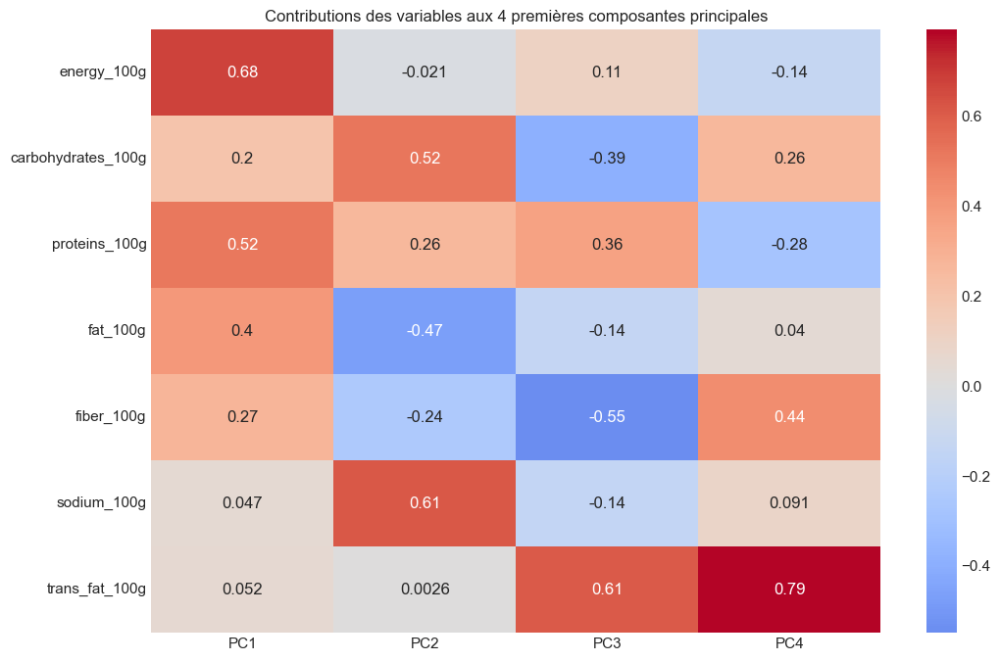

In [236]:
# Heatmap des contributions
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

loadings = pd.DataFrame(
    pca.components_.T,
    columns=[f'PC{i+1}' for i in range(len(variables))],
    index=variables
)

plt.figure(figsize=(12, 8))
sns.heatmap(loadings.iloc[:, :4], annot=True, cmap='coolwarm', center=0)
plt.title('Contributions des variables aux 4 premières composantes principales')
plt.show()
plt.close()

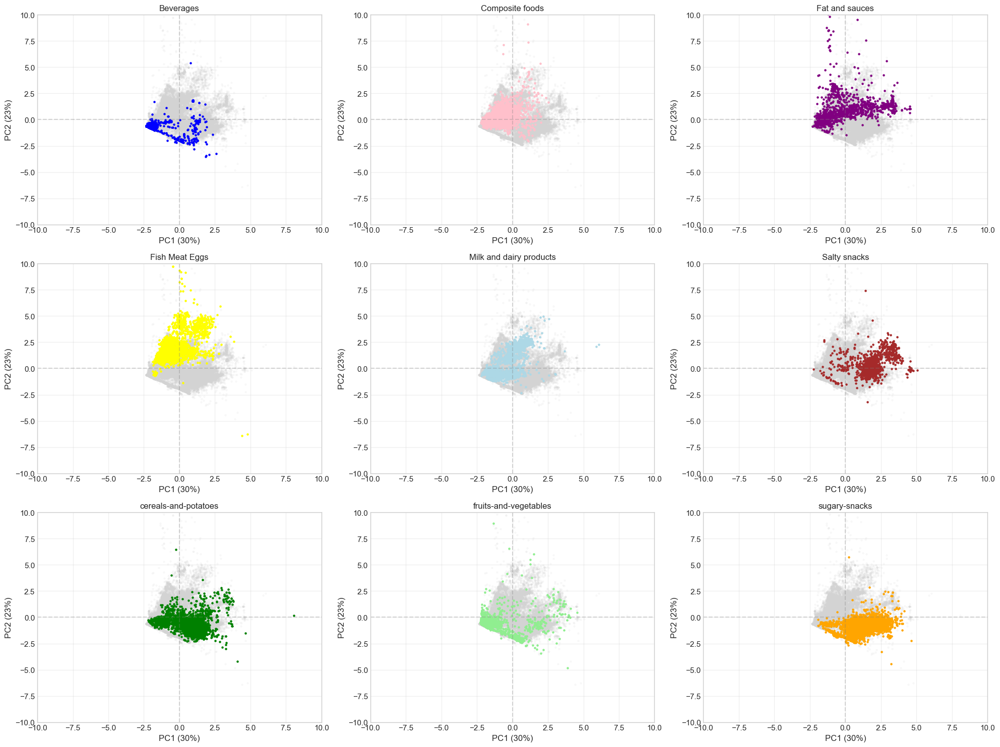

In [237]:
#graphiques de projection pour chaque groupe PNNS séparément
def display_factorial_planes_multiple(X_projected, 
                                    x_y, 
                                    pca=None, 
                                    groups=None, 
                                    alpha=1,
                                    marker=".",
                                    group_labels=None):
    """
    Affiche les 
    """
    X_ = np.array(X_projected)
    x, y = x_y
    
    # Nombre de groupes et calcul du nombre de sous-graphiques
    unique_groups = np.unique(groups)
    n_groups = len(unique_groups)
    n_cols = 3
    n_rows = (n_groups) // n_cols + (1 if n_groups % n_cols > 0 else 0)
    
    # Création de la figure avec sous-graphiques
    fig = plt.figure(figsize=(20, 5*n_rows))
    
    # Création d'une palette de couleurs distinctes pour chaque groupe
    colors = {
        'Beverages': 'blue',
        'sugary-snacks': 'orange',
        'cereals-and-potatoes': 'green',
        'Composite foods': 'pink',
        'Salty snacks': 'brown',
        'Fat and sauces': 'purple',
        'fruits-and-vegetables': 'lightgreen',
        'Fish Meat Eggs': 'yellow',
        'Milk and dairy products': 'lightblue'
    }
    
    # Graphiques individuels pour chaque groupe
    for i, group in enumerate(unique_groups, start=1):
        ax = plt.subplot(n_rows, n_cols, i)
        
        # Fond gris pour tous les points
        ax.scatter(X_[:, x], X_[:, y], 
                  color='lightgrey', 
                  alpha=0.1, 
                  marker=marker,
                  s=20)
        
        # Points du groupe en couleur
        mask = groups == group
        ax.scatter(X_[mask, x], 
                  X_[mask, y],
                  alpha=1,
                  c=colors.get(group, 'black'),  # Utilise la couleur définie ou noir par défaut
                  marker=marker,
                  s=20)
        
        ax.set_title(f"{group}")
        ax.grid(True, alpha=0.3)
        
        # Ajout des axes avec le % de variance expliquée
        if pca:
            v1 = f"{round(100*pca.explained_variance_ratio_[x])}%"
            v2 = f"{round(100*pca.explained_variance_ratio_[y])}%"
            ax.set_xlabel(f'PC{x+1} ({v1})')
            ax.set_ylabel(f'PC{y+1} ({v2})')
        
        # Ajout des lignes de référence
        ax.axhline(y=0, color='grey', linestyle='--', alpha=0.3)
        ax.axvline(x=0, color='grey', linestyle='--', alpha=0.3)
        
        # Définir les limites des axes
        ax.set_xlim(-10, 10)
        ax.set_ylim(-10, 10)

    plt.tight_layout()
    plt.show()

# Utilisation de la fonction
X_proj = pca.transform(X_scaled)
x_y = [0, 1]

# Appel de la fonction avec les groupes PNNS
display_factorial_planes_multiple(X_proj, 
                                x_y, 
                                pca=pca,
                                groups=openfoodfactLight['pnns_groups_1'])

### Distribution 3D des groupes PNNS selon les nutriments principaux (Graphique 3D)

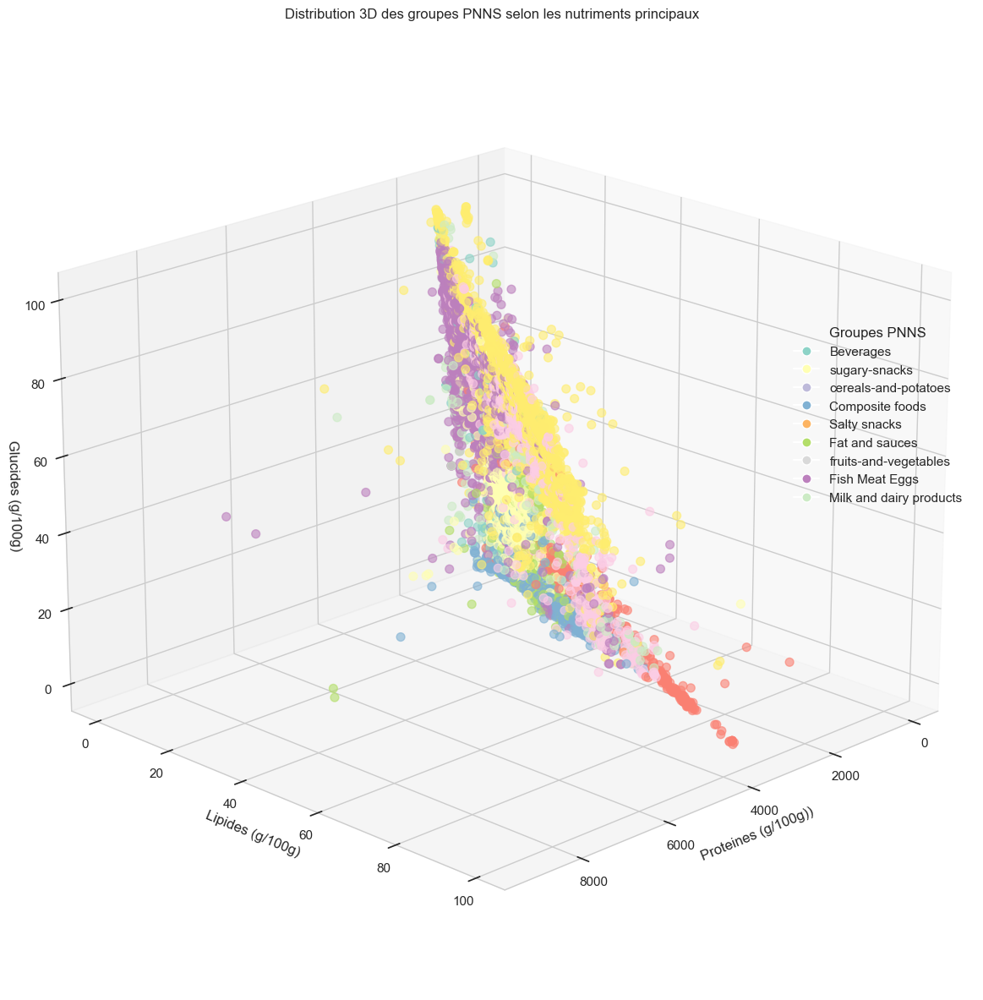

In [239]:
def create_3d_variable_plot(df):
    # Créer la figure 3D
    fig = plt.figure(figsize=(12, 12))
    ax = fig.add_subplot(111, projection='3d')

    # Crée le scatter plot 3D
    scatter = ax.scatter(df['energy_100g'], 
                        df['fat_100g'], 
                        df['carbohydrates_100g'],
                        c=df['pnns_groups_1'].astype('category').cat.codes,
                        cmap='Set3',
                        alpha=0.6,
                        s=50)  # taille des points

    # Étiquettes des axes
    ax.set_xlabel('Proteines (g/100g))')
    ax.set_ylabel('Lipides (g/100g)')
    ax.set_zlabel('Glucides (g/100g)')
    
    # Titre
    plt.title('Distribution 3D des groupes PNNS selon les nutriments principaux')
    
    # Légende
    unique_groups = df['pnns_groups_1'].unique()
    legend_elements = [plt.Line2D([0], [0], marker='o', color='w',
                                 markerfacecolor=plt.cm.Set3(i/len(unique_groups)), 
                                 label=group, markersize=8)
                      for i, group in enumerate(unique_groups)]
    ax.legend(handles=legend_elements, 
             title='Groupes PNNS',
          bbox_to_anchor=(0.8, 0.7))


    # Ajuste la vue
    ax.view_init(elev=20, azim=45)
    
    plt.tight_layout()
    plt.show()
    plt.close()
# Utilisation
create_3d_variable_plot(openfoodfactLight)

Distribution par groupe PNNS :
- Beverages : Concentré vers l'origine, faible teneur en tous nutriments
- Sugary-snacks : Fort axe glucides, faibles protéines
- Cereals and potatoes : Dominance glucides, protéines modérées
- Fish Meat Eggs : Fort axe protéines, lipides modérés
- Fat and sauces : Dominance lipides
- Fruits-and-vegetables : Valeurs modérées sur tous les axes


Patterns notables :
- Séparation claire des groupes selon leurs compositions
- Peu de chevauchement entre certains groupes (ex: Fish Meat Eggs vs Sugary-snacks)
- Gradient continu pour d'autres groupes
- Densité variable selon les zones

Implications :
- La classification PNNS reflète bien les profils nutritionnels distincts
- Certains groupes ont des compositions très caractéristiques

###    Comparaison des nutriments par paires de deux groupes PNNS

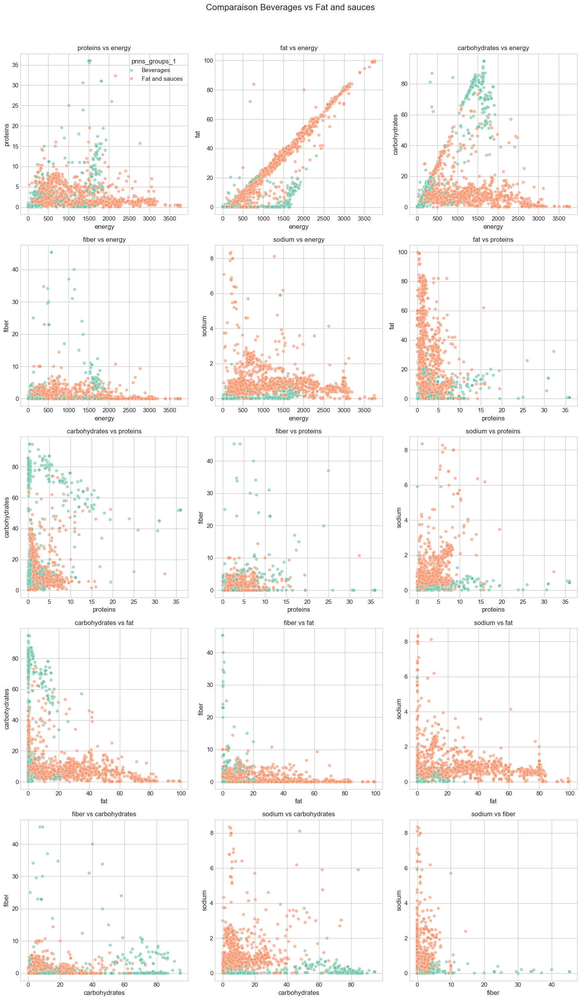

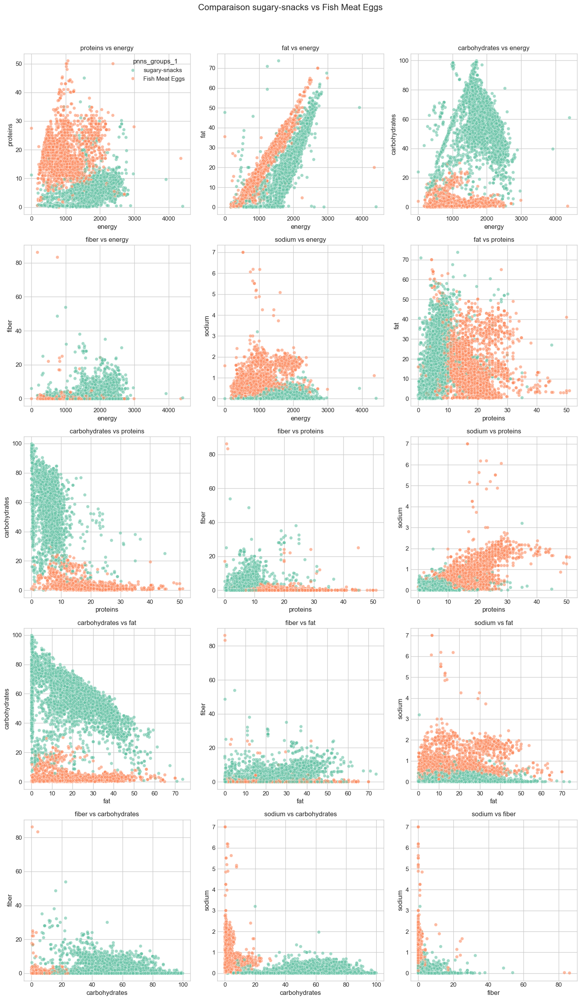

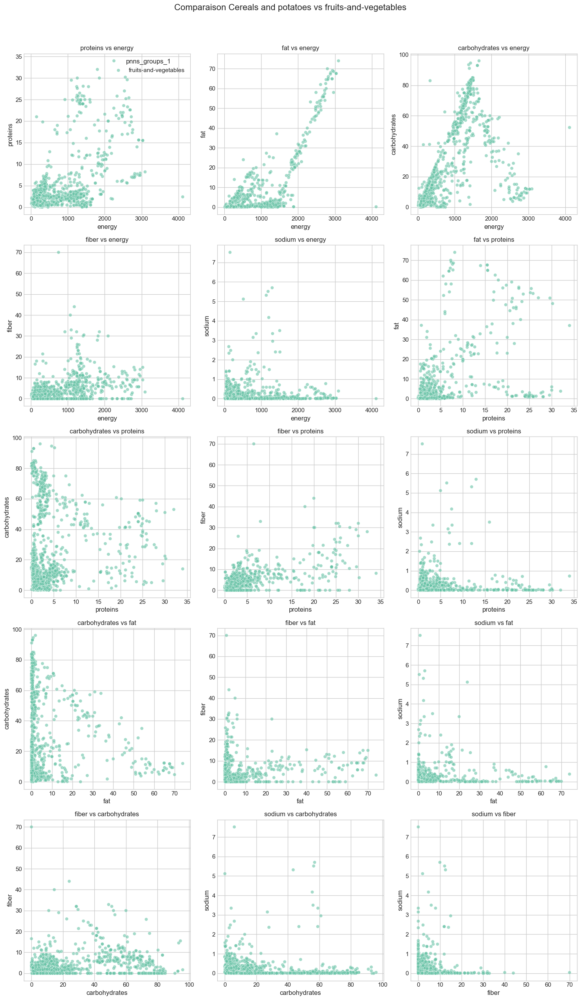

In [242]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_pnns_comparison(df, group1, group2, nutrients, palette='husl'):
   """
   Compare deux groupes PNNS avec des nuages de points colorés.
   """
   # Filtrer les données pour les deux groupes
   mask = df['pnns_groups_1'].isin([group1, group2])
   data = df[mask].copy()
   
   # Créer les paires de nutriments
   pairs = [(n1, n2) for i, n1 in enumerate(nutrients) for n2 in nutrients[i+1:]]
   
   # Calculer le nombre de lignes et colonnes nécessaires
   n_plots = len(pairs)
   n_cols = 3
   n_rows = (n_plots + n_cols - 1) // n_cols
   
   # Créer la figure
   fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5*n_rows))
   axes = axes.ravel()
   
   # Créer les scatter plots
   for idx, (nutrient1, nutrient2) in enumerate(pairs):
       sns.scatterplot(
           data=data,
           x=nutrient1,
           y=nutrient2,
           hue='pnns_groups_1',
           palette=palette,
           alpha=0.6,
           ax=axes[idx]
       )
       
       # Configurer le graphique
       axes[idx].set_title(f'{nutrient2.split("_")[0]} vs {nutrient1.split("_")[0]}')
       axes[idx].set_xlabel(nutrient1.split("_")[0])
       axes[idx].set_ylabel(nutrient2.split("_")[0])
       
       # Garder la légende uniquement pour le premier plot
       if idx != 0:
           axes[idx].get_legend().remove()
   
   # Supprimer les subplots vides
   for idx in range(n_plots, len(axes)):
       fig.delaxes(axes[idx])
   
   plt.suptitle(f'Comparaison {group1} vs {group2}', y=1.02, fontsize=16)
   plt.tight_layout()
   return fig

# Nutriments à comparer
nutrients = [
   'energy_100g',
   'proteins_100g', 
   'fat_100g',
   'carbohydrates_100g',
   'fiber_100g',
   'sodium_100g'
]

# Paires de groupes PNNS à comparer
pairs = [
   ('Beverages', 'Fat and sauces'),
   ('sugary-snacks', 'Fish Meat Eggs'),
   ('Cereals and potatoes', 'fruits-and-vegetables')
]

# Créer les visualisations
for group1, group2 in pairs:
   fig = plot_pnns_comparison(
       openfoodfactLight,
       group1,
       group2,
       nutrients,
       palette='Set2'
   )
   plt.show()
   plt.close()

### ANOVA

Résultats des ANOVA :

energy_100g:
F-statistic: 4452.16
p-value: 0.0000

carbohydrates_100g:
F-statistic: 8743.81
p-value: 0.0000

proteins_100g:
F-statistic: 3148.87
p-value: 0.0000

fat_100g:
F-statistic: 1880.27
p-value: 0.0000

fiber_100g:
F-statistic: 1009.18
p-value: 0.0000

sodium_100g:
F-statistic: 1523.76
p-value: 0.0000

trans_fat_100g:
F-statistic: 12.68
p-value: 0.0000


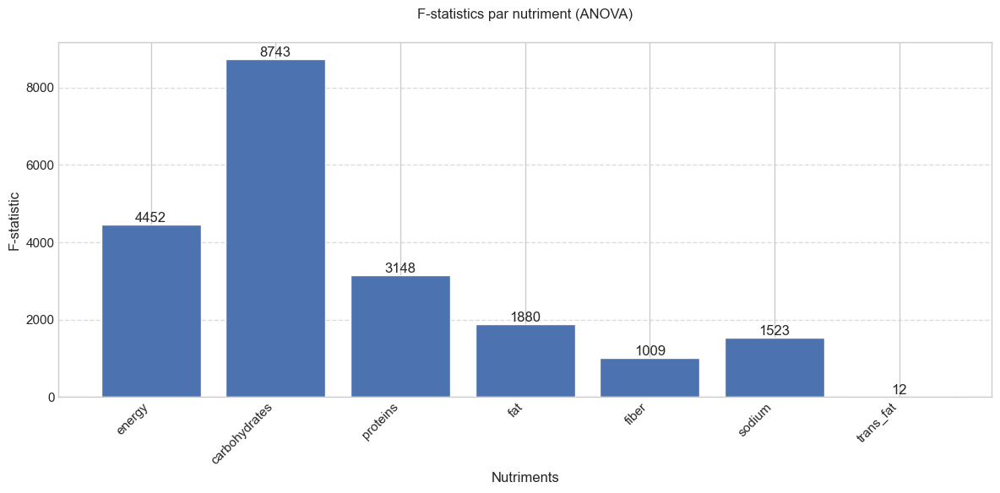

In [244]:
# ANOVA pour chaque nutriment
from scipy import stats
import matplotlib.pyplot as plt

# Liste des nutriments à tester
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 
           'fat_100g', 'fiber_100g', 'sodium_100g', 'trans_fat_100g']

# Dictionnaire pour stocker les F-statistics
f_stats = {}

# Réalisation des ANOVA
print("Résultats des ANOVA :")
for variable in variables:
   # Créer des groupes basés sur le groupe pnns
   groups = [group[variable].values for name, group in openfoodfactLight.groupby('pnns_groups_1')]
   
   # Réaliser l'ANOVA
   f_stat, p_val = stats.f_oneway(*groups)
   f_stats[variable] = f_stat
   
   print(f"\n{variable}:")
   print(f"F-statistic: {f_stat:.2f}")
   print(f"p-value: {p_val:.4f}")

# Création du graphique en barres
plt.figure(figsize=(12, 6))

# Créer le bar plot
bars = plt.bar(range(len(f_stats)), f_stats.values())

# Personnaliser le graphique
plt.title('F-statistics par nutriment (ANOVA)', pad=20)
plt.ylabel('F-statistic')
plt.xlabel('Nutriments')

# Configurer les labels de l'axe x
plt.xticks(range(len(f_stats)), 
          [var.replace('_100g', '') for var in f_stats.keys()],
          rotation=45,
          ha='right')

# Ajouter les valeurs sur les barres
for bar in bars:
   height = bar.get_height()
   plt.text(bar.get_x() + bar.get_width()/2., 
            height,
            f'{int(height)}',
            ha='center', 
            va='bottom')

# Ajouter une grille
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Ajuster la mise en page
plt.tight_layout()

plt.show()
plt.close()

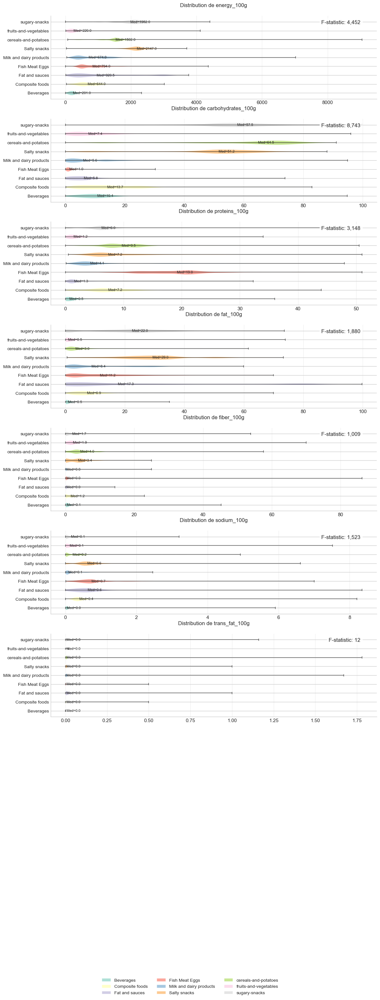

In [246]:
def create_nutrient_violin_plots(df, variables, f_stats):
    """
    Crée des violin plots pour visualiser la distribution des nutriments par groupe PNNS.
    Inclut une gestion spéciale pour les groupes avec peu de données.
    """
    fig, axes = plt.subplots(len(variables), 1, figsize=(12, len(variables) * 4))
    
    if len(variables) == 1:
        axes = [axes]
    
    # Obtenir les groupes PNNS uniques et créer une palette de couleurs
    pnns_groups = sorted(df['pnns_groups_1'].unique())  # Tri alphabétique
    colors = sns.color_palette('Set3', n_colors=len(pnns_groups))
    
    for idx, variable in enumerate(variables):
        try:
            # Créer une liste pour stocker les données de chaque groupe
            plot_data = []
            valid_groups = []
            
            for group in pnns_groups:
                group_data = df[df['pnns_groups_1'] == group][variable].dropna()
                
                # Vérifier si le groupe a suffisamment de données (au moins 5 points)
                if len(group_data) >= 5:
                    plot_data.append(group_data.values)
                    valid_groups.append(group)
                else:
                    print(f"Attention: Groupe {group} exclus pour {variable} (nombre insuffisant de données: {len(group_data)})")
            
            # Créer le violin plot seulement pour les groupes valides
            if plot_data:
                violins = axes[idx].violinplot(plot_data, vert=False)
                
                # Personnaliser l'apparence
                for violin, color in zip(violins['bodies'], colors[:len(valid_groups)]):
                    violin.set_facecolor(color)
                    violin.set_alpha(0.7)
                
                # Configurer les lignes médianes et quartiles
                for partname in ['cbars', 'cmins', 'cmaxes', 'cmeans']:
                    if partname in violins:
                        violins[partname].set_color('black')
                        violins[partname].set_alpha(0.5)
            
            # Ajouter la F-statistic
            if variable in f_stats:
                axes[idx].text(0.95, 0.95, 
                             f'F-statistic: {int(f_stats[variable]):,}',
                             transform=axes[idx].transAxes,
                             ha='right',
                             va='top',
                             bbox=dict(facecolor='white', alpha=0.8))
            
            # Configuration des axes
            axes[idx].set_yticks(range(1, len(valid_groups) + 1))
            axes[idx].set_yticklabels(valid_groups, fontsize=10)
            
            # Ajout d'une grille et personnalisation
            axes[idx].grid(True, axis='x', alpha=0.3)
            axes[idx].spines[['right', 'top']].set_visible(False)
            axes[idx].set_title(f'Distribution de {variable}', pad=20)
            
            # Ajout des statistiques de base pour chaque groupe
            for i, group in enumerate(valid_groups, 1):
                group_data = df[df['pnns_groups_1'] == group][variable]
                median = group_data.median()
                axes[idx].text(median, i, f' Med={median:.1f}', 
                             va='center', ha='left', fontsize=8)
            
        except Exception as e:
            print(f"Erreur lors du traitement de {variable}: {str(e)}")
            continue
    
    # Légende
    legend_handles = [plt.Rectangle((0,0), 1, 1, facecolor=color, alpha=0.7) 
                     for color in colors[:len(valid_groups)]]
    fig.legend(legend_handles, valid_groups,
              loc='center',
              bbox_to_anchor=(0.5, -0.1),
              ncol=min(3, len(valid_groups)),
              fontsize=10)
    
    plt.tight_layout()
    plt.subplots_adjust(bottom=0.2)
    
    # Sauvegarder
    date = datetime.datetime.now().strftime("%Y%m%d_%H%M")
    plt.savefig(f'nutrient_distribution_{date}.png', 
                bbox_inches='tight', 
                dpi=300)
    
    plt.show()
    plt.close()

# Utilisation
variables = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'fat_100g','fiber_100g','sodium_100g','trans_fat_100g']

create_nutrient_violin_plots(openfoodfactLight, variables, f_stats)

# RGPD

Pourquoi le projet n'est pas concerné par le RGPD
- Absence de données personnelles :
Ce travail se concentre sur des données relatives aux caractéristiques nutritionnelles des produits alimentaires. Ces informations ne permettent pas d'identifier directement ou indirectement une personne physique, ce qui exclut leur qualification de "données personnelles" selon le RGPD.
- Aucune collecte ou traitement de données sensibles :
Les données sensibles sont par exemple les informations médicales, ethniques ou religieuses.Celles-ci nécessitent une protection renforcée sous le RGPD.
- Finalité technique et non personnelle :
Le nettoyage des données vise uniquement à améliorer la qualité des analyses statistiques sur les produits alimentaires. Il n'y a aucune interaction avec des individus ni collecte de consentement nécessaire.

Conformité aux principes généraux :
Bien que le RGPD ne s'applique pas directement, certains principes clés s'appliquent comme la minimisation (en nettoyant les valeurs aberrantes par exemple) et la transparence (en documentant le process).

Les 5 grands principes du RGPD
- Licéité, loyauté et transparence :
Les données personnelles doivent être collectées de manière légale, loyale et transparente. Cela implique d’informer les personnes concernées sur la finalité de la collecte et de s'assurer que leur consentement est obtenu lorsque nécessaire12.
- Limitation des finalités :
Les données doivent être collectées pour des objectifs spécifiques, explicites et légitimes. Elles ne doivent pas être utilisées ultérieurement à d'autres fins incompatibles avec celles initialement prévues.
- Minimisation des données :
Seules les données strictement nécessaires à la réalisation de l’objectif doivent être collectées. Cela évite toute collecte excessive ou superflue.
- Exactitude et mise à jour :
Les données personnelles doivent être exactes et, si nécessaire, mises à jour régulièrement pour refléter la réalité. Toute donnée inexacte doit être corrigée ou supprimée.
- Sécurité et confidentialité :
Les données personnelles doivent être protégées contre tout accès non autorisé, perte ou destruction accidentelle grâce à des mesures techniques et organisationnelles appropriées (chiffrement, contrôle d'accès, etc.).